In [1]:
%matplotlib inline
from skimage import io, filters
import tensorflow as tf
import tensorflow.contrib.slim as slim
from tensorflow.examples.tutorials.mnist import input_data
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import os,sys
from lgan.diffeomorphism import tf_diffeomorphism
from tqdm import tqdm
from scipy import misc
from keras.preprocessing import image
from scipy import ndimage, misc
from tflearn.data_augmentation import ImageAugmentation
import copy

Using TensorFlow backend.


In [2]:
#PREROCESS IMAGES - only do once
def resizeFaces():
    path = '/home/dorian/MyGans/LabelGAN/faces_only'
    dirs = os.listdir( path )    
    for item in dirs:
        if os.path.isfile(os.path.join(path,item)):
            inread = ndimage.imread(os.path.join(path,item), mode="RGB")
            image_cut = inread[0:900,200:1100,:] #cut image:1333x1013->900x900
            image_resized = misc.imresize(image_cut, (64, 64))
            misc.imsave('/home/dorian/MyGans/LabelGAN/faces/0/'+item, image_resized)
    
            
def cutImages():
    path = '/home/ben/celeba/data/0'
    dirs = os.listdir( path )    
    for item in dirs:
        if os.path.isfile(os.path.join(path,item)):
            inread = ndimage.imread(os.path.join(path,item), mode="RGB")
            image_cut = inread[40:198,10:168,:] #cut image:218x179->158x158
            image_resized = misc.imresize(image_cut, (64, 64))
            misc.imsave('/home/ben/celeba/cut/0/'+item, image_resized)
            

#resizeFaces()

print(len(os.listdir("/home/ben/celeba/cut/0")))
print(len(os.listdir('/home/dorian/MyGans/LabelGAN/faces/0/')))

202599
20566


In [3]:
#hyper-parameter
image_dir = '/home/ben/celeba/cut'
image_dir_imdb = '/home/dorian/MegaFace/resized'
imX= 64
imY= 64
ch = 3

im_path='out-celeba-faces/'

image_size = imX*imY
input_dim = 50 
output_dim = imX*imY*ch
batch_size = 32 #batch size

LAMBDA = 10

model_dir = 'models'
model_checkpoint = os.path.join(model_dir, "face_gen_2017-05-14T14:58:00")
os.path.abspath(model_checkpoint)

#Session
config = tf.ConfigProto()
config.gpu_options.allow_growth=True
sess = tf.Session(config=config)

#if false, only restore Critic and Generator
restore_all = False

if not os.path.exists(im_path):
    os.makedirs(im_path)


In [4]:
#simple plot function
def plot(samples, labels,y,x,fig=10):
    fig = plt.figure(figsize=(fig, fig))
    gs = gridspec.GridSpec(y, x)
    gs.update(wspace=0.05, hspace=0.05)
    plt.subplots_adjust(left=None, bottom=None, right=1, top=1.5,
                wspace=None, hspace=None)

    for i, sample in enumerate(samples):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.title(labels)
        plt.imshow(sample)   
    return fig


#images plotted while learning
def preprocessPlotImages(gen_image,face_image):
    gen_image_len = len(gen_image)
    images = np.zeros((gen_image_len,imY,imX,ch))
    for i in range(gen_image_len):
        befor = copy.copy(gen_image[i])
        after = copy.copy(face_image[i])
        befor_reshape = misc.imresize(befor, (20,20))/255
        after[44:64,44:64]=befor_reshape
        images[i]=after
    return images
        
        
        
    

In [5]:
datagen = image.ImageDataGenerator(rescale=1./255)

batcher_celeb = datagen.flow_from_directory(
    directory=image_dir,
    target_size= (imY, imX),
    color_mode= 'rgb',
    class_mode= None,
    batch_size= batch_size)

batcher_imdb = datagen.flow_from_directory(
    directory=image_dir_imdb,
    target_size= (64, 64),
    color_mode= 'rgb',
    class_mode= None,
    batch_size= batch_size)


Found 202599 images belonging to 1 classes.
Found 456455 images belonging to 1 classes.


In [6]:
print(np.random.rand(1))

[ 0.54410818]


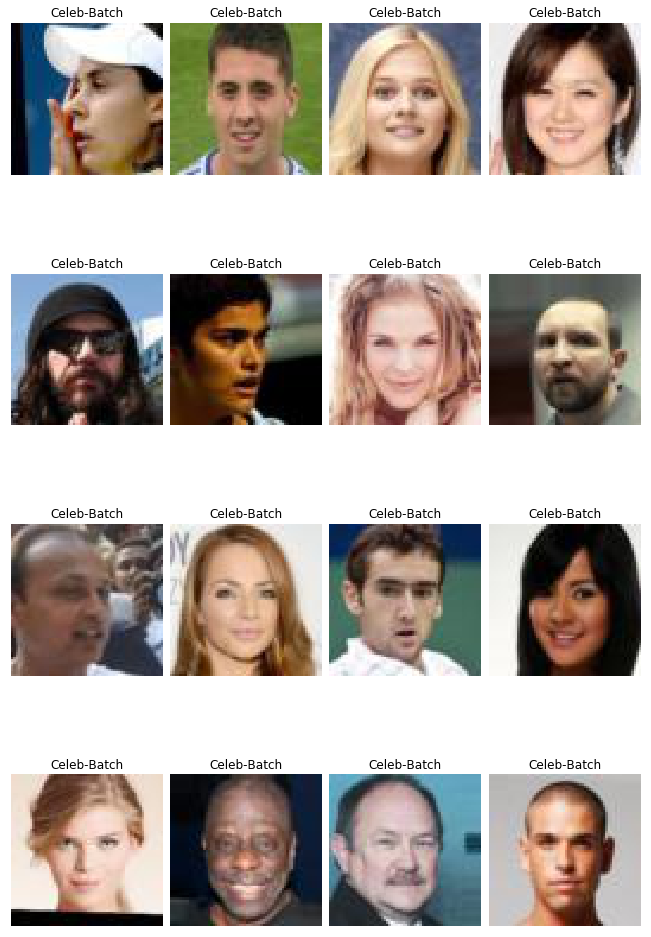

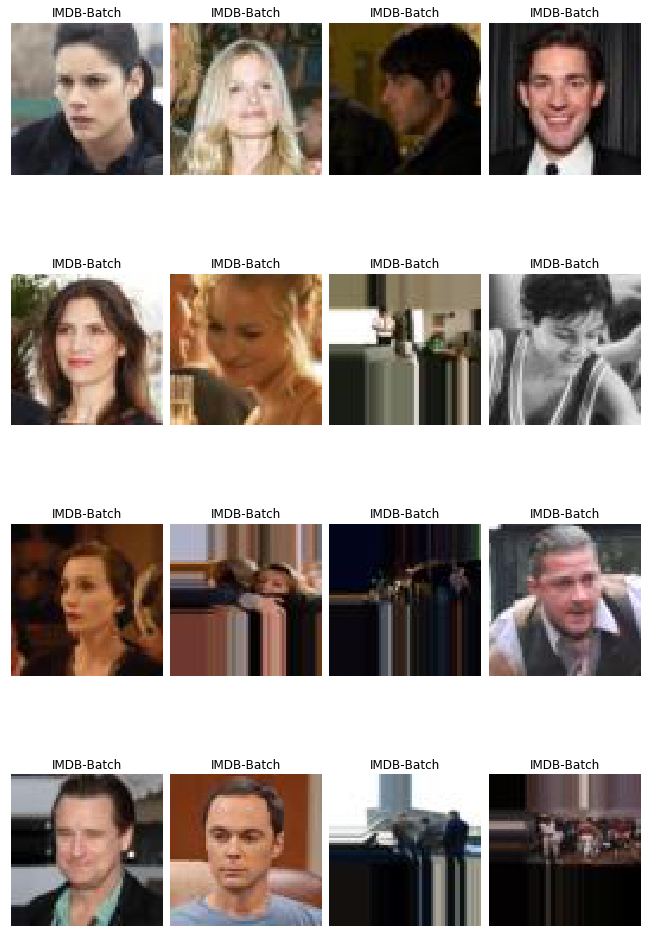

In [7]:
def getImageBatch(r = np.random.rand(1)):
    if r<=0.5:
        img_batch = batcher_celeb.next()
        if len(img_batch) != batch_size:
            img_batch = batcher_celeb.next()
    else:
        img_batch = batcher_imdb.next()
        if len(img_batch) != batch_size:
            img_batch = batcher_imdb.next()
    assert len(img_batch) == batch_size
    return img_batch

celeb = getImageBatch(r=0.4)
plot(celeb[0:16], "Celeb-Batch",4,4)
plt.show()
celeb = getImageBatch(r=0.6)
plot(celeb[0:16], "IMDB-Batch",4,4)
plt.show()

In [8]:
def sample_z(bsize):
    batch = np.zeros((bsize,input_dim))
    for i in range(bsize):
        vector = np.random.uniform(-1, 1., size=[input_dim]) #create noise vector of input_dim
        batch[i] = vector
    return batch


In [9]:
def leakyReLU(x, alpha=0.2):
    return tf.maximum(alpha*x, x)

def resnet_block(inputs, maps=64, kernel=[3, 3],stride=1):
    layer = slim.conv2d(inputs, maps, kernel, stride,weights_initializer=tf.truncated_normal_initializer(stddev=1e-1),
                  padding = 'SAME',activation_fn=None)
    layer = slim.batch_norm(layer)
    layer = tf.nn.relu(layer)
    layer = slim.conv2d(layer, maps, kernel, stride,weights_initializer=tf.truncated_normal_initializer(stddev=1e-1),
                  padding = 'SAME',activation_fn=None)
    layer = slim.batch_norm(layer)
    outputs = tf.add(inputs, layer)
    return outputs

In [10]:
def discriminator(x, n=64):
    with tf.variable_scope('discriminator'):
        x = tf.reshape(x,[-1,imY,imX,ch])
        x = slim.conv2d(x, n/2, [4, 4],2, weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None)
        x = leakyReLU(x)
        net = slim.conv2d(x, n, [3, 3],2, weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None)
        net = leakyReLU(net)
        net = slim.conv2d(net, n*4, [3, 3],2,weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None)
        net = leakyReLU(net)
        net = slim.conv2d(net, n*8, [3, 3],2,weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None)
        net = leakyReLU(net)
        net = slim.conv2d(net, n*16, [3,3],2,weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None) 
        net = leakyReLU(net)
        net = slim.conv2d(net, n*8, [3,3],1,weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None) 
        net = leakyReLU(net)
        net = slim.conv2d(net, 1, [2,2],2,weights_initializer=tf.truncated_normal_initializer(stddev=0.1),
                         padding = 'SAME',activation_fn=None)   
        return [net,tf.nn.relu(x)]

In [11]:

def predictStartImage(blurImage):
    with tf.variable_scope('predictor'):
        genImage = slim.conv2d(blurImage,16, [3,3],2,activation_fn=None)
        genImage = slim.batch_norm(genImage)
        genImage = tf.nn.relu(genImage)
        genImage = tf.reshape(genImage,[-1,4096])
        genImage = slim.fully_connected(genImage,400,activation_fn=None)
        return tf.multiply(2.0,tf.nn.tanh(genImage))


In [12]:
def face_gen_params(noise):
    with tf.variable_scope("params"):
        params = slim.fully_connected(noise, 200)
        params = slim.fully_connected(params,400,activation_fn=None)
        params = tf.nn.tanh(params)
        return tf.multiply(2.0,params)
    
def face_gen(inputs, training=True, reuse=None, n = 64):
    with tf.variable_scope("face_gen", reuse=reuse):
        x = tf.layers.dense(inputs, 8*n*4*4)
        x = tf.reshape(x, [-1, 4, 4, 8*n])
        x = tf.nn.relu(tf.layers.batch_normalization(x, training=training))

        x = tf.layers.conv2d_transpose(x, 4*n, [5, 5], strides=(2, 2), padding='SAME')
        x = tf.nn.relu(tf.layers.batch_normalization(x, training=training))

        x = tf.layers.conv2d_transpose(x, 2*n, [5, 5], strides=(2, 2), padding='SAME')
        x = tf.nn.relu(tf.layers.batch_normalization(x, training=training))

        x = tf.layers.conv2d_transpose(x, n, [5, 5], strides=(2, 2), padding='SAME')
        x = tf.nn.relu(tf.layers.batch_normalization(x, training=training))

        x = tf.layers.conv2d_transpose(x, 3, [5, 5], strides=(2, 2), padding='SAME')                        
        face_pred = tf.sigmoid(x, name='face_pred')
        return face_pred

In [13]:
def simGenerator(image, noise, n=64):
    image = tf.reshape(image,[-1,imY,imX,ch])
    noise = slim.fully_connected(noise, image_size,weights_initializer=tf.truncated_normal_initializer(stddev=0.01))
    noise = tf.reshape(noise, [-1,imY,imX,1])
    net = tf.concat([image, noise],3)
    net = slim.conv2d(net, n, [3,3],1)
    net = resnet_block(net, maps=n, kernel=[3, 3],stride=1)
    net = resnet_block(net, maps=n, kernel=[3, 3],stride=1)
    net = resnet_block(net, maps=n, kernel=[3, 3],stride=1)
    net = resnet_block(net, maps=n, kernel=[3, 3],stride=1)
    net = resnet_block(net, maps=n, kernel=[3, 3],stride=1)
    net = slim.conv2d(net, n/2, [3,3],1)
    net = slim.conv2d(net, 3, [1,1],1)
    return tf.nn.tanh(net)

#Main Generator
def generator(gen_faces, z):
    with tf.variable_scope('generator'):
        detailed_image = simGenerator(gen_faces,z)
        return detailed_image



In [14]:
#input
X = tf.placeholder(tf.float32, shape=[None,imY,imX,ch])
Z_params = tf.placeholder(tf.float32, shape=[None, input_dim])
Z_image = tf.placeholder(tf.float32, shape=[None, input_dim])
Params = tf.placeholder(tf.float32, shape=[None, 400])
Gen_Faces = tf.placeholder(tf.float32,shape=[None,imY,imX,ch])


#Models
params = face_gen_params(Z_params)
gen_faces = face_gen(params)

face_images = generator(gen_faces, Z_image) 
D_real = discriminator(X)
D_fake = discriminator(face_images)
predictParams = predictStartImage(D_fake[1])

gen_faces_with_params = face_gen(Params, reuse=True)
generate_faces_generator = generator(Gen_Faces,Z_image)

    
#variables V1
theta_D = sess.graph.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'discriminator') 
theta_G = sess.graph.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'generator')
theta_Pred = sess.graph.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'predictor')
theta_Face_Gen = sess.graph.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'face_gen')
theta_Face_Gen_Params = sess.graph.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES, 'params')
print(theta_Face_Gen[0])


D_losses, G_losses = [],[]

#meanSquaredErrorLoss for Predictor:
#P_loss = tf.reduce_sum(tf.squared_difference(predictParams, params))
#400 Parameter: 1-199:Shape,200:398:tex,399:theta,400:phi
#jede Parameterklasse 1/4:
shape = tf.reduce_sum(tf.squared_difference(predictParams[:,0:198],params[:,0:198]))/2
tex = tf.reduce_sum(tf.squared_difference(predictParams[:,199:397],params[:,199:397]))/2
theta = tf.reduce_sum(tf.squared_difference(predictParams[:,398],params[:,398]))*100
phi = tf.reduce_sum(tf.squared_difference(predictParams[:,399],params[:,399]))*100

P_loss = shape+tex+theta+phi

#Discriminator Wasserstein-Loss
D_loss = tf.reduce_mean(D_fake[0]) - tf.reduce_mean(D_real[0])

#Generator L1-Loss
G_l1_loss = tf.reduce_sum(tf.abs(face_images-gen_faces))

#Generator Loss
G_loss = -tf.reduce_mean(D_fake[0])+tf.multiply(0.1,P_loss)

#Gen-Params 
Gen_loss = -tf.reduce_mean(D_fake[0])


#improved WGAN without weight clipping. Instead penalizing gradient 
alpha = tf.random_uniform(shape=[batch_size,1], minval=0.,maxval=1.)

differences = tf.reshape(face_images - X, (-1, output_dim))
interpolates = tf.reshape(X,(-1, output_dim)) + (alpha*differences)
interpolates = tf.reshape(interpolates, (-1, 64,64,3))
gradients = tf.gradients(discriminator(interpolates), [interpolates])[0]
slopes = tf.sqrt(tf.reduce_sum(tf.square(gradients), reduction_indices=[1]))
gradient_penalty = tf.reduce_mean((slopes-1.)**2)
D_loss += LAMBDA*gradient_penalty

G_losses.append(G_loss)
D_losses.append(D_loss)

G_loss = tf.add_n(G_losses)
D_loss = tf.add_n(D_losses) 

#Solver
D_solver = (tf.train.AdamOptimizer(learning_rate=0.0001, beta1=0.5, beta2=0.9)
            .minimize(D_loss, var_list=theta_D, colocate_gradients_with_ops=True))
G_solver = (tf.train.AdamOptimizer(learning_rate=0.0001, beta1=0.5, beta2=0.9)
            .minimize(G_loss, var_list=theta_G, colocate_gradients_with_ops=True))
G_solver_L1 = (tf.train.AdamOptimizer(learning_rate=0.0001, beta1=0.5, beta2=0.9)
            .minimize(G_l1_loss, var_list=theta_G, colocate_gradients_with_ops=True))
P_solver = (tf.train.AdamOptimizer(learning_rate=0.0001, beta1=0.5, beta2=0.9)
            .minimize(P_loss, var_list=theta_Pred, colocate_gradients_with_ops=True))
Gen_Params_solver = (tf.train.AdamOptimizer(learning_rate=0.0001, beta1=0.5, beta2=0.9)
            .minimize(Gen_loss, var_list=theta_Face_Gen_Params, colocate_gradients_with_ops=True))


#initalize Variables 
#Add ops to save and restore all the variables.
saver = tf.train.Saver()

#gen-disc-saver
gen_saver = tf.train.Saver(theta_G)
disc_saver = tf.train.Saver(theta_D)

if os.path.isfile("checkpoints-celeba/all/model-celeba.index"):
    # Restore variables from disk.
    if restore_all:
        print("Restore All variables")
        saver.restore(sess, "checkpoints-celeba/all/model-celeba")
    else:
        print("Restore Generator and Critic variables")
        sess.run(tf.global_variables_initializer()) 
        gen_saver.restore(sess, "checkpoints-celeba/gen/model-celeba")
        disc_saver.restore(sess, "checkpoints-celeba/disc/model-celeba")
    
else:
    print("Instantiate variables")
    sess.run(tf.global_variables_initializer())  
    

#RESTORE AND INITALIZE VARIABLES    
#restore face_gen variables
face_saver = tf.train.Saver(theta_Face_Gen)
face_saver.restore(sess, model_checkpoint)
#reinitialize param-creator
sess.run(tf.variables_initializer(theta_Face_Gen_Params))

Tensor("face_gen/dense/kernel/read:0", shape=(400, 8192), dtype=float32)
Restore Generator and Critic variables


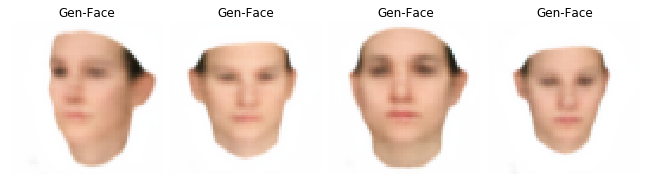

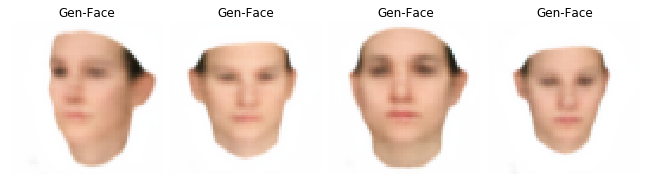

In [15]:
#test face_gen: 
z = sample_z(batch_size)
z_im = sample_z(batch_size)
samples = sess.run(gen_faces, feed_dict={Z_params:z,Z_image:z_im})  
plot(samples[0:4],"Gen-Face",1,4)


In [16]:
#pretrain gen with L1 Loss:
for t in tqdm(range(0)): 
    z = sample_z(batch_size)
    z_im = sample_z(batch_size)
    _, G_loss_curr = sess.run(
        [G_solver_L1, G_l1_loss],
        feed_dict={Z_params:z,Z_image:z_im}
    )


0it [00:00, ?it/s]


In [17]:
#pretrain disc:
for t in tqdm(range(0)):
    #train discriminator
    Xdata = getImageBatch()
    z = sample_z(batch_size)
    z_im = sample_z(batch_size)
    _, D_loss_curr = sess.run(
        [D_solver, D_loss],
        feed_dict={X: Xdata,Z_params:z,Z_image:z_im}
    ) 

0it [00:00, ?it/s]


In [ ]:

#pretrain predictor
for t in tqdm(range(200)):
    z = sample_z(batch_size)
    z_im = sample_z(batch_size)
    _, P_loss_curr = sess.run(
        [P_solver, P_loss],
        feed_dict={Z_params:z,Z_image:z_im}
    ) 


100%|██████████| 200/200 [00:17<00:00, 11.12it/s]


Iter: 0; D loss: 1.554e+04; G_loss: 5.985e+04; P_loss: 2.164e+03


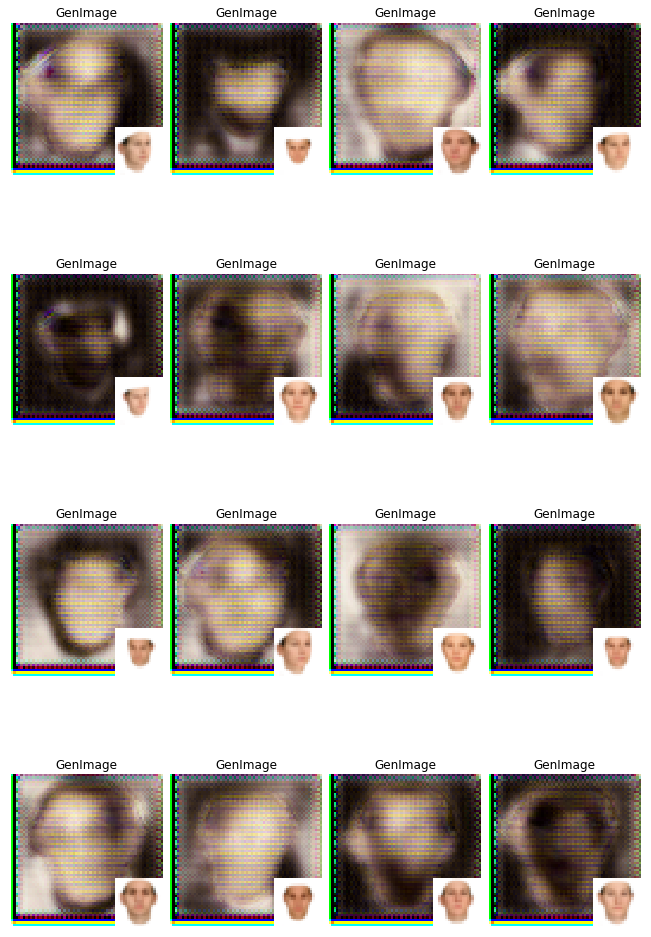

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 100; D loss: 2.433e+03; G_loss: 3.252e+03; P_loss: 1.621e+03


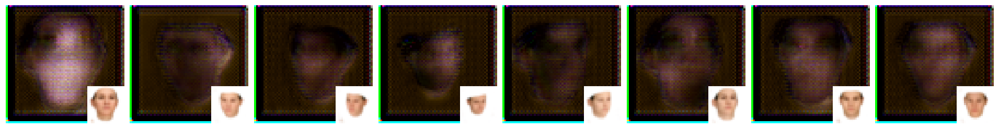

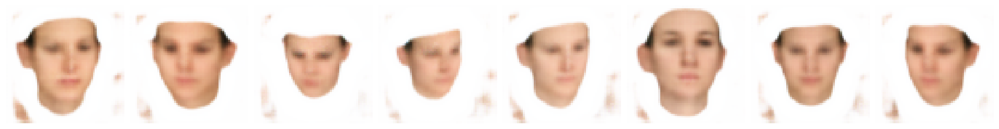

Iter: 200; D loss: 1.518e+03; G_loss: 1.178e+03; P_loss: 1.694e+03


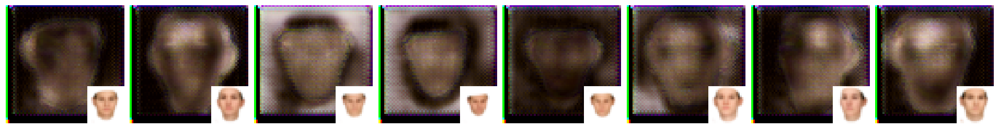

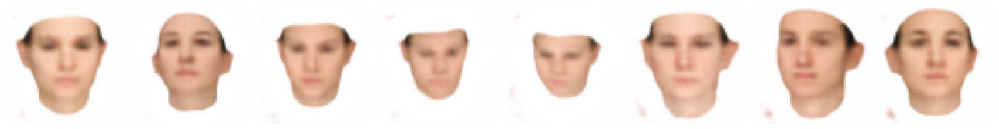

Iter: 300; D loss: -331.2; G_loss: 1.725e+03; P_loss: 1.599e+03


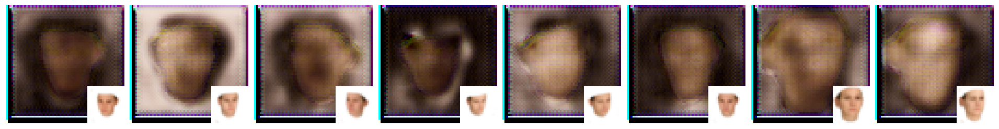

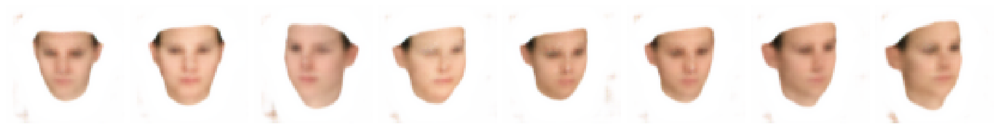

Iter: 400; D loss: -450.0; G_loss: 1.426e+03; P_loss: 1.547e+03


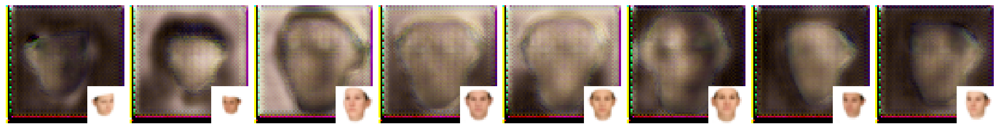

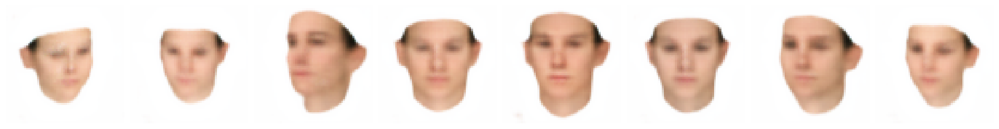

Iter: 500; D loss: -933.2; G_loss: -1.331e+03; P_loss: 1.354e+03


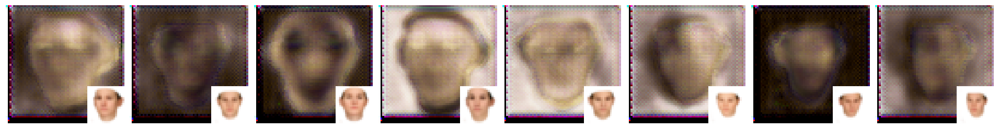

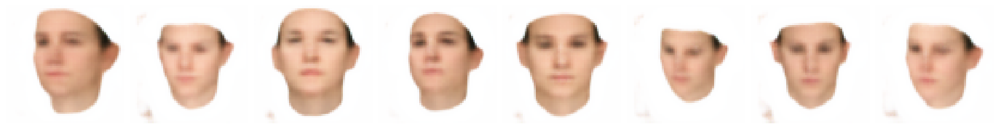

Iter: 600; D loss: -774.4; G_loss: 1.516e+03; P_loss: 1.251e+03


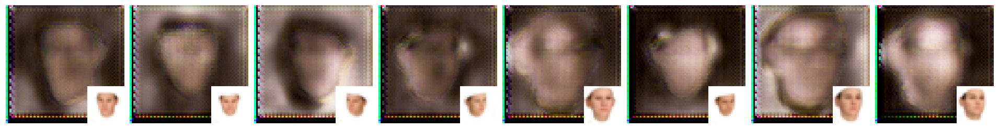

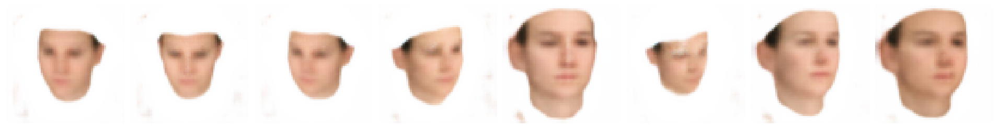

Iter: 700; D loss: -989.5; G_loss: 3.239e+03; P_loss: 1.064e+03


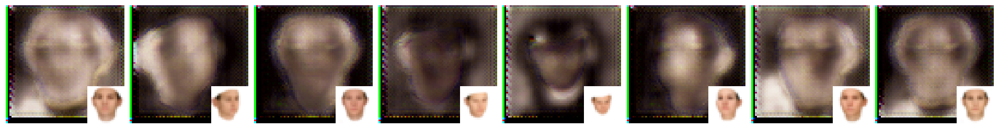

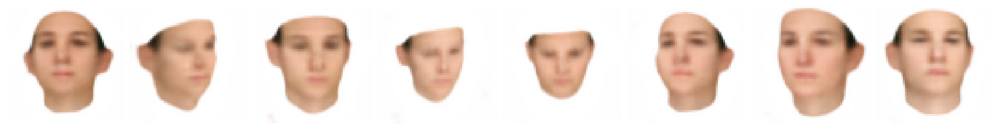

Iter: 800; D loss: -784.6; G_loss: 4.239e+03; P_loss: 1.117e+03


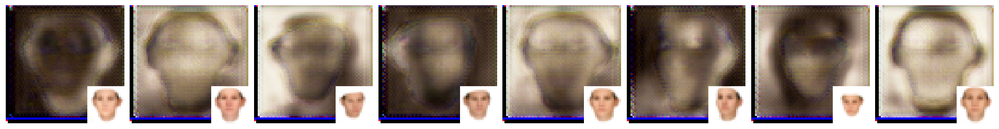

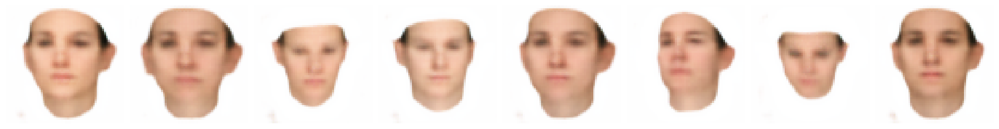

Iter: 900; D loss: -698.7; G_loss: -1.049e+03; P_loss: 1.128e+03


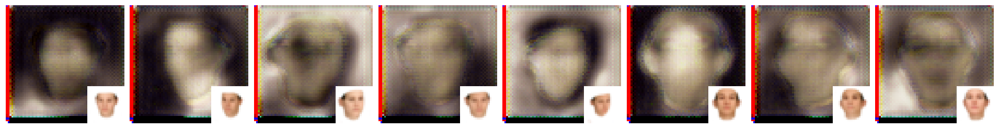

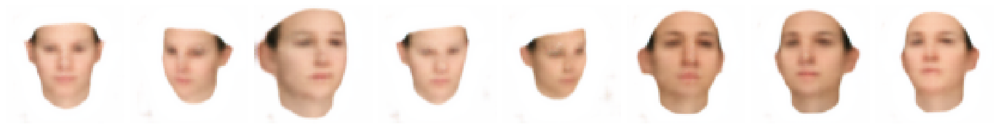

Iter: 1000; D loss: -761.5; G_loss: 1.123e+03; P_loss: 944.2


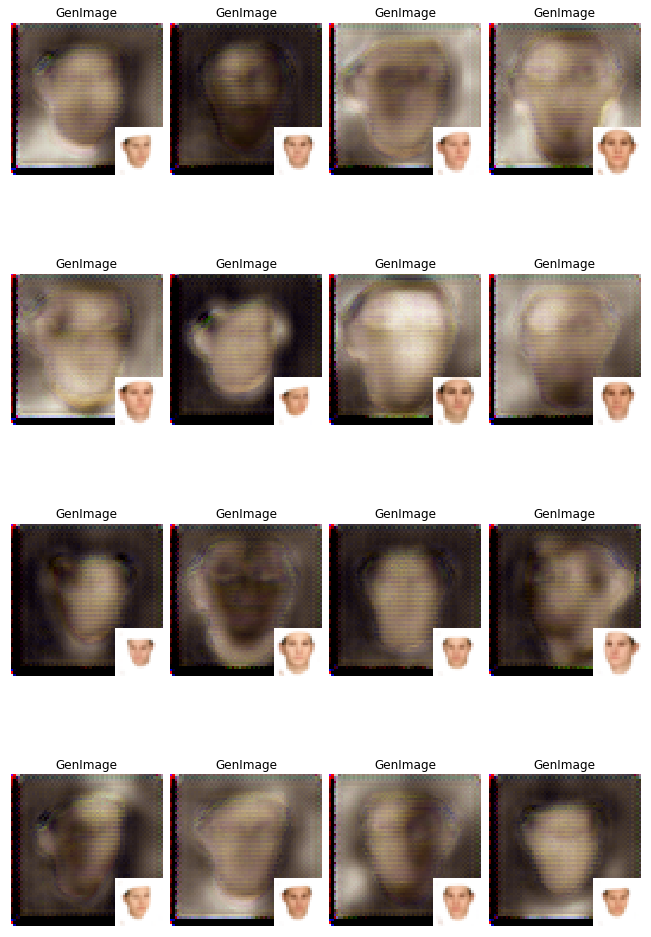

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 1100; D loss: -803.1; G_loss: 963.8; P_loss: 1.03e+03


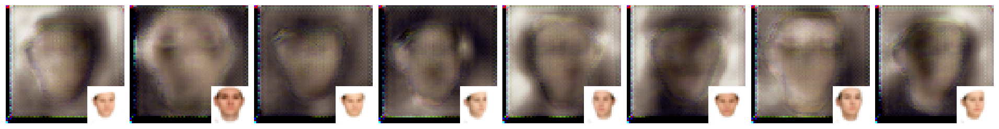

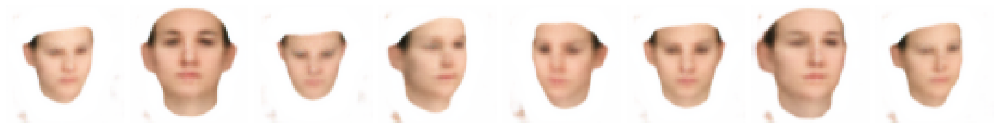

Iter: 1200; D loss: -445.7; G_loss: 589.2; P_loss: 1.225e+03


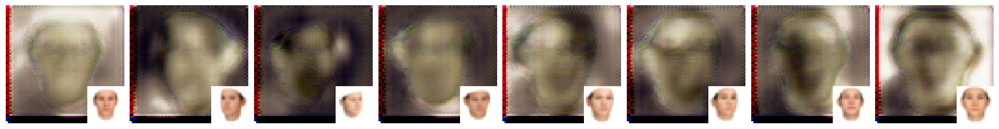

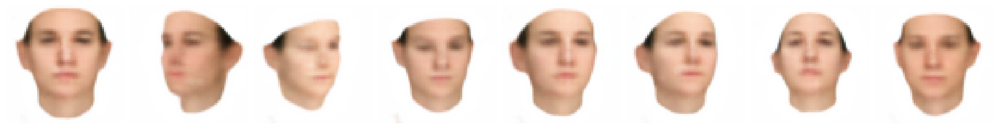

Iter: 1300; D loss: -397.7; G_loss: 630.3; P_loss: 1.279e+03


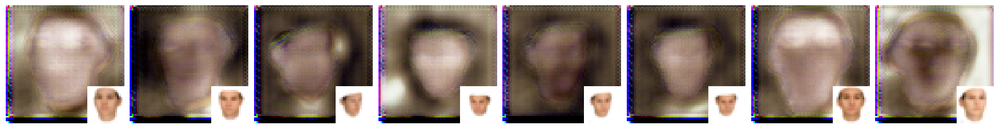

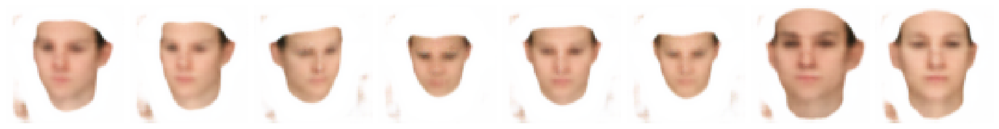

Iter: 1400; D loss: -709.3; G_loss: -528.4; P_loss: 1.046e+03


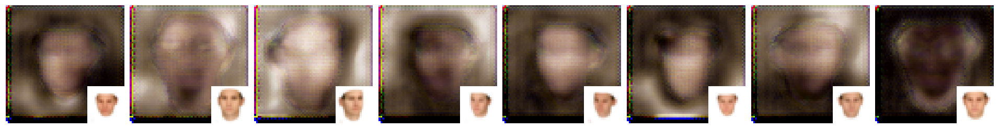

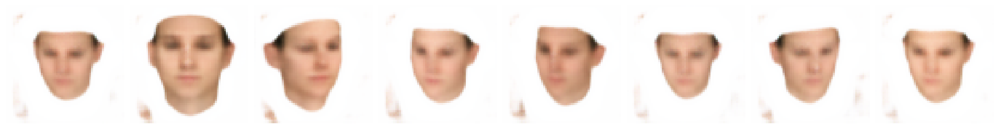

Iter: 1500; D loss: -360.8; G_loss: -1.066e+03; P_loss: 1.172e+03


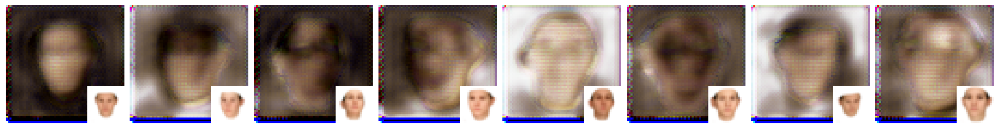

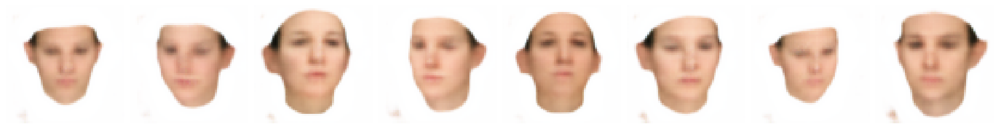

Iter: 1600; D loss: -417.8; G_loss: 712.4; P_loss: 1.068e+03


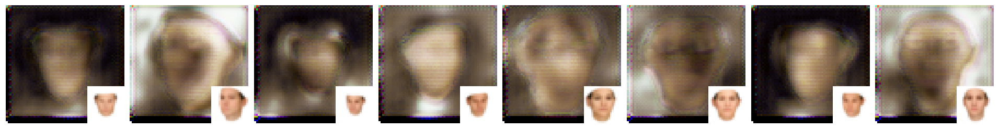

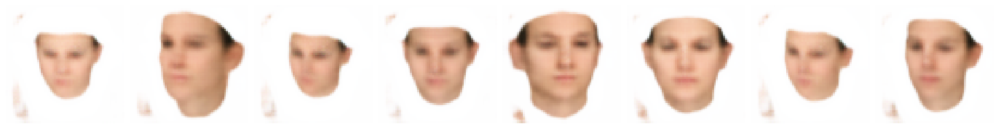

Iter: 1700; D loss: -814.4; G_loss: -2.116e+03; P_loss: 1.009e+03


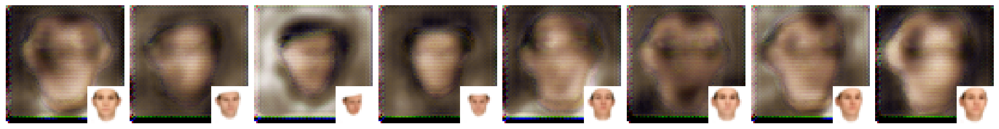

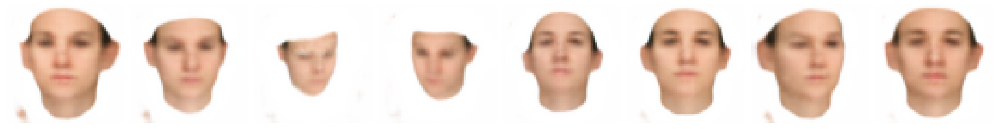

Iter: 1800; D loss: -693.8; G_loss: 1.242e+03; P_loss: 1.046e+03


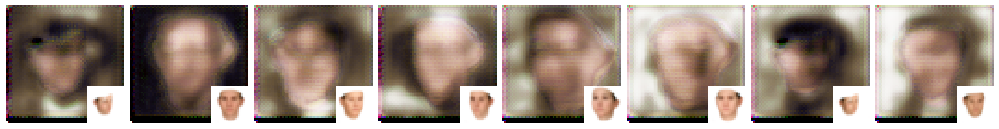

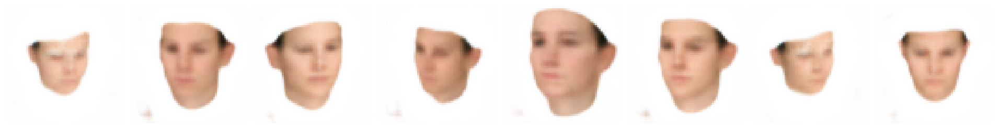

Iter: 1900; D loss: -637.5; G_loss: 712.5; P_loss: 1.013e+03


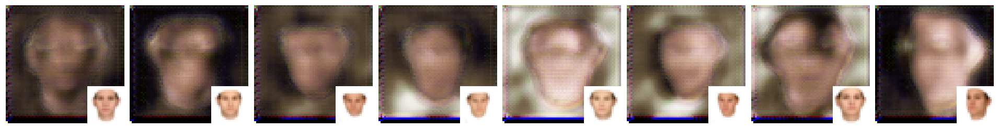

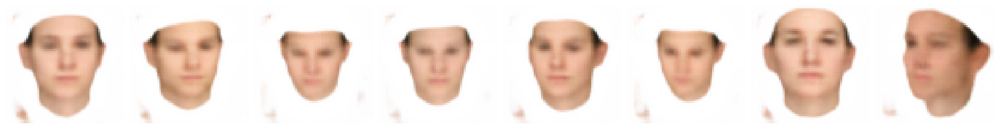

Iter: 2000; D loss: -656.3; G_loss: 731.3; P_loss: 915.9


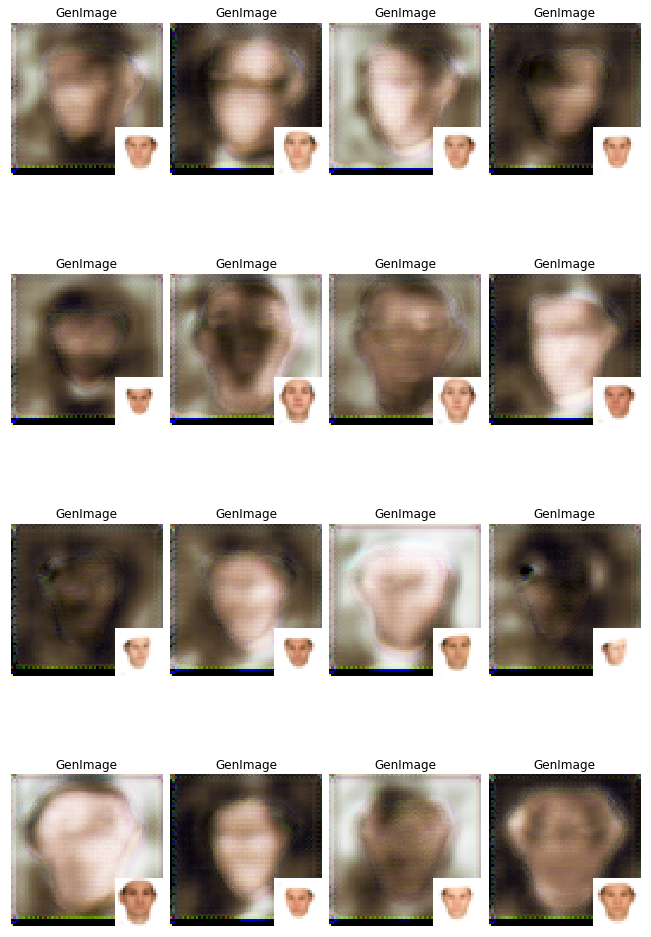

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 2100; D loss: -945.2; G_loss: 93.35; P_loss: 918.5


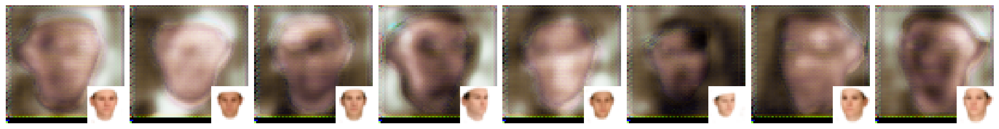

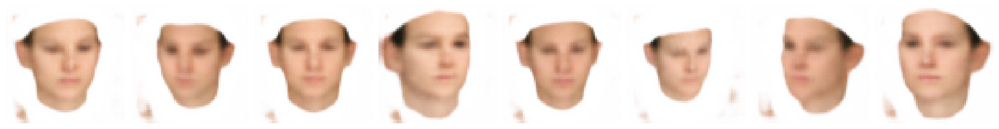

Iter: 2200; D loss: -768.5; G_loss: 1.827e+03; P_loss: 1.074e+03


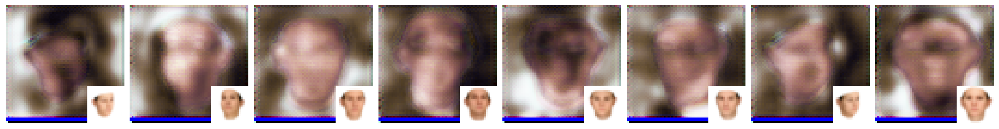

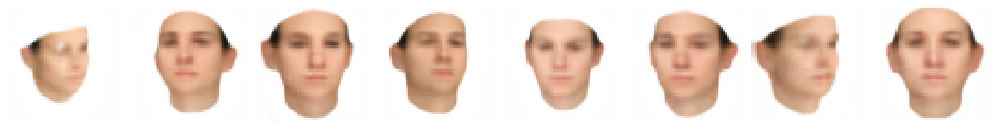

Iter: 2300; D loss: -601.6; G_loss: 1.165e+03; P_loss: 867.3


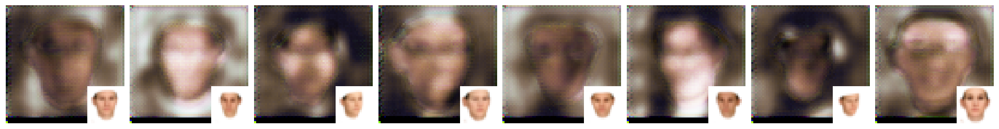

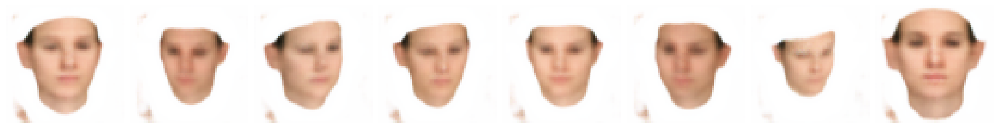

Iter: 2400; D loss: -705.9; G_loss: 400.8; P_loss: 943.4


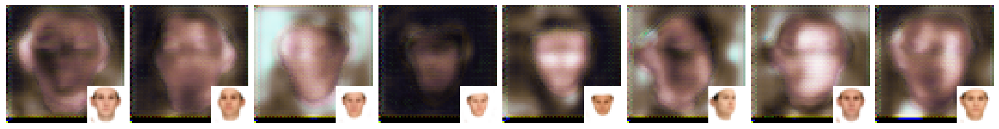

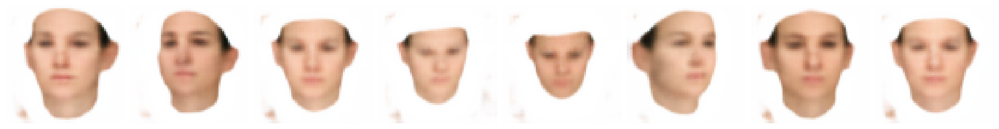

Iter: 2500; D loss: -755.5; G_loss: 2.575e+03; P_loss: 994.3


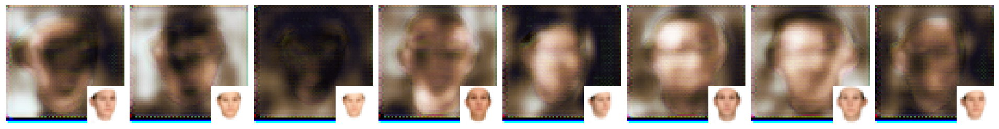

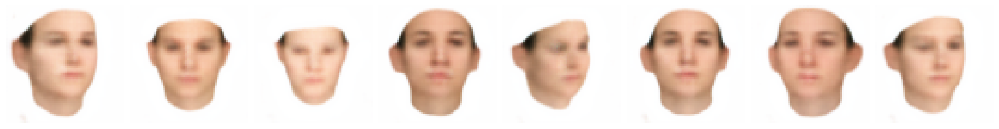

Iter: 2600; D loss: -738.0; G_loss: 800.0; P_loss: 957.7


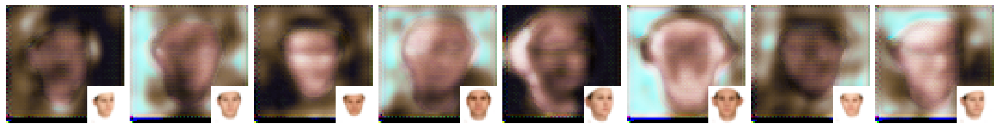

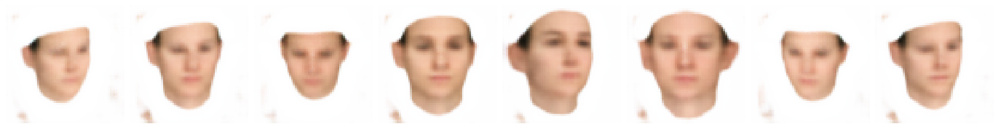

Iter: 2700; D loss: -714.0; G_loss: 364.2; P_loss: 992.1


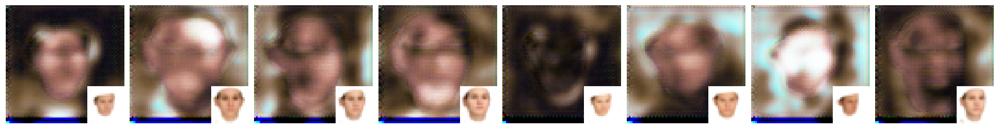

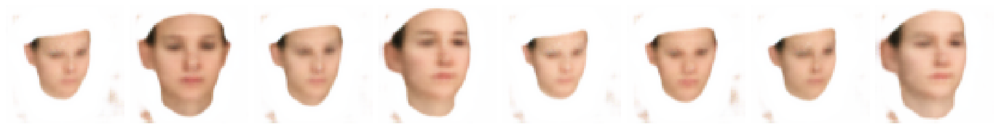

Iter: 2800; D loss: -403.9; G_loss: 1.252e+03; P_loss: 880.7


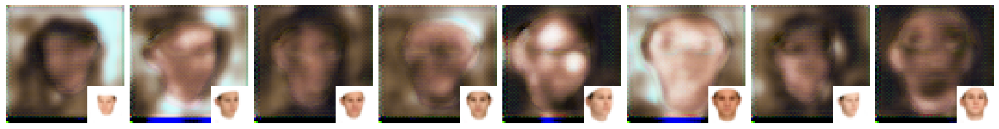

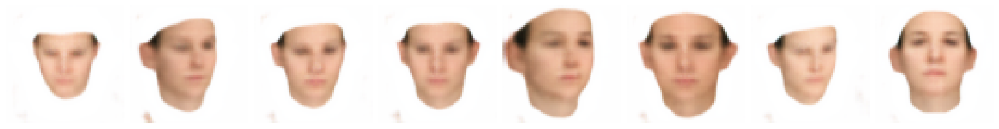

Iter: 2900; D loss: -649.8; G_loss: 1.167e+03; P_loss: 909.5


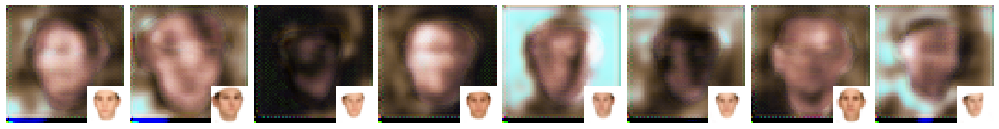

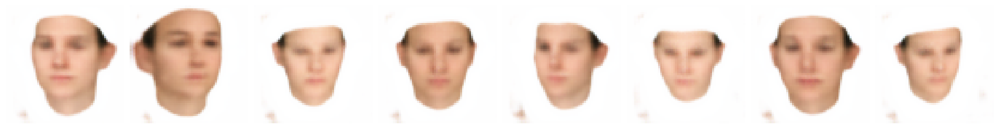

Iter: 3000; D loss: -469.1; G_loss: 1.15e+03; P_loss: 963.5


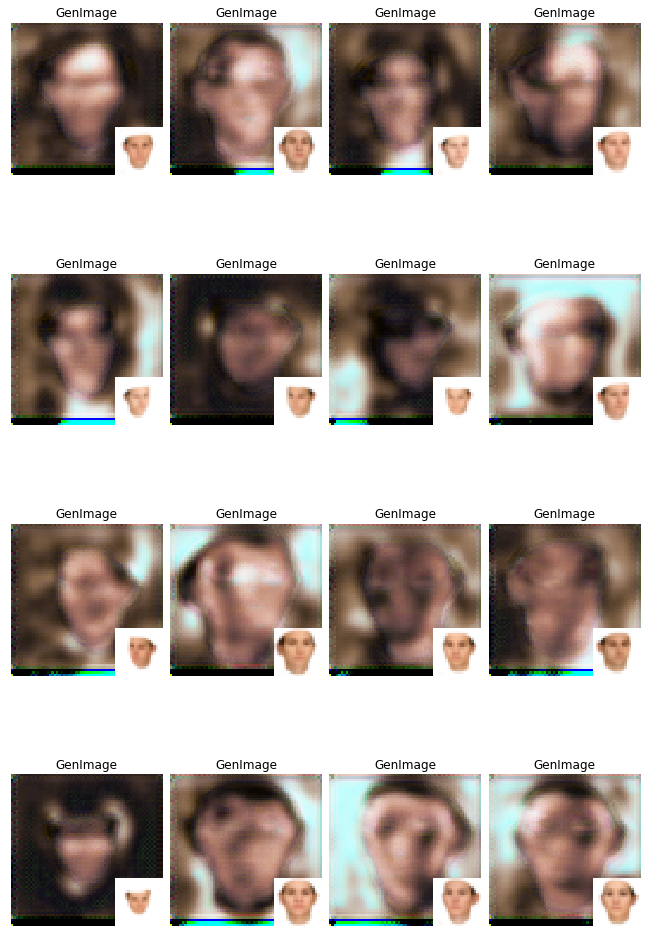

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 3100; D loss: -390.1; G_loss: 971.0; P_loss: 879.5


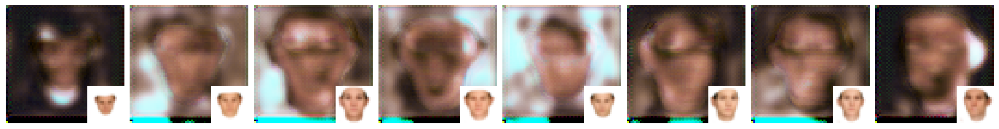

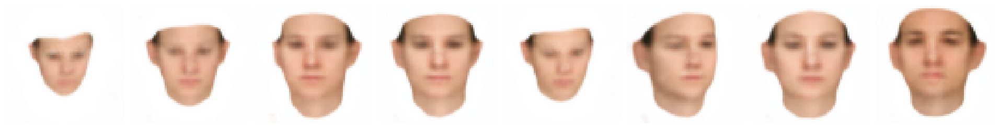

Iter: 3200; D loss: -483.3; G_loss: 1.968e+03; P_loss: 1.003e+03


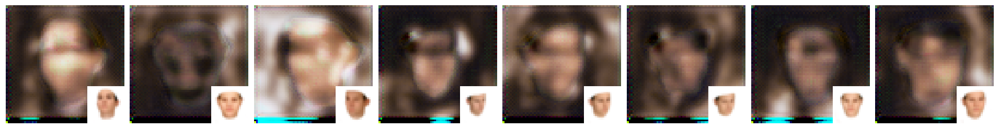

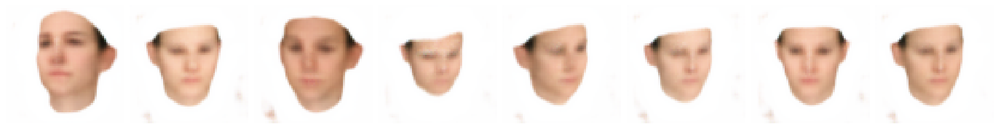

Iter: 3300; D loss: -532.3; G_loss: 1.128e+03; P_loss: 875.6


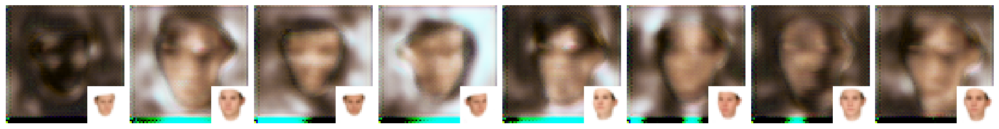

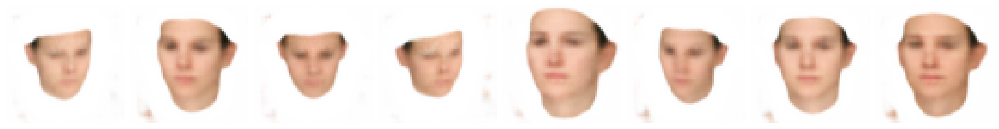

Iter: 3400; D loss: -415.9; G_loss: 2.06e+03; P_loss: 878.7


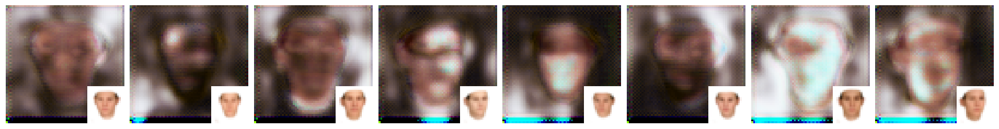

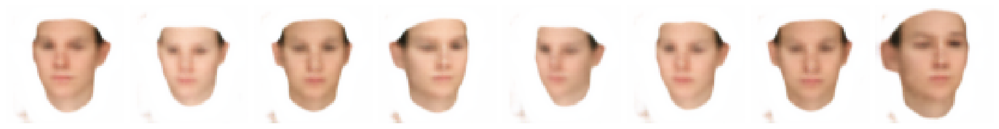

Iter: 3500; D loss: -404.0; G_loss: 1.625e+03; P_loss: 903.5


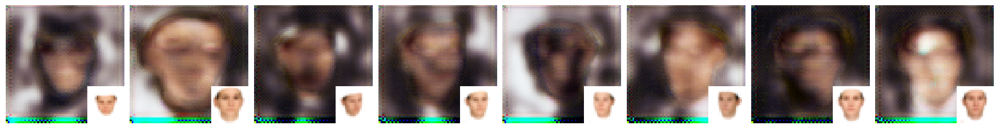

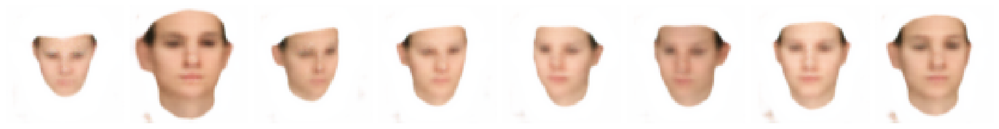

Iter: 3600; D loss: -486.2; G_loss: 1.962e+03; P_loss: 878.3


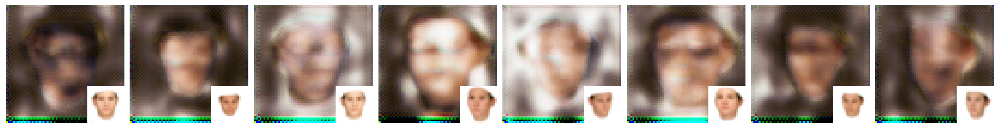

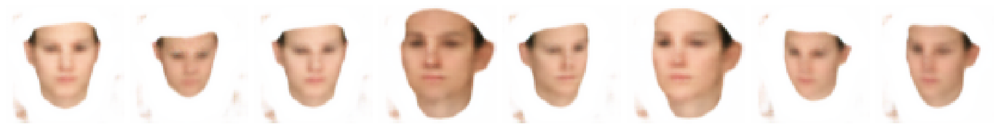

Iter: 3700; D loss: -396.2; G_loss: 893.4; P_loss: 805.2


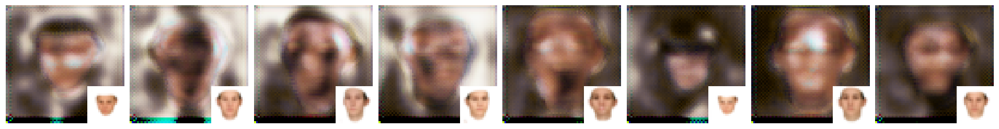

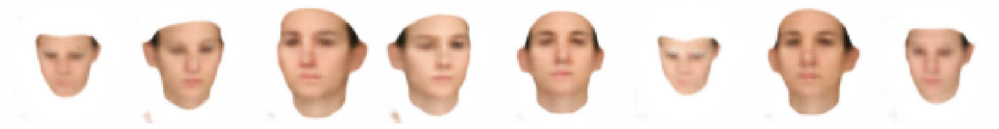

Iter: 3800; D loss: -520.0; G_loss: 1.702e+03; P_loss: 858.2


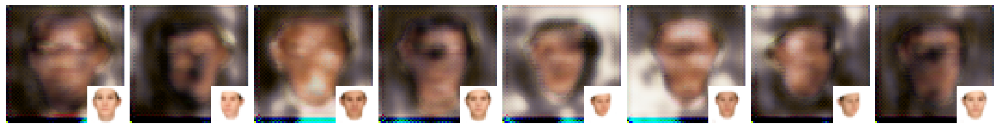

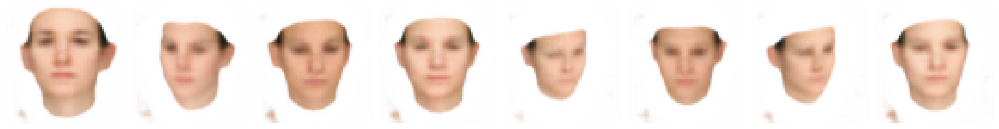

Iter: 3900; D loss: -530.1; G_loss: 2.596e+03; P_loss: 895.8


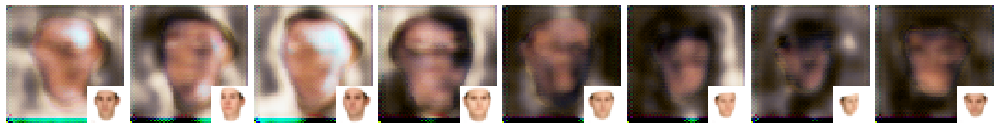

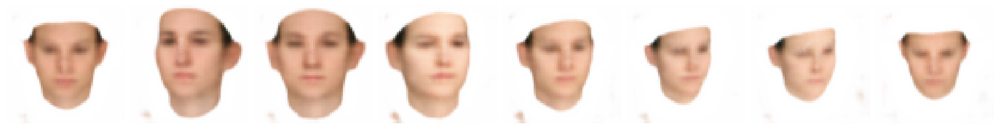

Iter: 4000; D loss: -380.1; G_loss: 1.668e+03; P_loss: 907.4


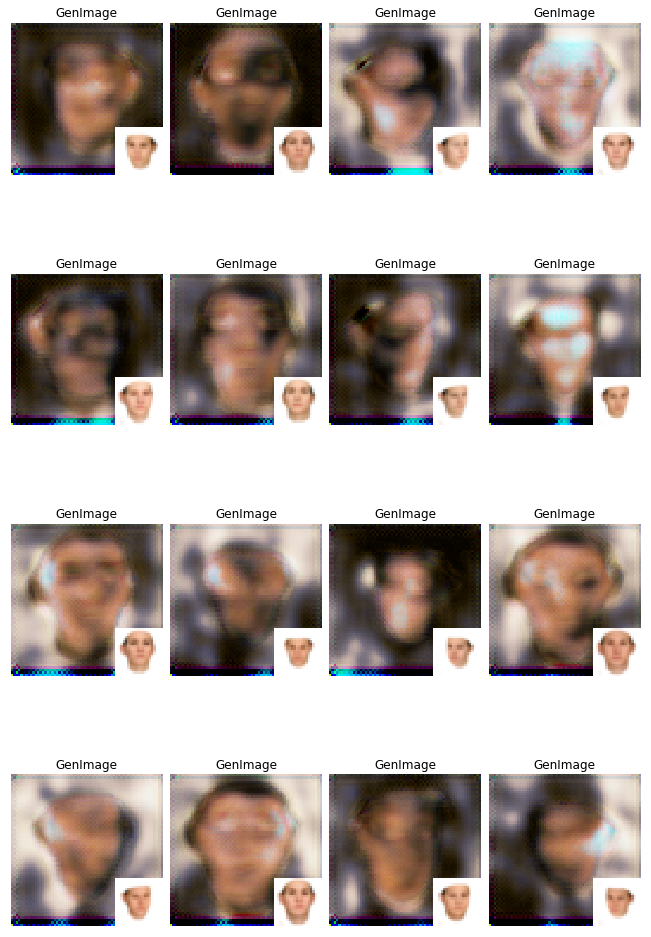

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 4100; D loss: -535.5; G_loss: 1.605e+03; P_loss: 869.6


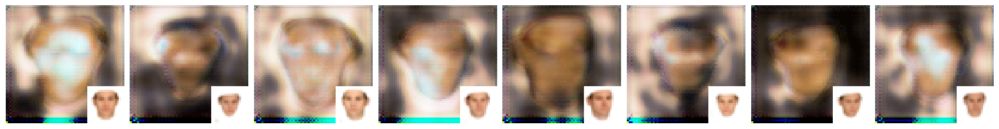

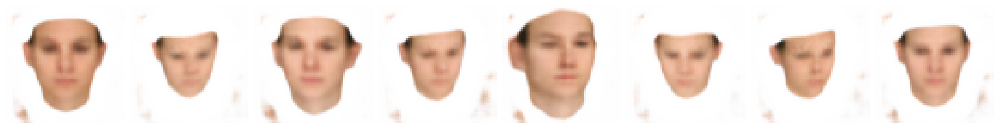

Iter: 4200; D loss: -382.1; G_loss: 1.908e+03; P_loss: 946.1


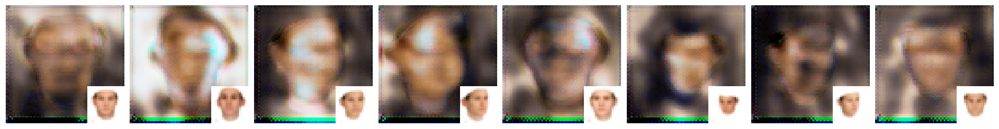

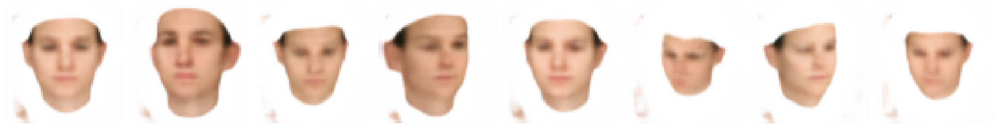

Iter: 4300; D loss: -520.5; G_loss: 1.659e+03; P_loss: 872.4


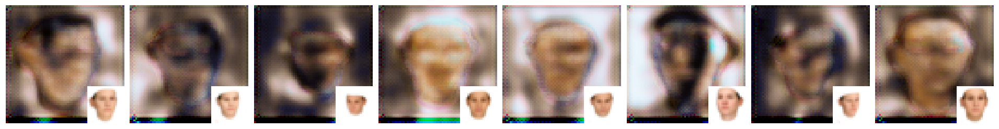

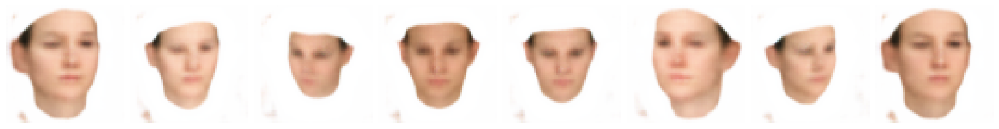

Iter: 4400; D loss: -643.9; G_loss: 1.613e+03; P_loss: 889.6


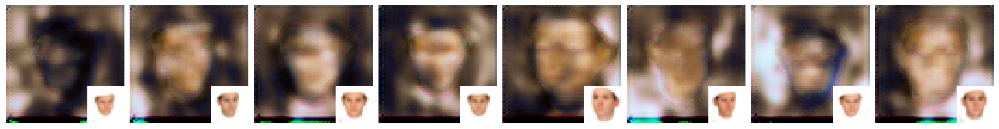

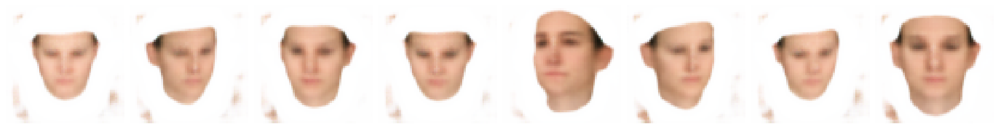

Iter: 4500; D loss: -470.4; G_loss: 2.044e+03; P_loss: 838.9


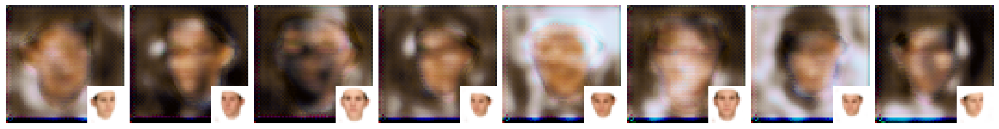

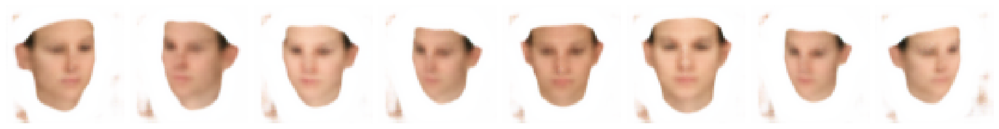

Iter: 4600; D loss: -633.5; G_loss: 1.868e+03; P_loss: 841.7


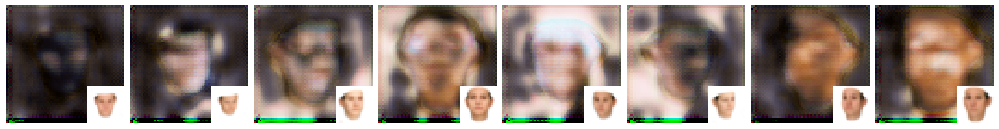

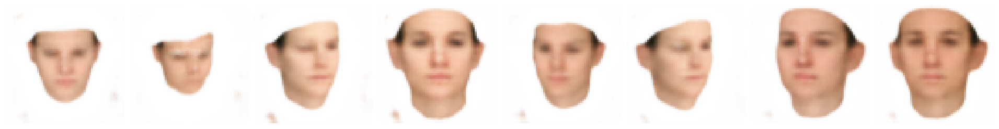

Iter: 4700; D loss: -611.7; G_loss: 1.633e+03; P_loss: 831.2


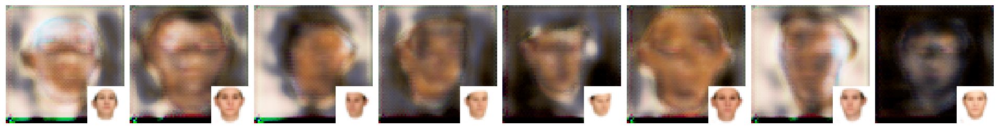

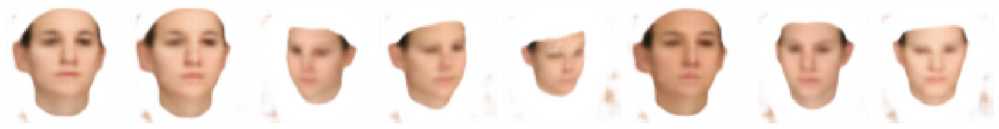

Iter: 4800; D loss: -514.0; G_loss: 1.106e+03; P_loss: 807.6


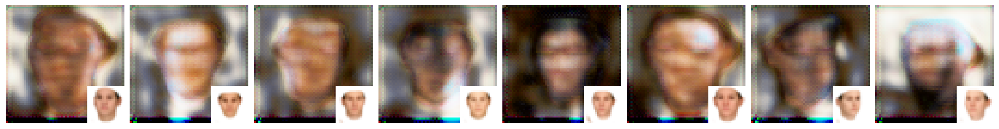

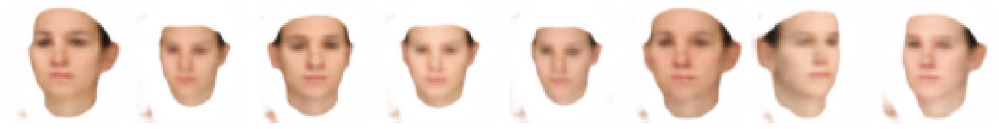

Iter: 4900; D loss: -577.7; G_loss: 1.962e+03; P_loss: 804.7


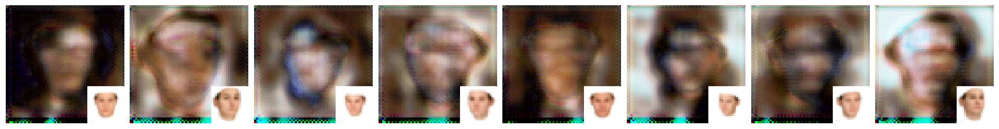

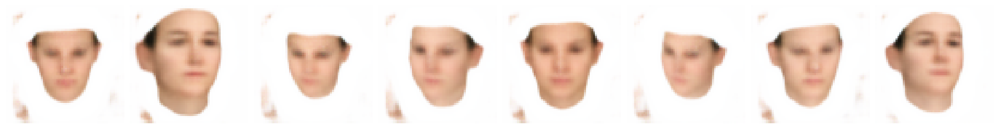

Iter: 5000; D loss: -663.4; G_loss: 1.32e+03; P_loss: 825.8


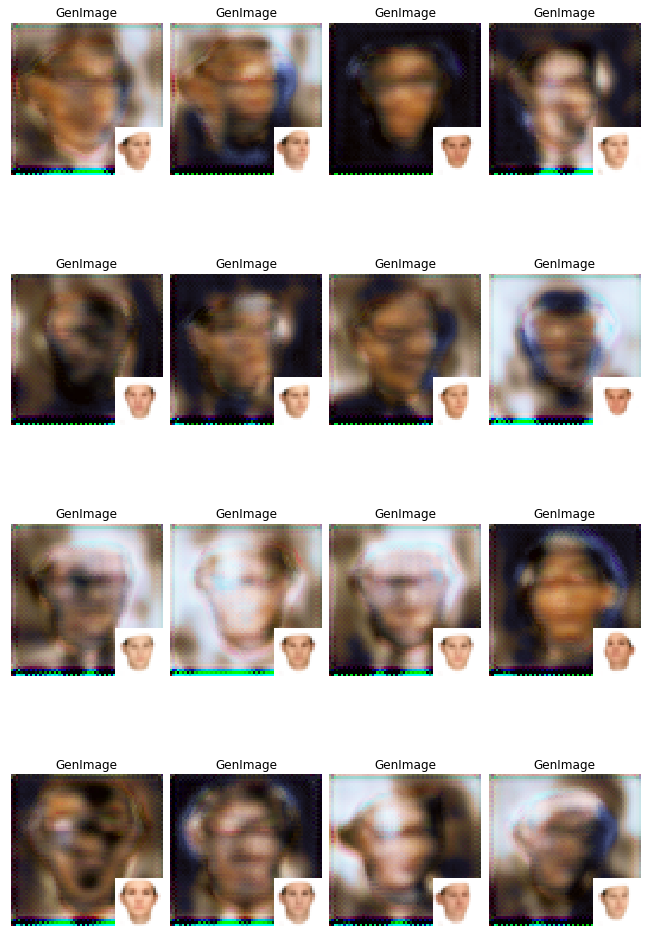

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 5100; D loss: -535.0; G_loss: 1.869e+03; P_loss: 807.1


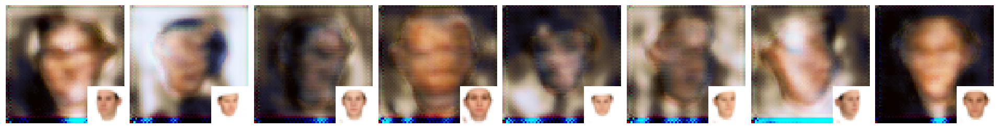

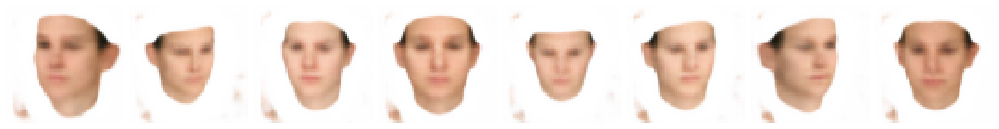

Iter: 5200; D loss: -619.3; G_loss: 1.819e+03; P_loss: 806.4


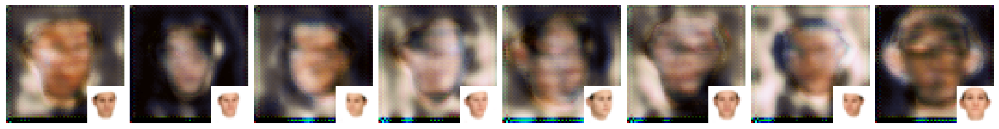

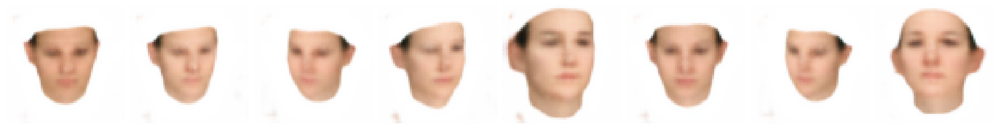

Iter: 5300; D loss: -597.1; G_loss: 1.68e+03; P_loss: 792.1


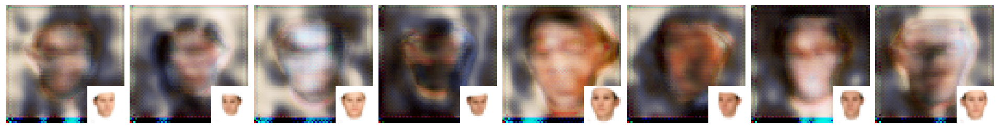

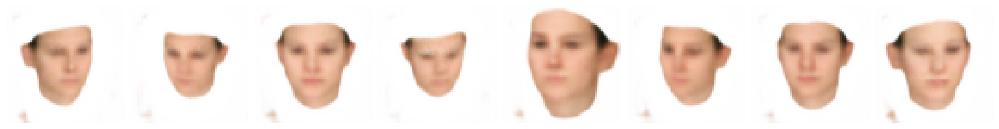

Iter: 5400; D loss: -607.6; G_loss: 1.451e+03; P_loss: 789.7


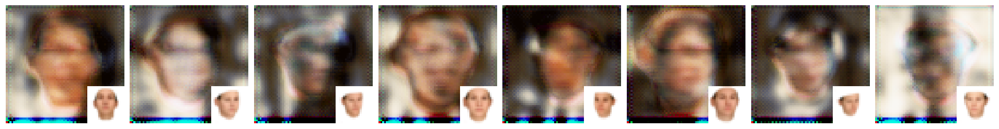

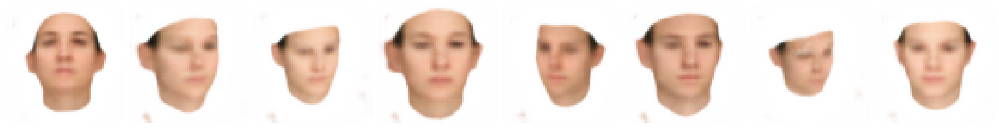

Iter: 5500; D loss: -827.1; G_loss: 1.394e+03; P_loss: 821.7


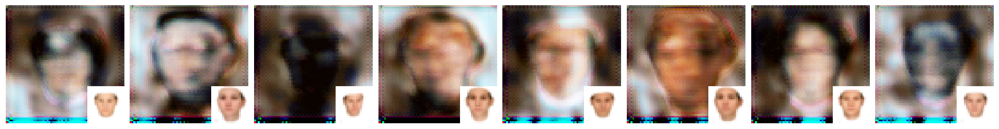

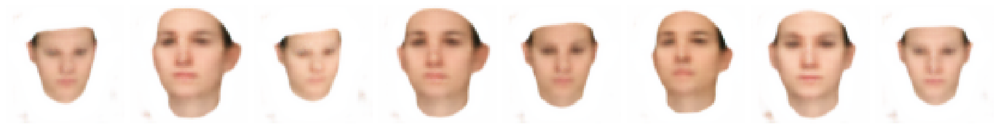

Iter: 5600; D loss: -701.6; G_loss: 1.382e+03; P_loss: 791.3


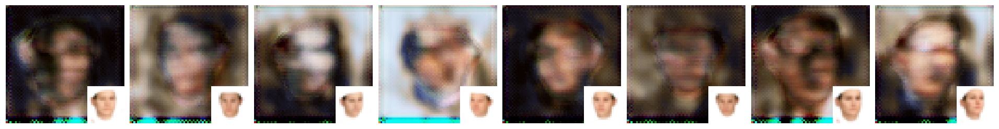

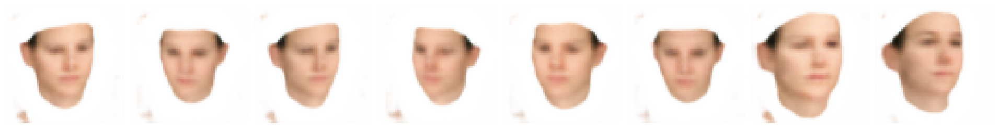

Iter: 5700; D loss: -586.9; G_loss: 1.878e+03; P_loss: 778.6


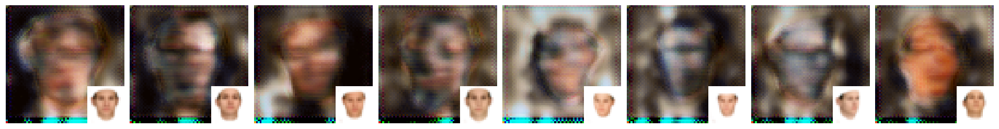

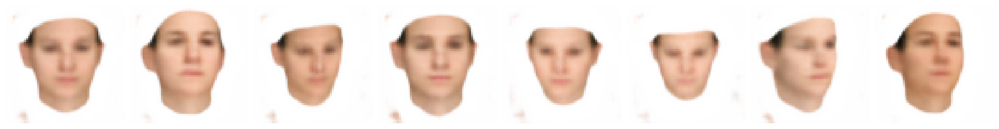

Iter: 5800; D loss: -668.4; G_loss: 1.629e+03; P_loss: 834.5


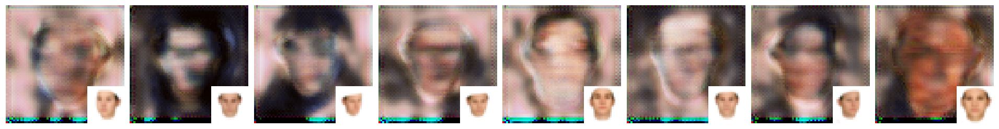

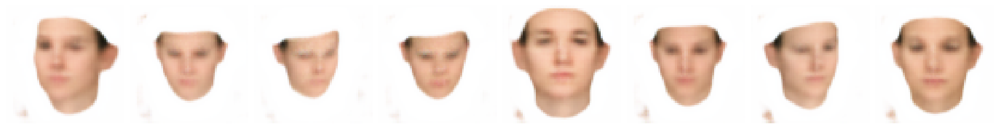

Iter: 5900; D loss: -506.1; G_loss: 1.605e+03; P_loss: 722.6


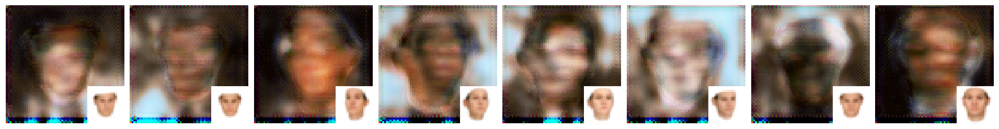

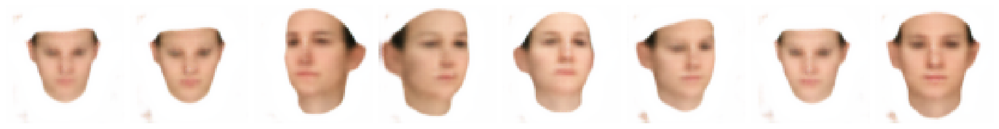

Iter: 6000; D loss: -748.8; G_loss: 1.66e+03; P_loss: 822.1


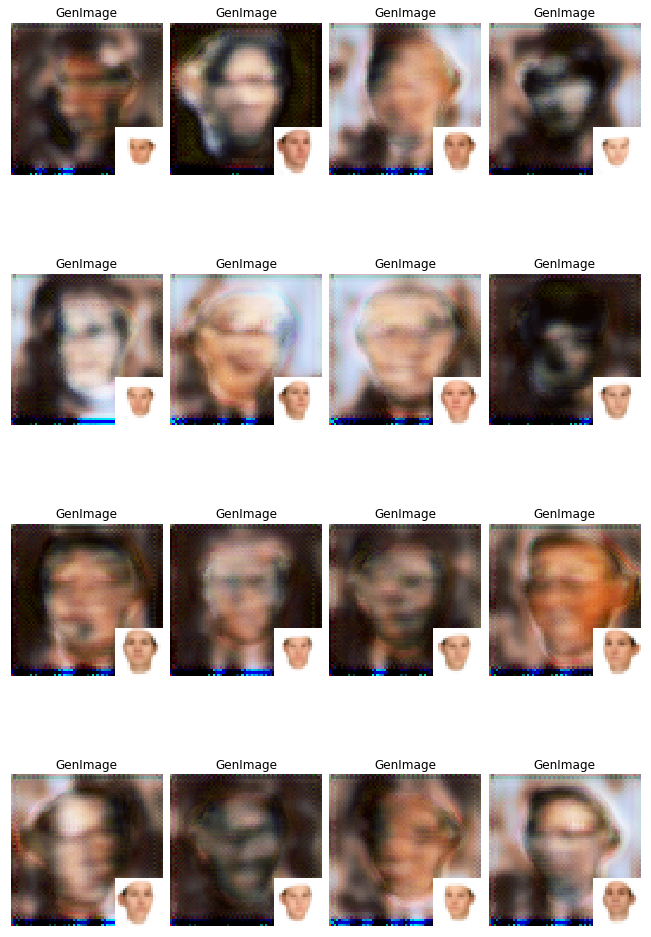

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 6100; D loss: -625.5; G_loss: 1.664e+03; P_loss: 817.0


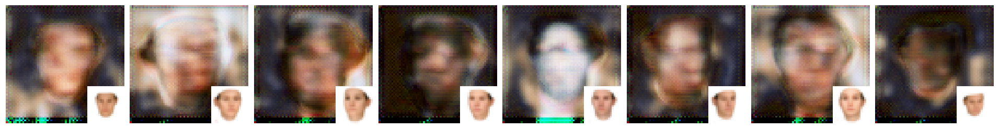

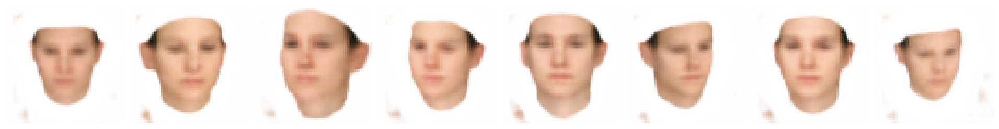

Iter: 6200; D loss: -651.6; G_loss: 1.407e+03; P_loss: 771.3


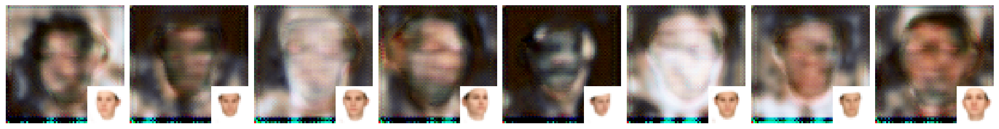

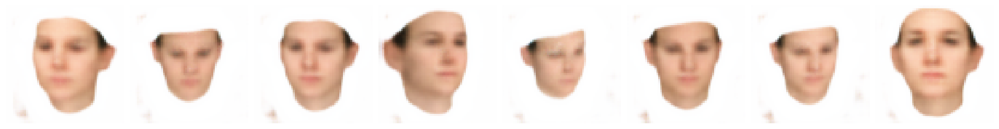

Iter: 6300; D loss: -668.2; G_loss: 1.598e+03; P_loss: 863.0


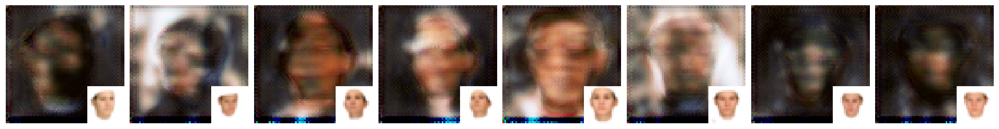

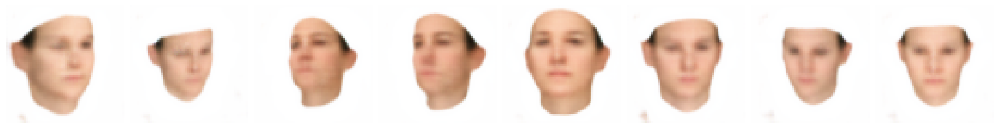

Iter: 6400; D loss: -789.6; G_loss: 1.736e+03; P_loss: 848.3


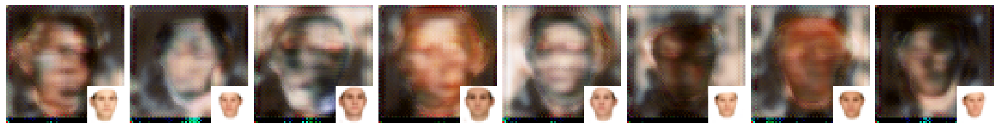

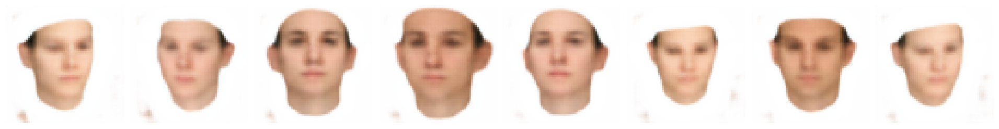

Iter: 6500; D loss: -617.2; G_loss: 1.809e+03; P_loss: 724.0


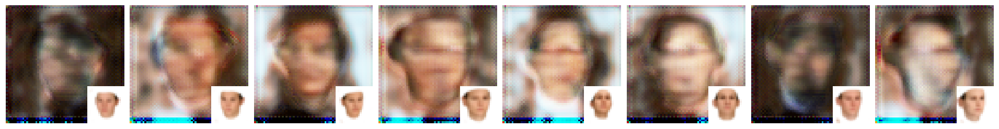

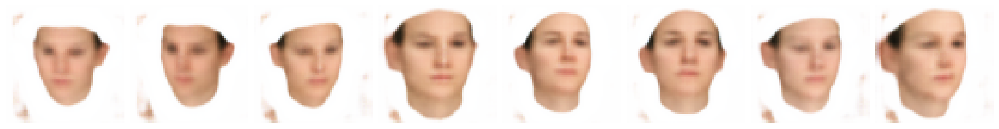

Iter: 6600; D loss: -628.0; G_loss: 2.166e+03; P_loss: 832.8


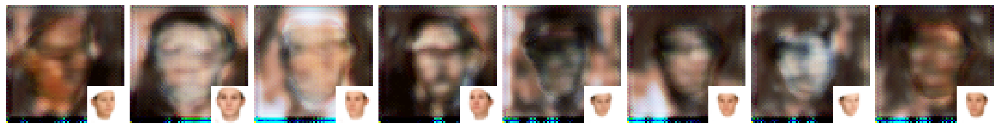

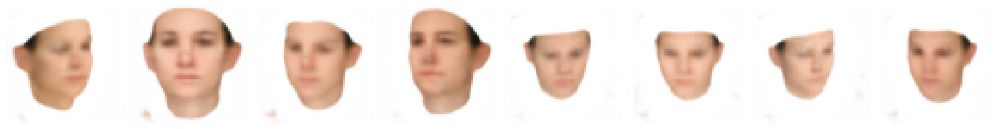

Iter: 6700; D loss: -694.4; G_loss: 1.785e+03; P_loss: 748.5


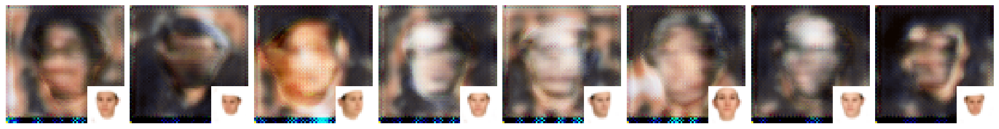

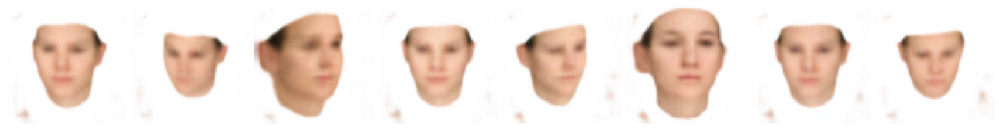

Iter: 6800; D loss: -647.9; G_loss: 1.924e+03; P_loss: 748.4


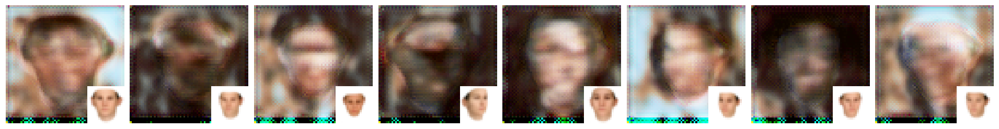

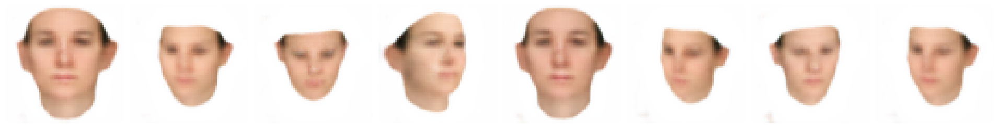

Iter: 6900; D loss: -687.6; G_loss: 1.947e+03; P_loss: 769.7


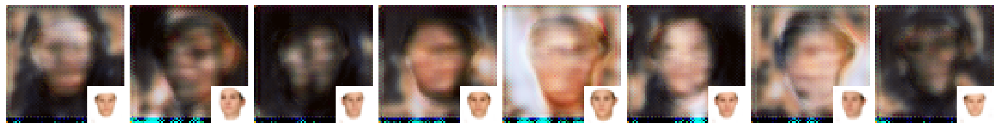

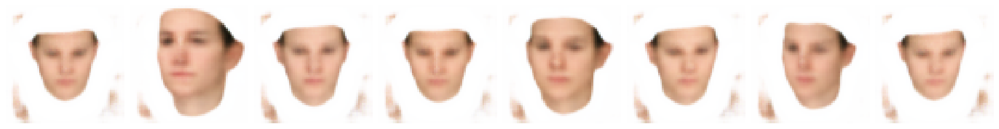

Iter: 7000; D loss: -600.8; G_loss: 1.849e+03; P_loss: 766.5


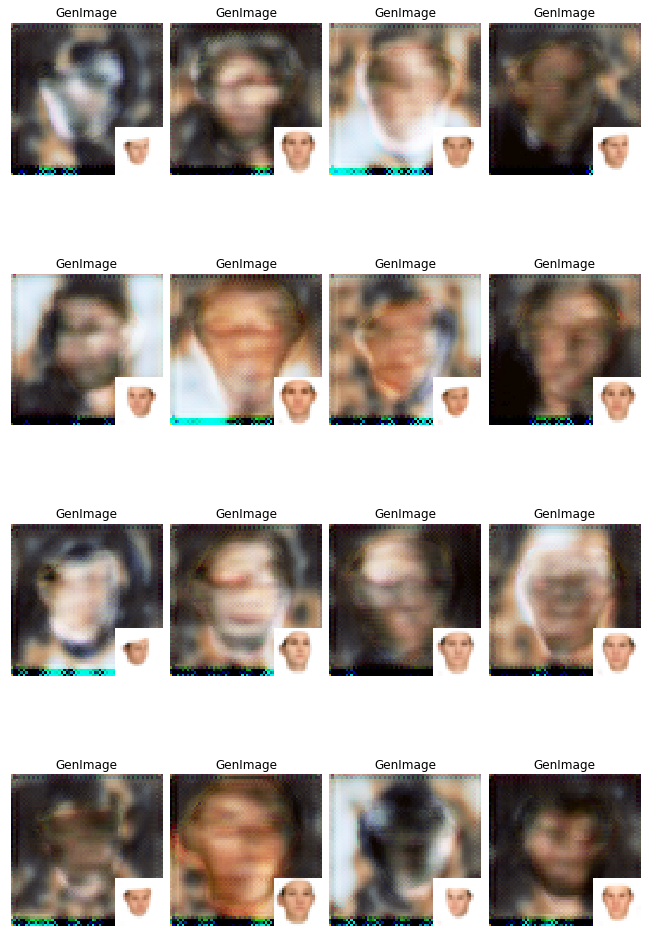

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 7100; D loss: -572.1; G_loss: 1.884e+03; P_loss: 825.1


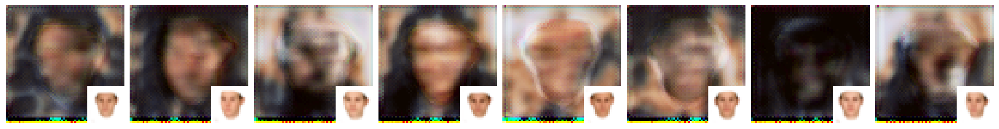

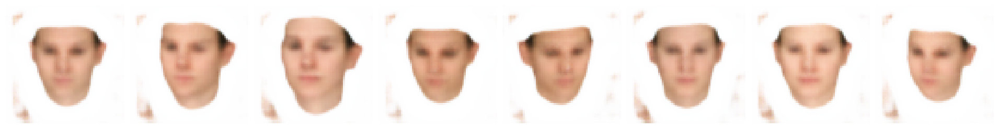

Iter: 7200; D loss: -186.3; G_loss: 1.57e+03; P_loss: 1.06e+03


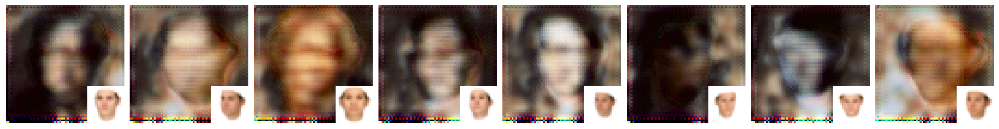

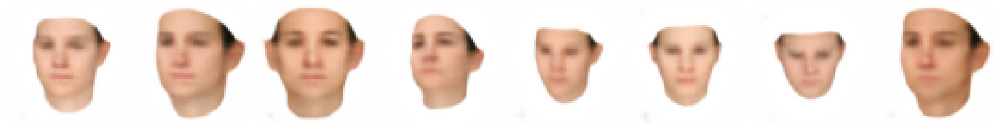

Iter: 7300; D loss: -189.7; G_loss: 1.565e+03; P_loss: 934.1


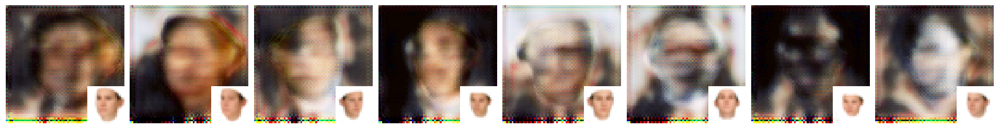

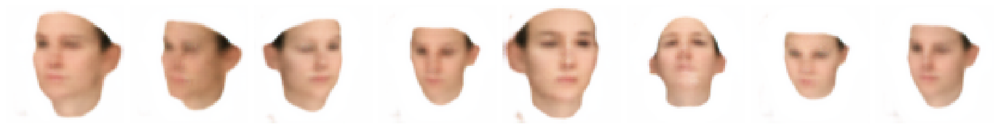

Iter: 7400; D loss: -230.2; G_loss: 1.227e+03; P_loss: 822.9


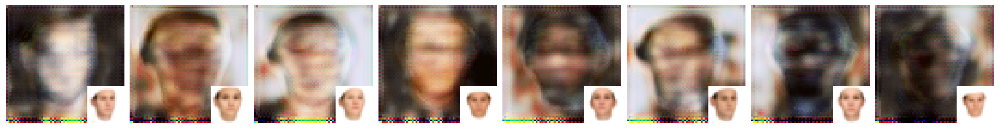

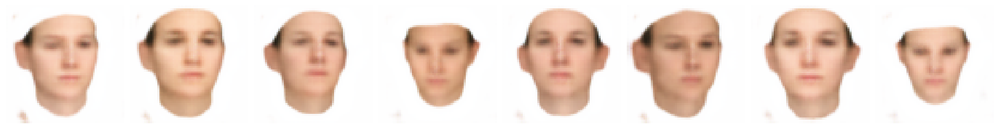

Iter: 7500; D loss: -276.9; G_loss: 1.859e+03; P_loss: 835.1


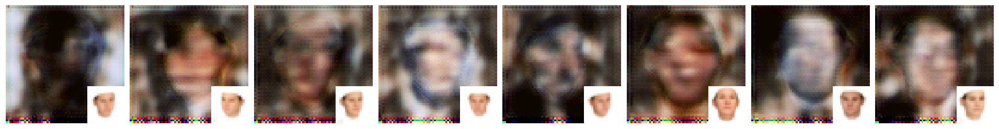

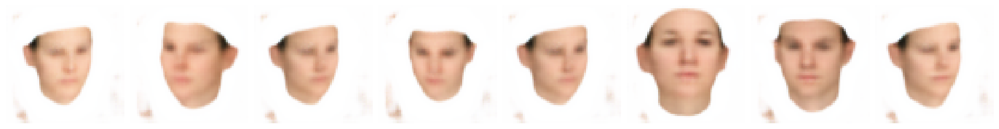

Iter: 7600; D loss: -231.2; G_loss: 1.46e+03; P_loss: 723.3


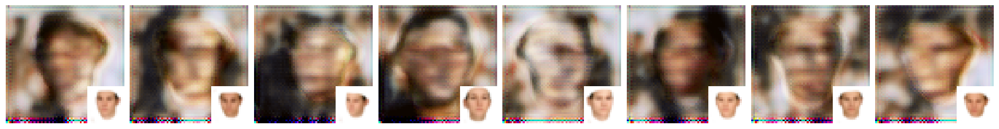

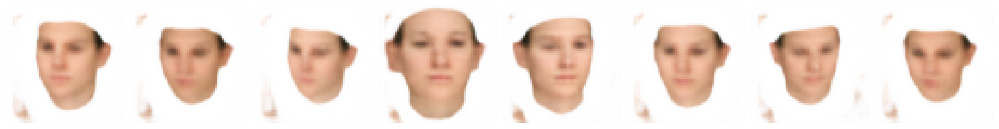

Iter: 7700; D loss: -347.5; G_loss: 1.524e+03; P_loss: 845.7


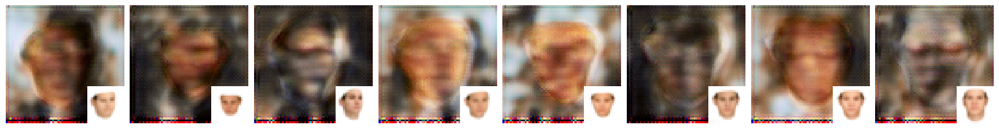

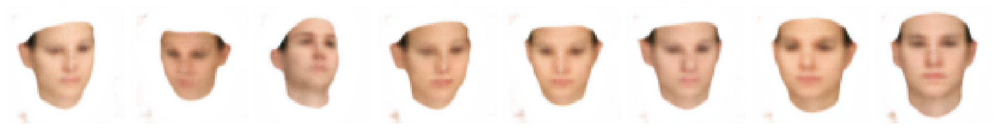

Iter: 7800; D loss: -283.2; G_loss: 1.887e+03; P_loss: 753.5


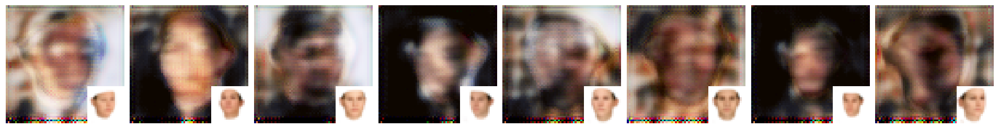

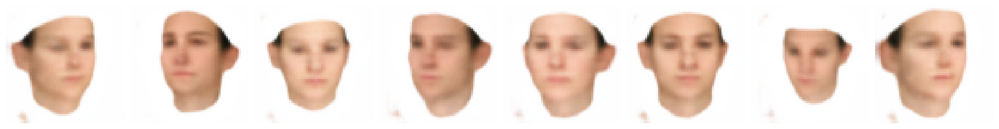

Iter: 7900; D loss: -357.5; G_loss: 1.738e+03; P_loss: 765.5


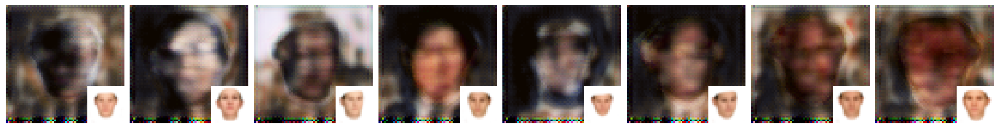

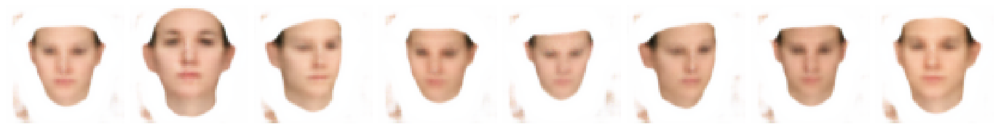

Iter: 8000; D loss: -339.2; G_loss: 1.497e+03; P_loss: 776.0


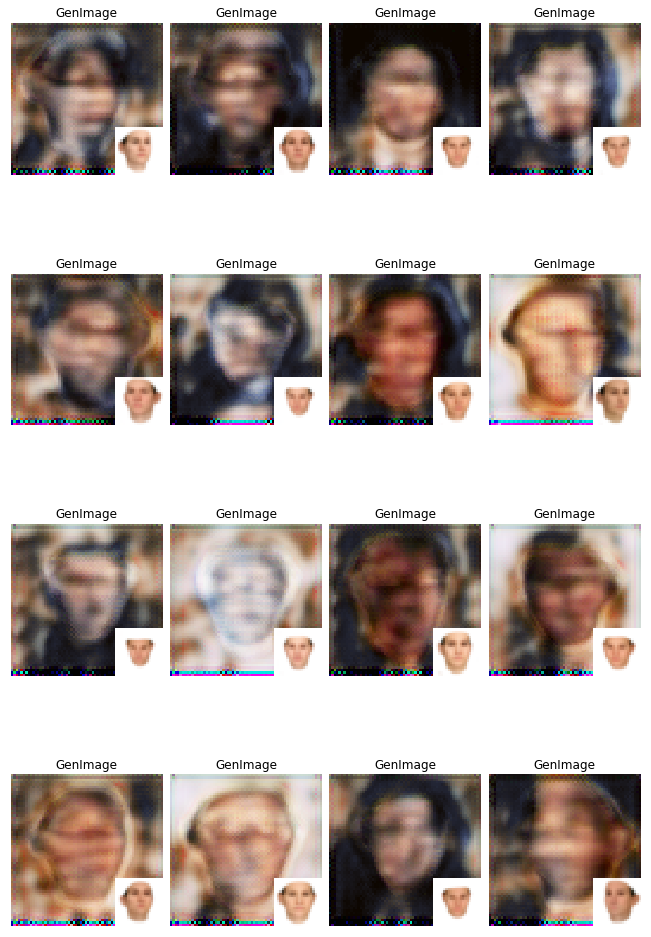

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 8100; D loss: -368.4; G_loss: 1.507e+03; P_loss: 749.6


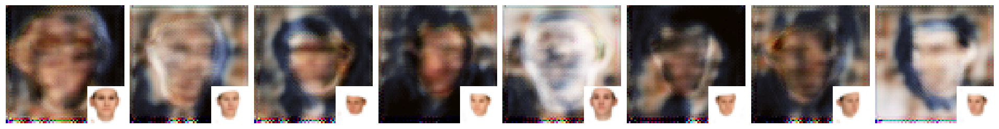

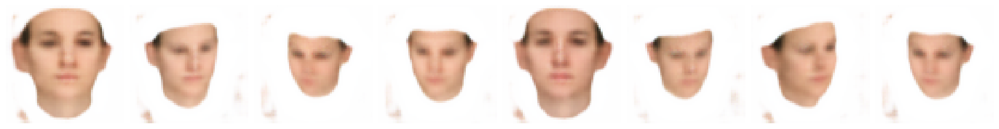

Iter: 8200; D loss: -331.7; G_loss: 1.318e+03; P_loss: 727.8


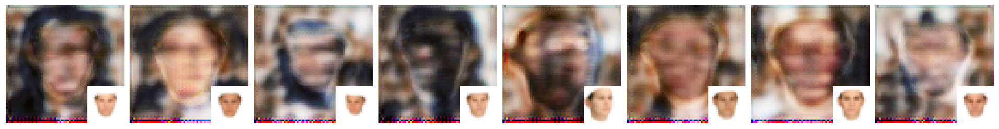

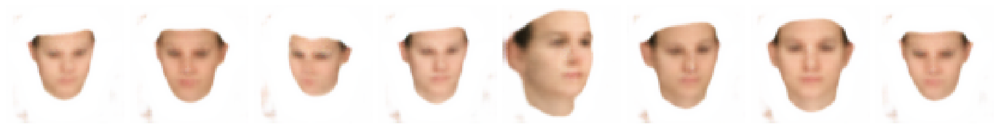

Iter: 8300; D loss: -375.9; G_loss: 1.441e+03; P_loss: 768.9


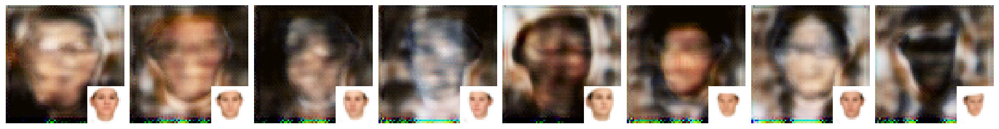

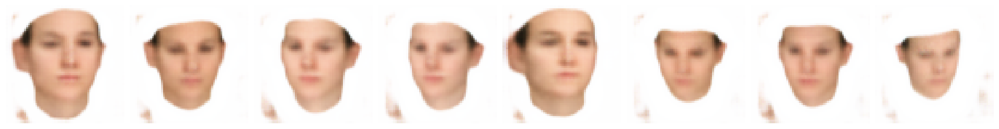

Iter: 8400; D loss: -289.3; G_loss: 1.539e+03; P_loss: 717.9


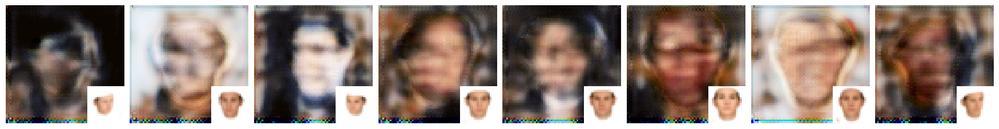

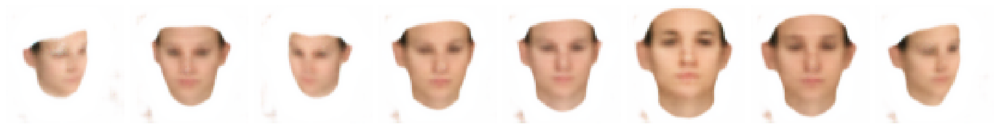

Iter: 8500; D loss: -416.4; G_loss: 1.241e+03; P_loss: 747.7


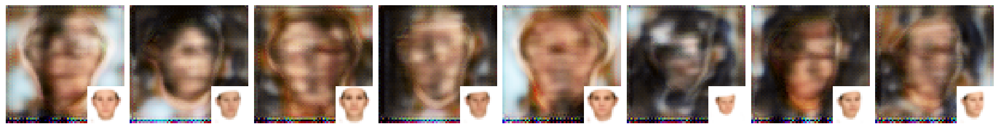

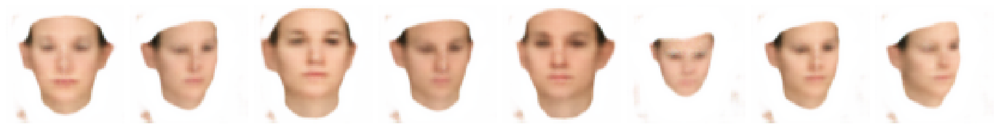

Iter: 8600; D loss: -432.3; G_loss: 1.757e+03; P_loss: 797.5


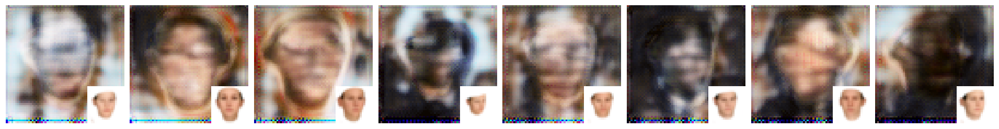

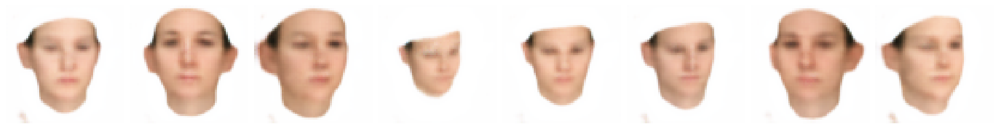

Iter: 8700; D loss: -500.2; G_loss: 1.535e+03; P_loss: 757.8


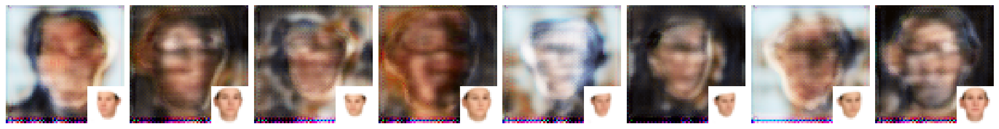

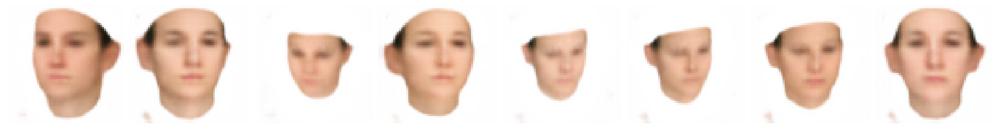

Iter: 8800; D loss: -396.3; G_loss: 1.746e+03; P_loss: 724.2


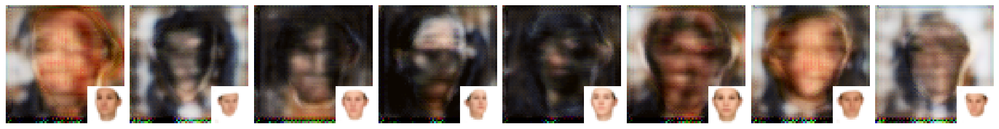

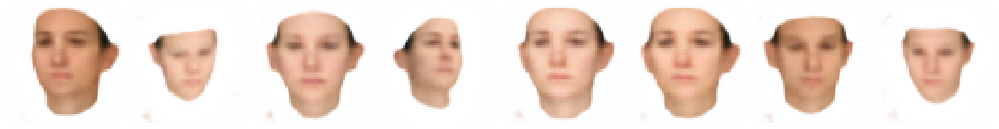

Iter: 8900; D loss: -449.2; G_loss: 1.872e+03; P_loss: 776.3


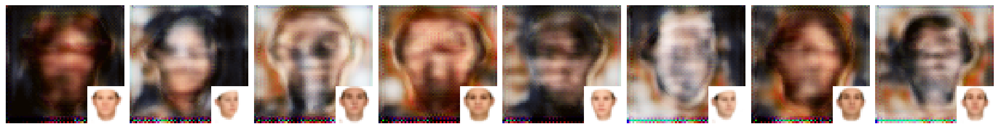

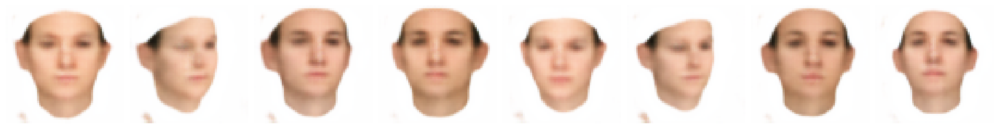

Iter: 9000; D loss: -450.9; G_loss: 1.614e+03; P_loss: 755.2


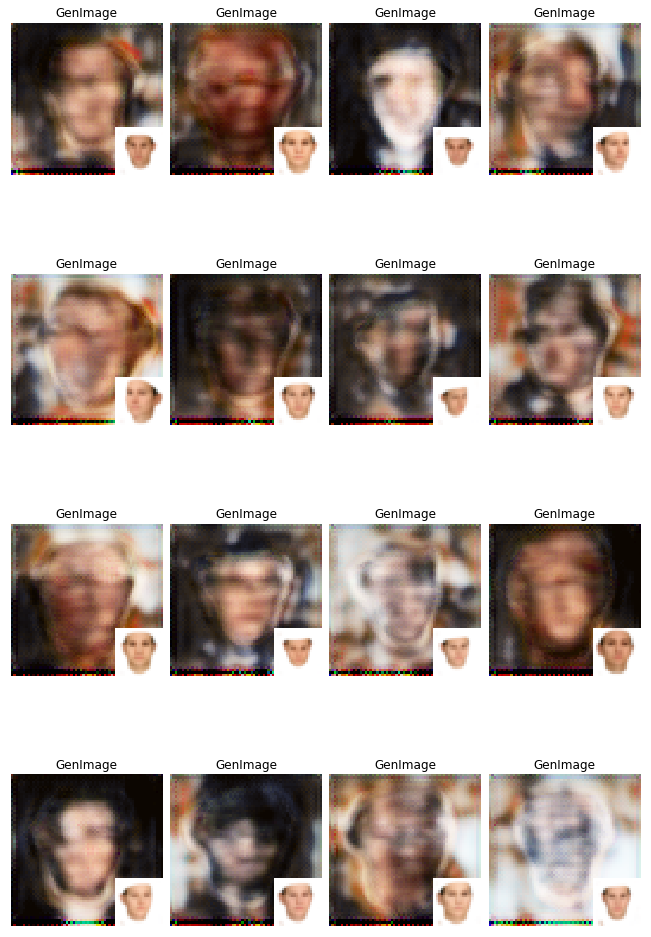

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 9100; D loss: -426.0; G_loss: 1.125e+03; P_loss: 738.3


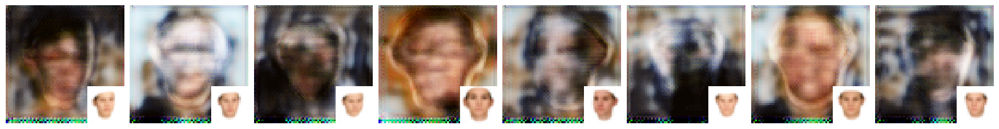

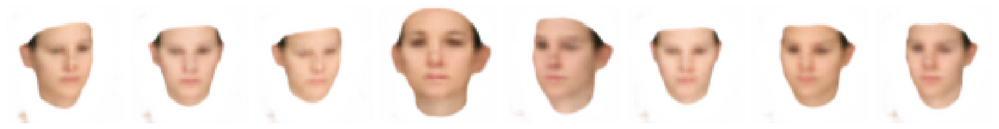

Iter: 9200; D loss: -346.7; G_loss: 1.554e+03; P_loss: 788.2


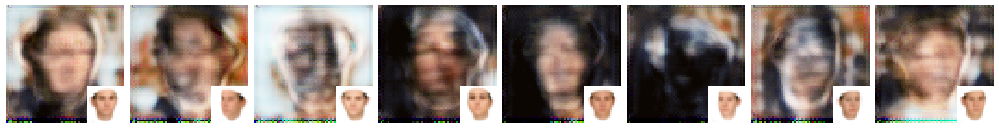

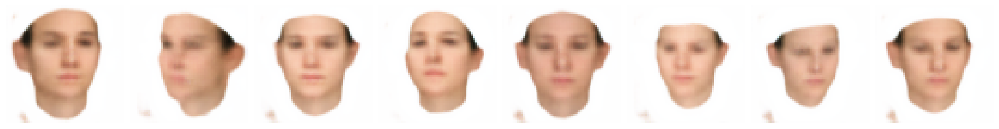

Iter: 9300; D loss: -422.8; G_loss: 1.471e+03; P_loss: 773.2


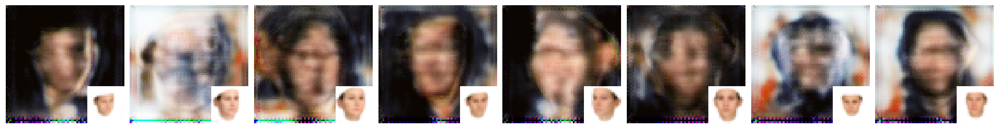

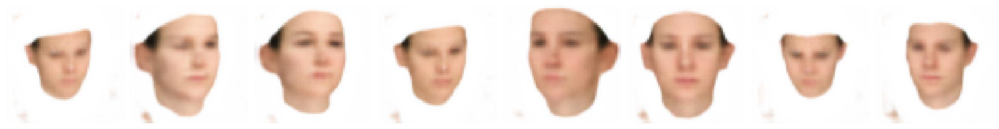

Iter: 9400; D loss: -395.4; G_loss: 1.492e+03; P_loss: 752.2


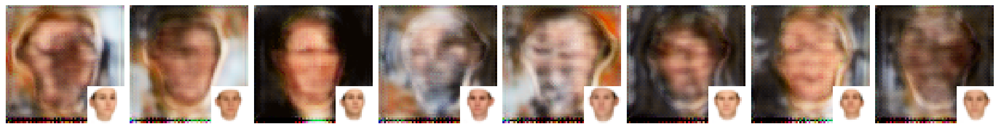

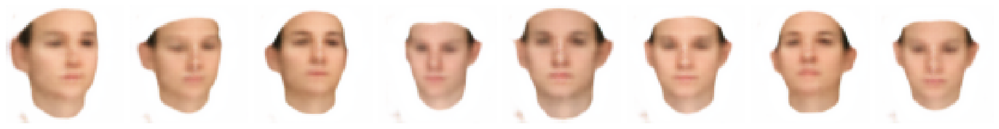

Iter: 9500; D loss: -311.0; G_loss: 1.815e+03; P_loss: 723.2


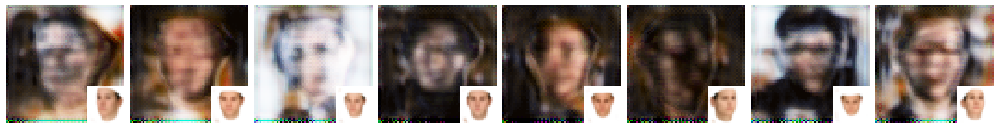

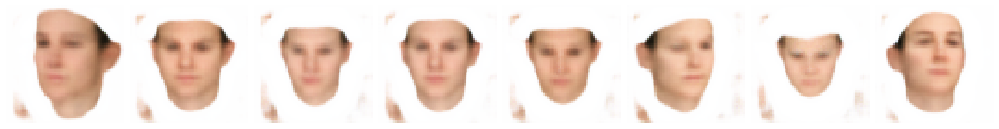

Iter: 9600; D loss: -438.0; G_loss: 1.815e+03; P_loss: 730.0


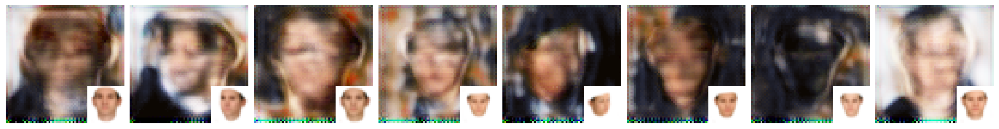

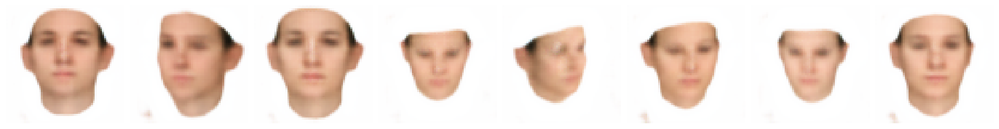

Iter: 9700; D loss: -489.4; G_loss: 1.328e+03; P_loss: 718.3


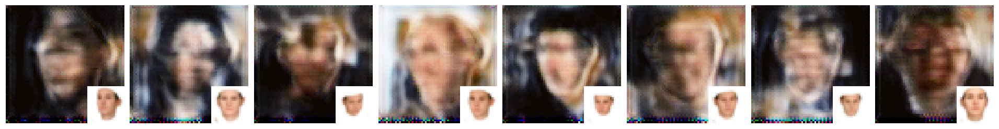

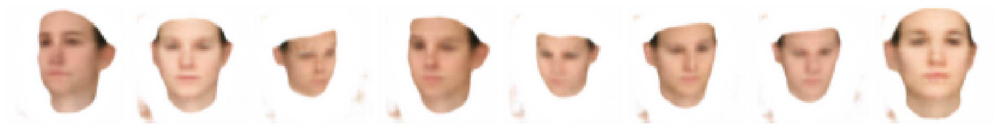

Iter: 9800; D loss: -404.6; G_loss: 1.345e+03; P_loss: 710.1


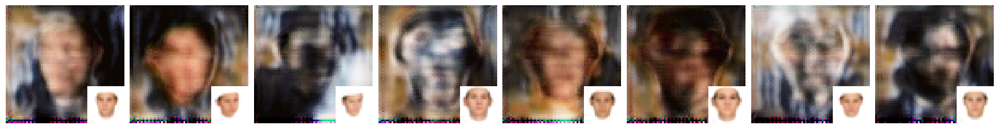

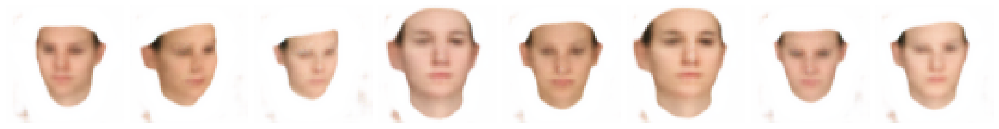

Iter: 9900; D loss: -421.3; G_loss: 1.587e+03; P_loss: 720.6


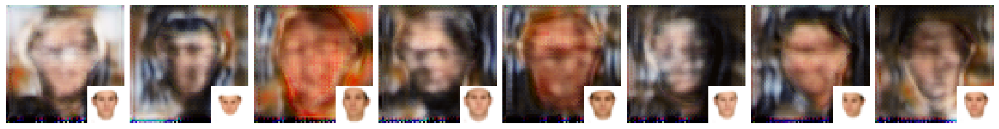

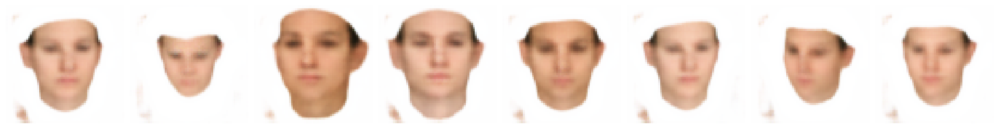

Iter: 10000; D loss: -474.3; G_loss: 1.105e+03; P_loss: 742.7


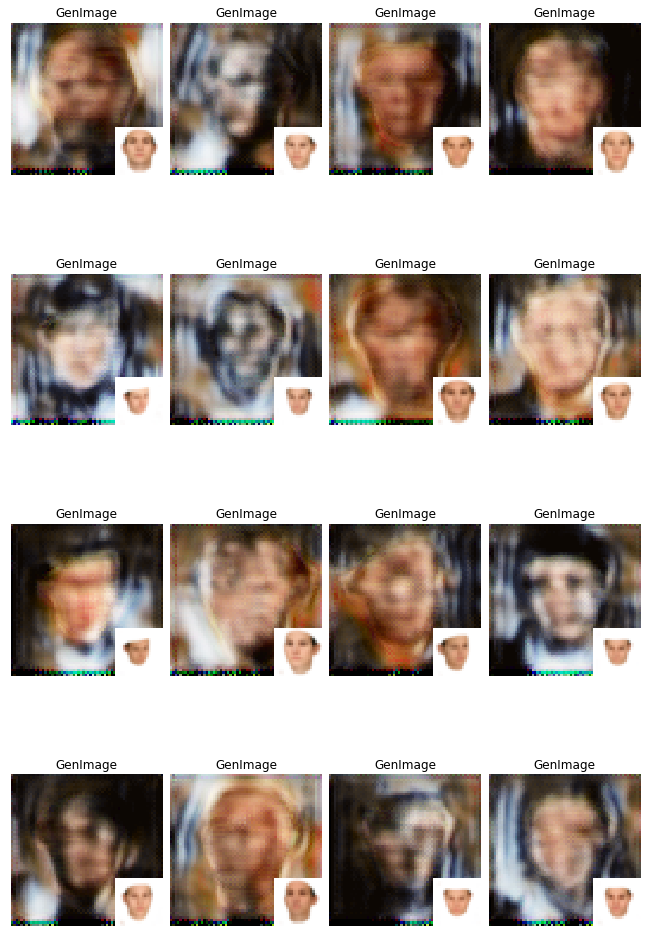

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 10100; D loss: -426.0; G_loss: 1.515e+03; P_loss: 798.5


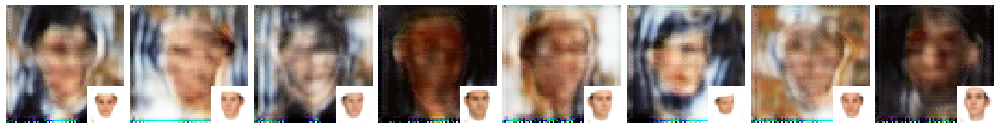

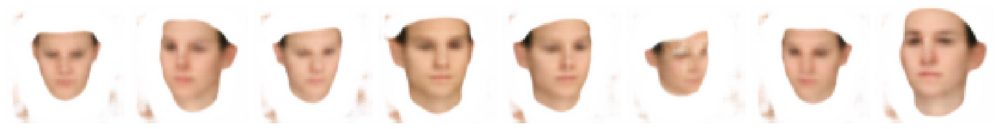

Iter: 10200; D loss: -515.4; G_loss: 1.389e+03; P_loss: 724.6


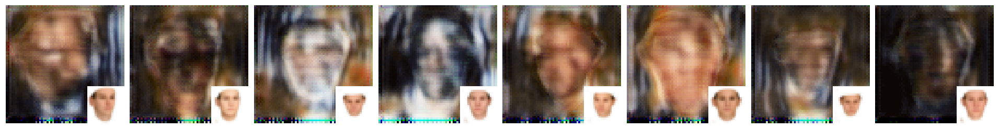

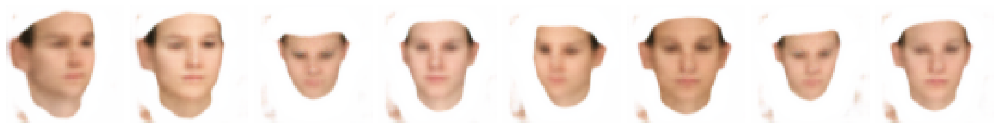

Iter: 10300; D loss: -458.7; G_loss: 1.58e+03; P_loss: 764.5


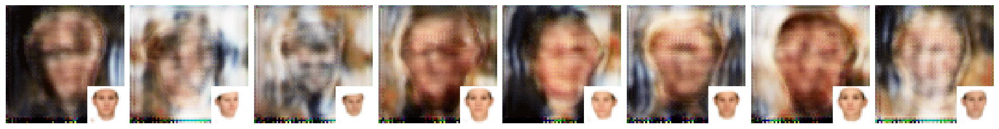

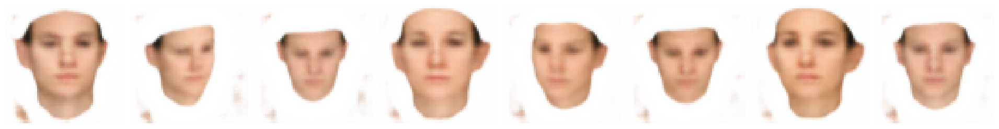

Iter: 10400; D loss: -385.9; G_loss: 1.574e+03; P_loss: 735.9


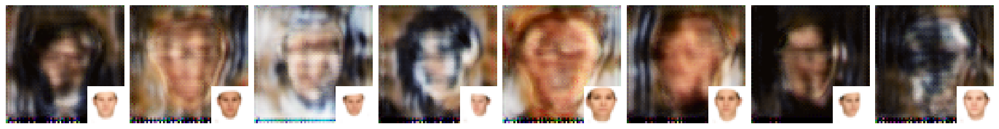

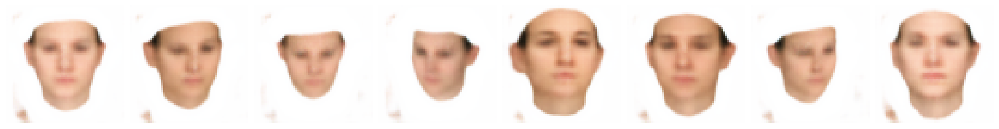

Iter: 10500; D loss: -517.5; G_loss: 1.654e+03; P_loss: 802.1


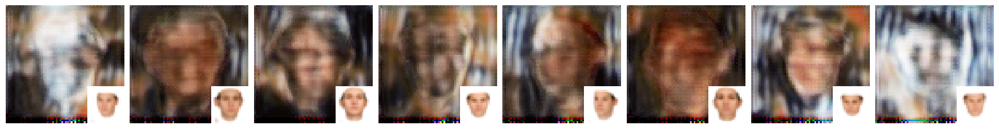

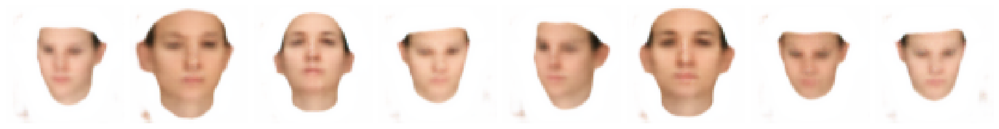

Iter: 10600; D loss: -535.9; G_loss: 1.361e+03; P_loss: 715.6


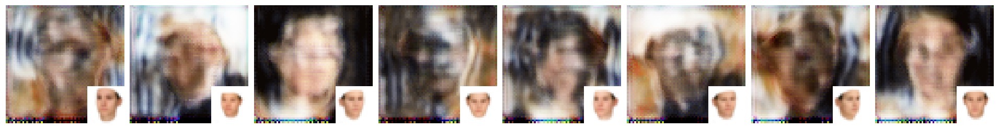

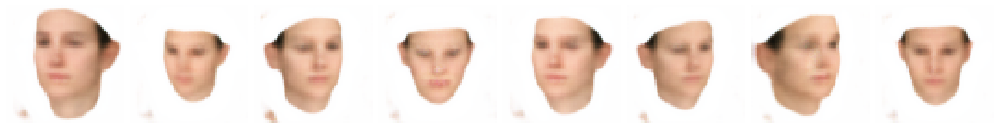

Iter: 10700; D loss: -515.2; G_loss: 1.665e+03; P_loss: 727.1


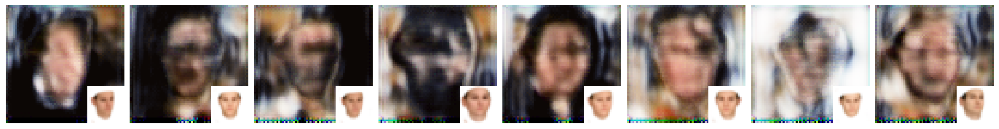

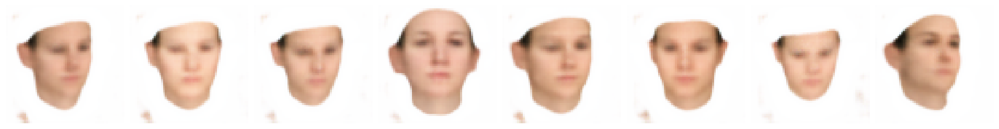

Iter: 10800; D loss: -548.3; G_loss: 1.448e+03; P_loss: 699.0


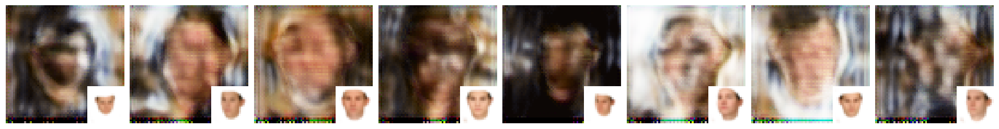

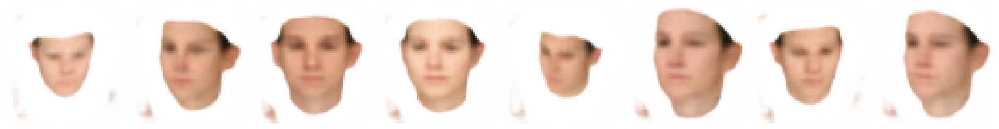

Iter: 10900; D loss: -562.8; G_loss: 1.658e+03; P_loss: 738.3


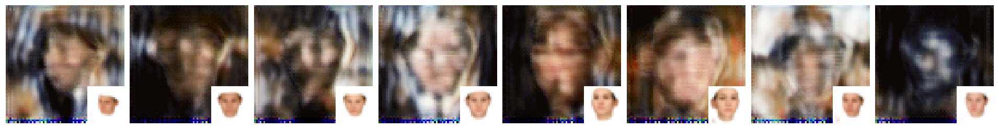

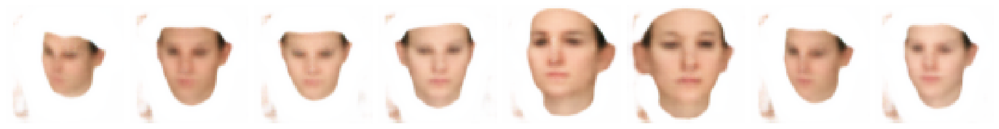

Iter: 11000; D loss: -501.3; G_loss: 1.756e+03; P_loss: 775.6


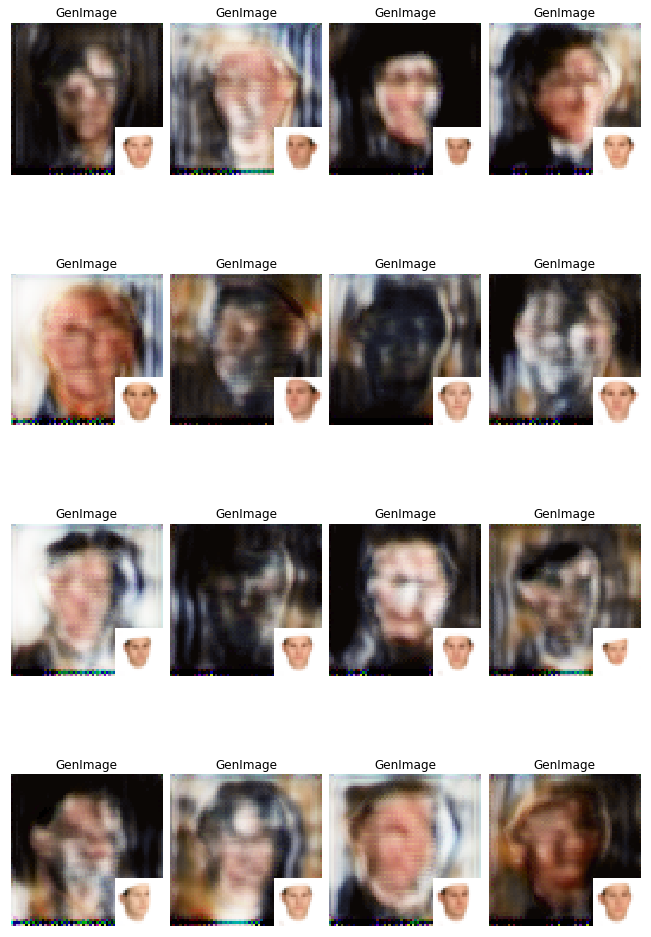

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 11100; D loss: -464.6; G_loss: 1.439e+03; P_loss: 790.3


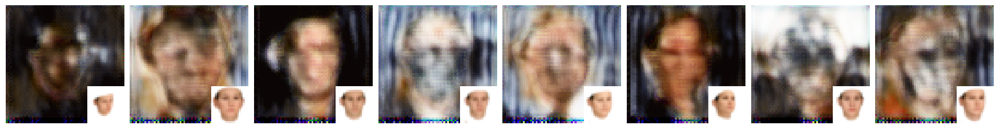

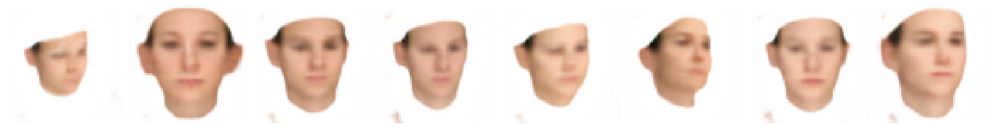

Iter: 11200; D loss: -541.8; G_loss: 1.445e+03; P_loss: 741.4


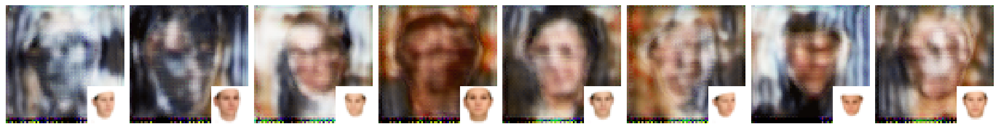

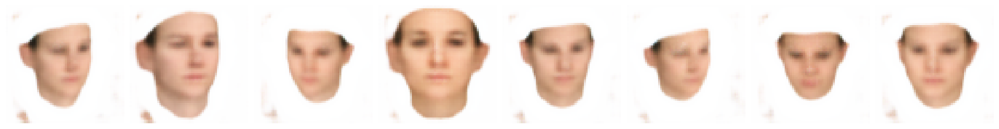

Iter: 11300; D loss: -447.8; G_loss: 1.336e+03; P_loss: 783.4


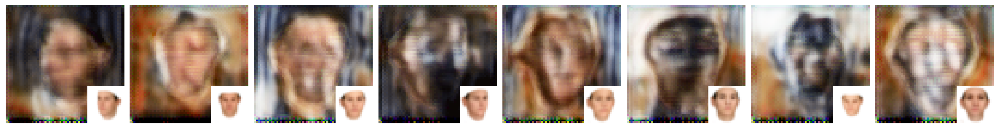

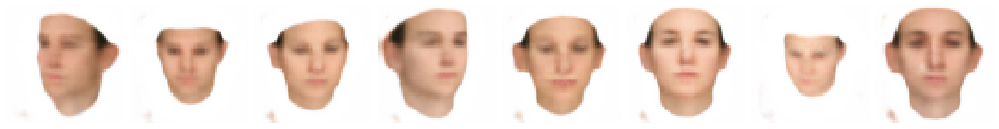

Iter: 11400; D loss: -547.8; G_loss: 1.512e+03; P_loss: 739.7


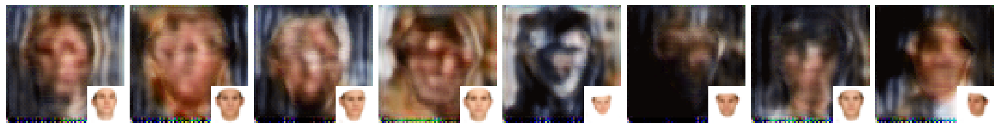

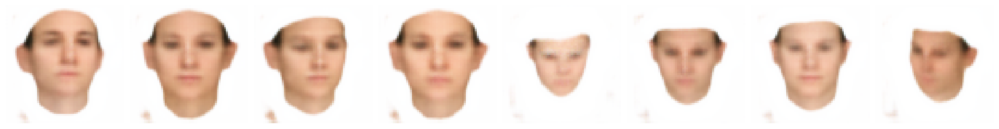

Iter: 11500; D loss: -518.7; G_loss: 1.464e+03; P_loss: 705.2


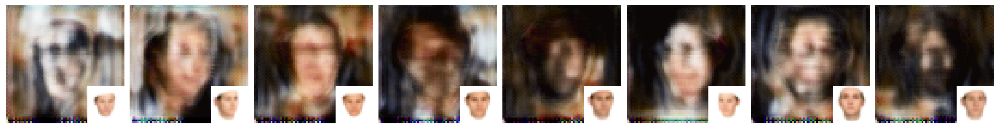

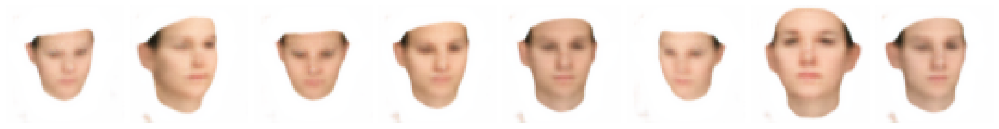

Iter: 11600; D loss: -470.2; G_loss: 1.736e+03; P_loss: 735.9


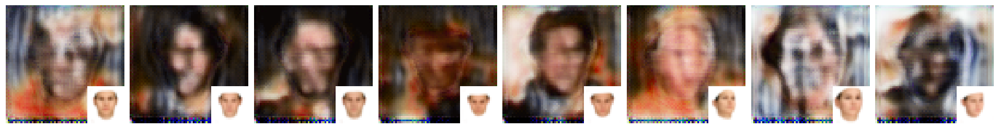

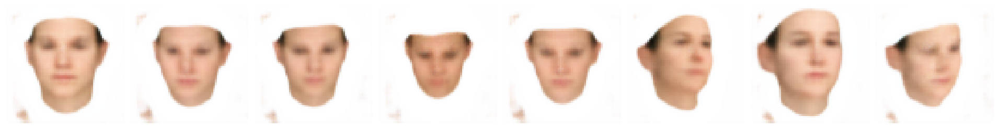

Iter: 11700; D loss: -516.6; G_loss: 1.508e+03; P_loss: 675.2


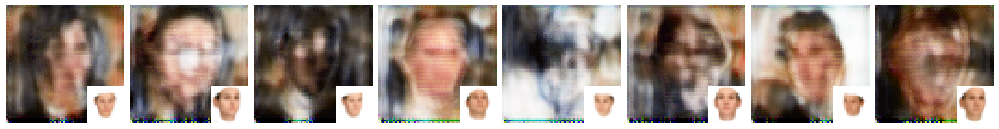

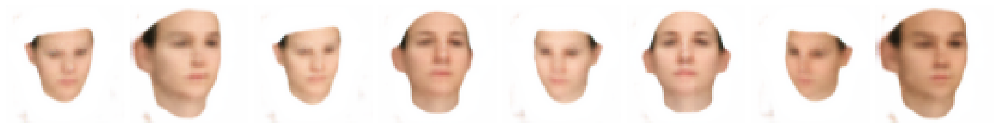

Iter: 11800; D loss: -532.9; G_loss: 1.408e+03; P_loss: 734.8


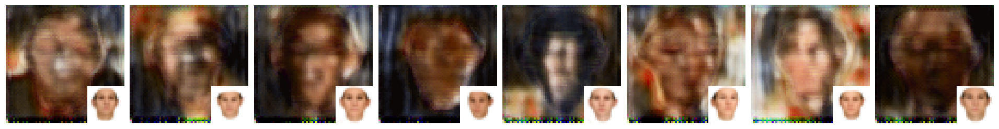

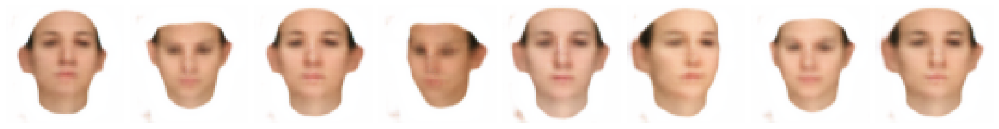

Iter: 11900; D loss: -644.6; G_loss: 1.46e+03; P_loss: 711.7


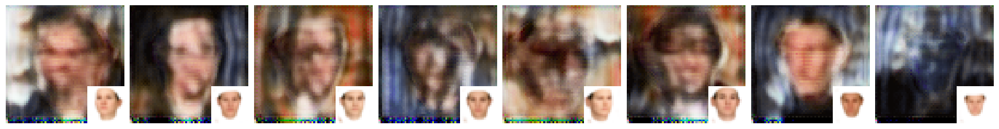

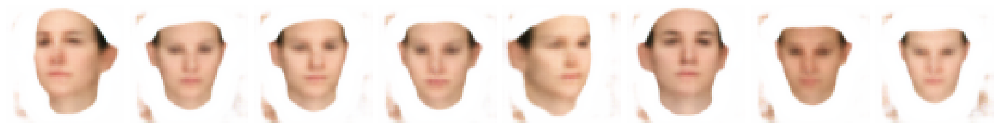

Iter: 12000; D loss: -482.3; G_loss: 1.571e+03; P_loss: 706.9


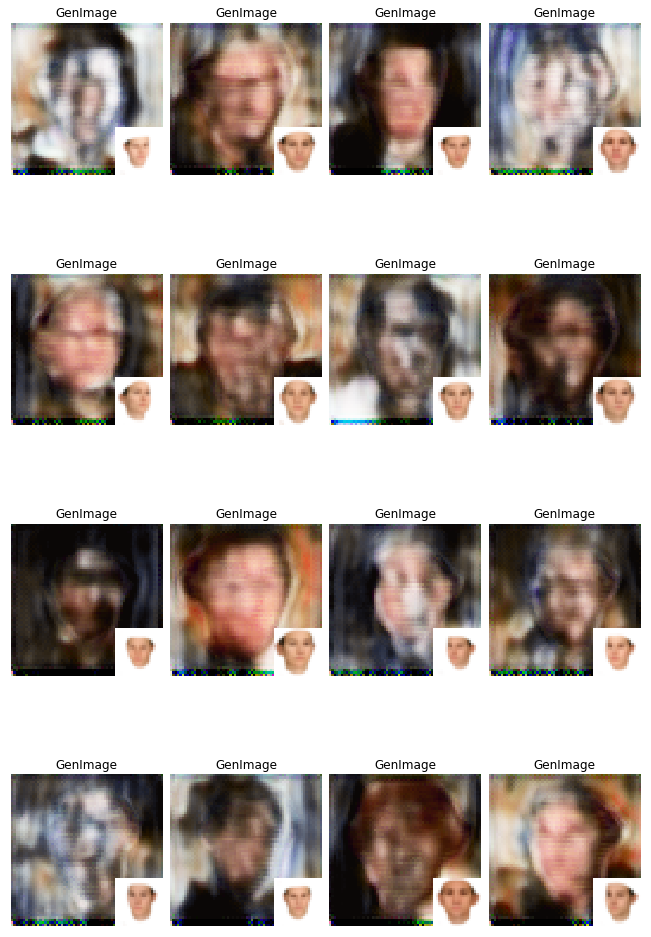

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 12100; D loss: -504.4; G_loss: 1.413e+03; P_loss: 717.2


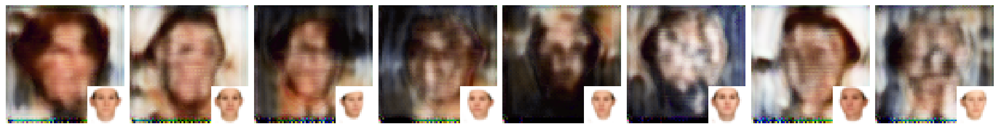

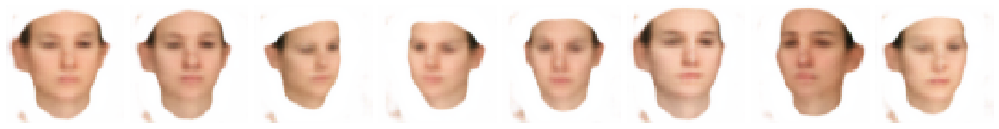

Iter: 12200; D loss: -623.2; G_loss: 1.313e+03; P_loss: 670.5


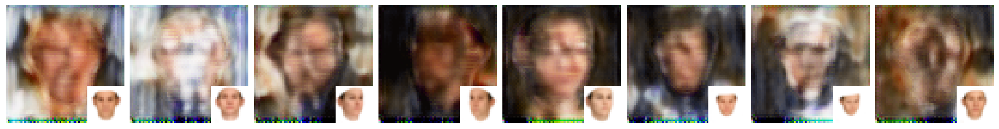

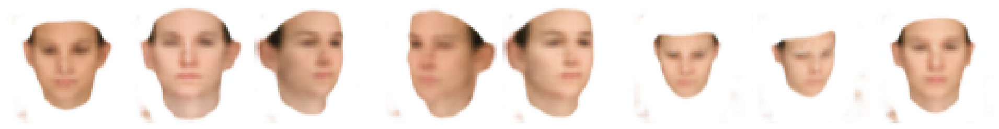

Iter: 12300; D loss: -599.3; G_loss: 1.196e+03; P_loss: 710.6


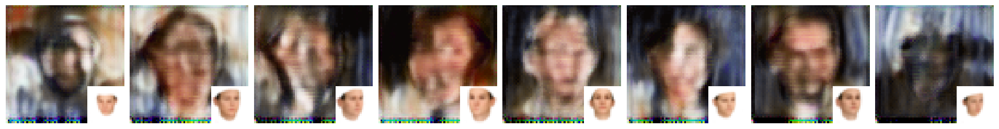

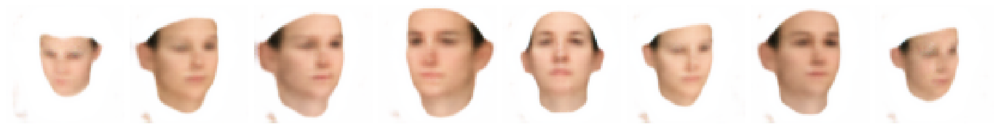

Iter: 12400; D loss: -570.8; G_loss: 1.302e+03; P_loss: 716.0


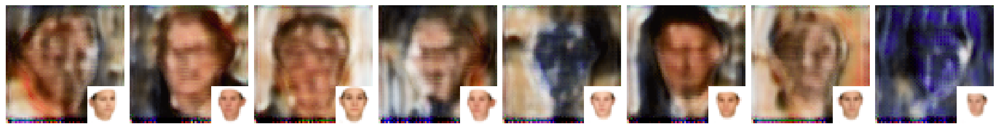

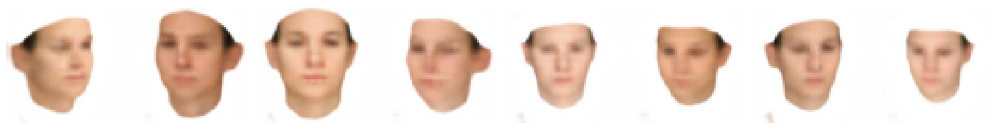

Iter: 12500; D loss: -485.2; G_loss: 1.41e+03; P_loss: 734.5


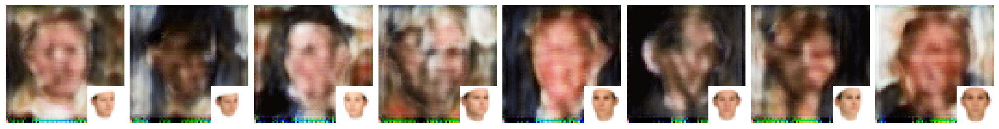

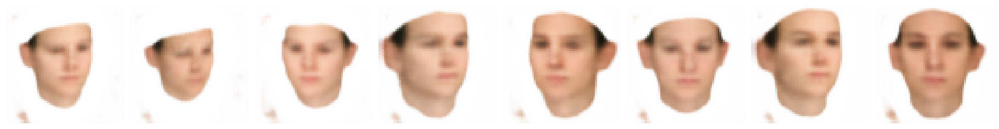

Iter: 12600; D loss: -540.6; G_loss: 1.557e+03; P_loss: 717.3


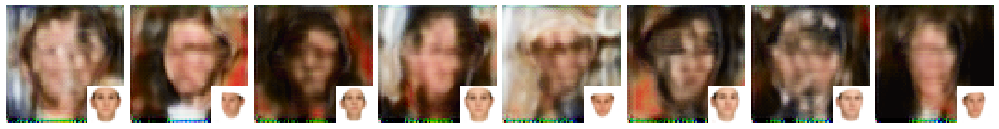

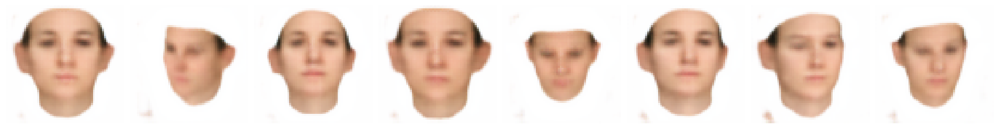

Iter: 12700; D loss: -594.2; G_loss: 1.414e+03; P_loss: 755.9


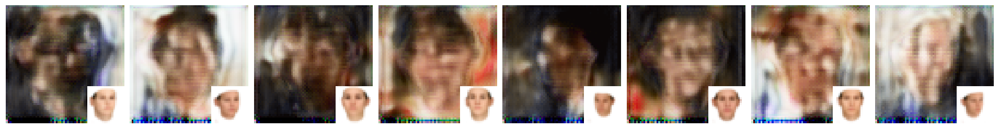

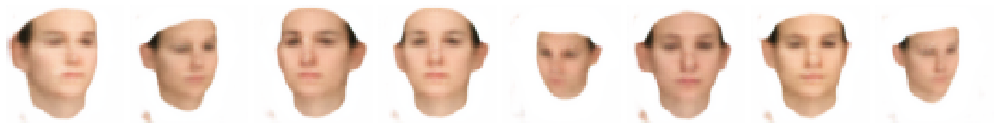

Iter: 12800; D loss: -582.0; G_loss: 1.573e+03; P_loss: 681.8


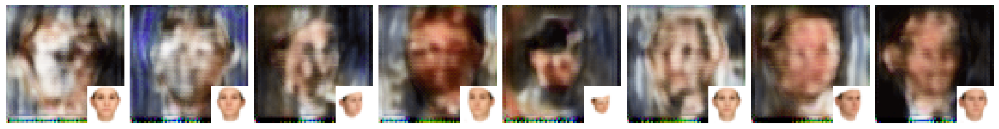

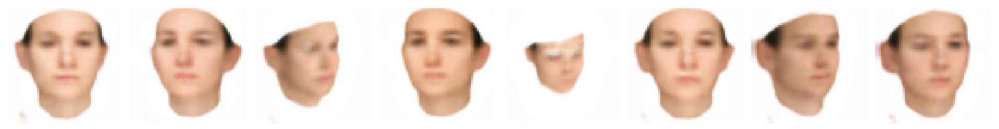

Iter: 12900; D loss: -565.7; G_loss: 1.657e+03; P_loss: 718.1


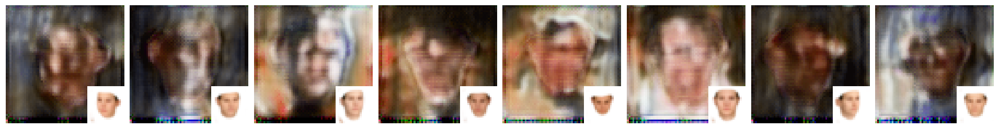

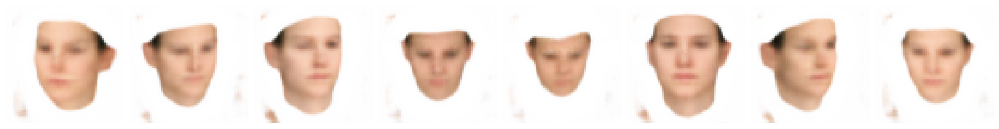

Iter: 13000; D loss: -626.2; G_loss: 1.621e+03; P_loss: 713.8


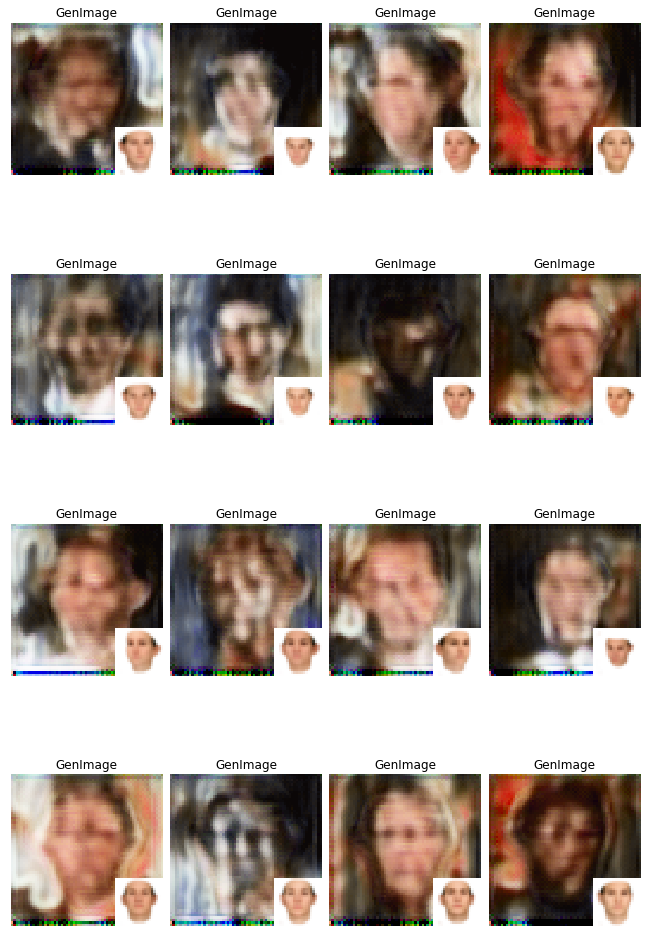

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 13100; D loss: -500.5; G_loss: 1.92e+03; P_loss: 717.4


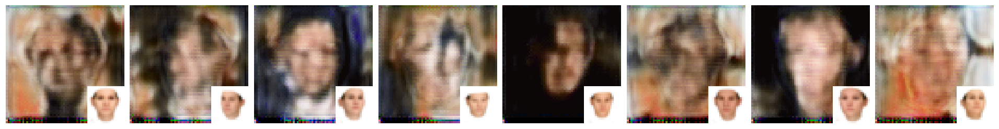

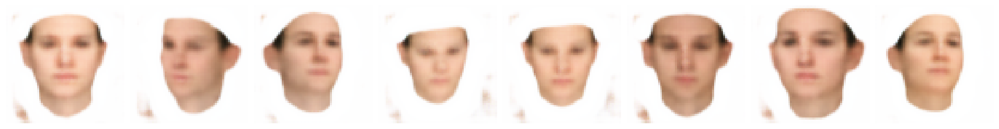

Iter: 13200; D loss: -614.1; G_loss: 1.882e+03; P_loss: 693.5


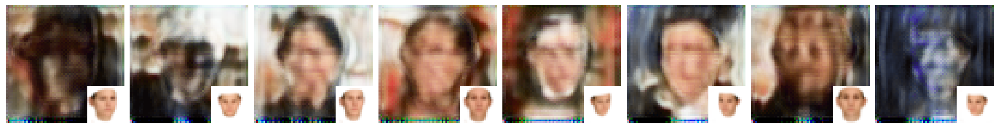

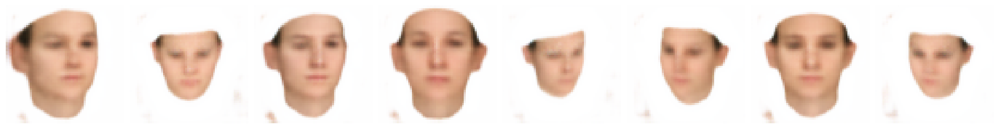

Iter: 13300; D loss: -688.1; G_loss: 2.127e+03; P_loss: 707.5


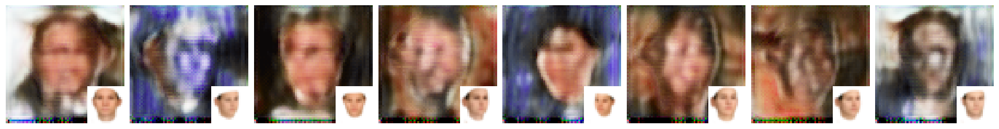

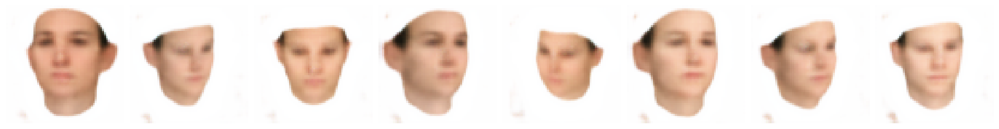

Iter: 13400; D loss: -593.1; G_loss: 1.962e+03; P_loss: 726.6


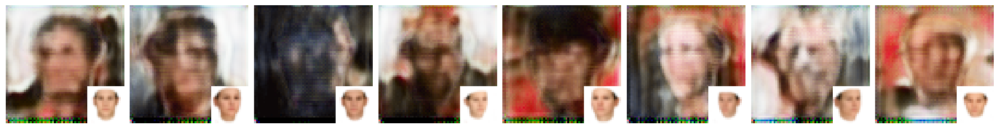

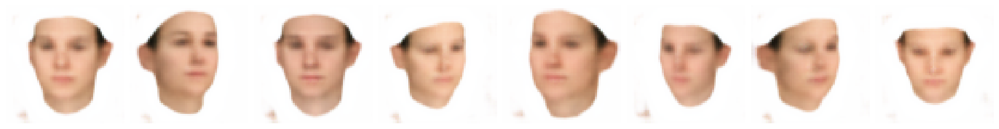

Iter: 13500; D loss: -532.3; G_loss: 2.094e+03; P_loss: 737.5


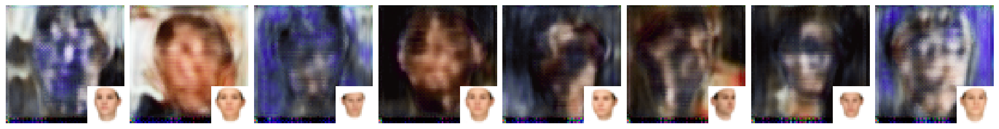

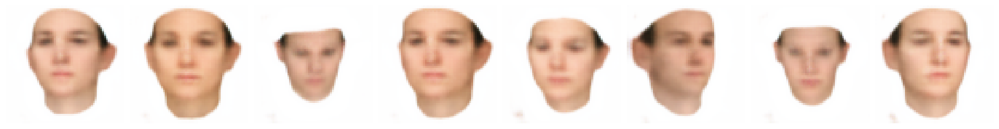

Iter: 13600; D loss: -539.2; G_loss: 1.634e+03; P_loss: 691.4


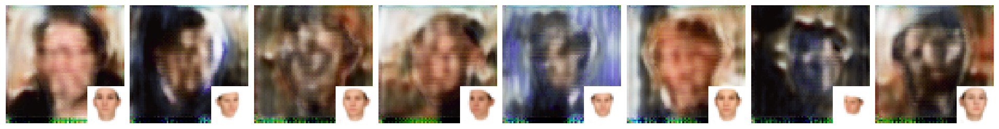

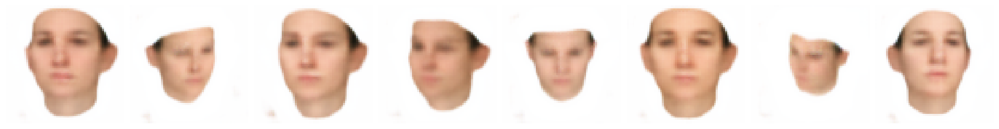

Iter: 13700; D loss: -547.1; G_loss: 1.852e+03; P_loss: 689.4


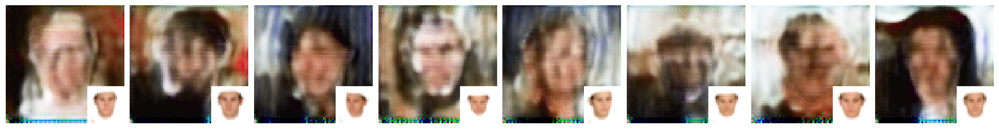

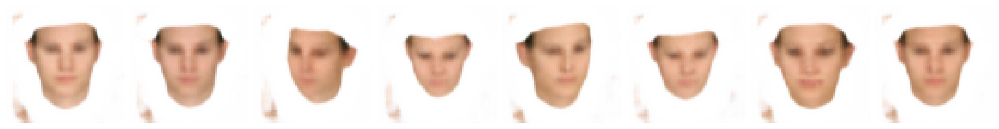

Iter: 13800; D loss: -681.1; G_loss: 1.589e+03; P_loss: 685.3


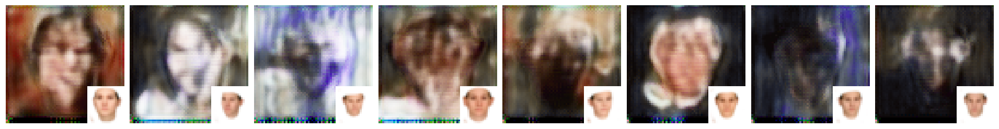

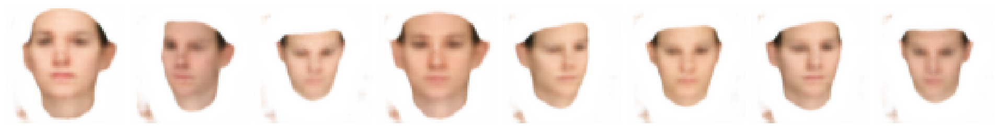

Iter: 13900; D loss: -610.5; G_loss: 1.933e+03; P_loss: 687.7


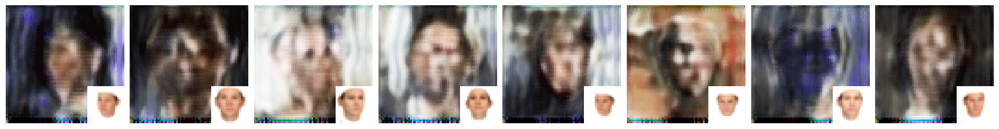

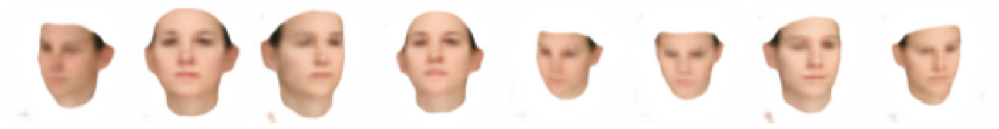

Iter: 14000; D loss: -611.5; G_loss: 1.705e+03; P_loss: 669.8


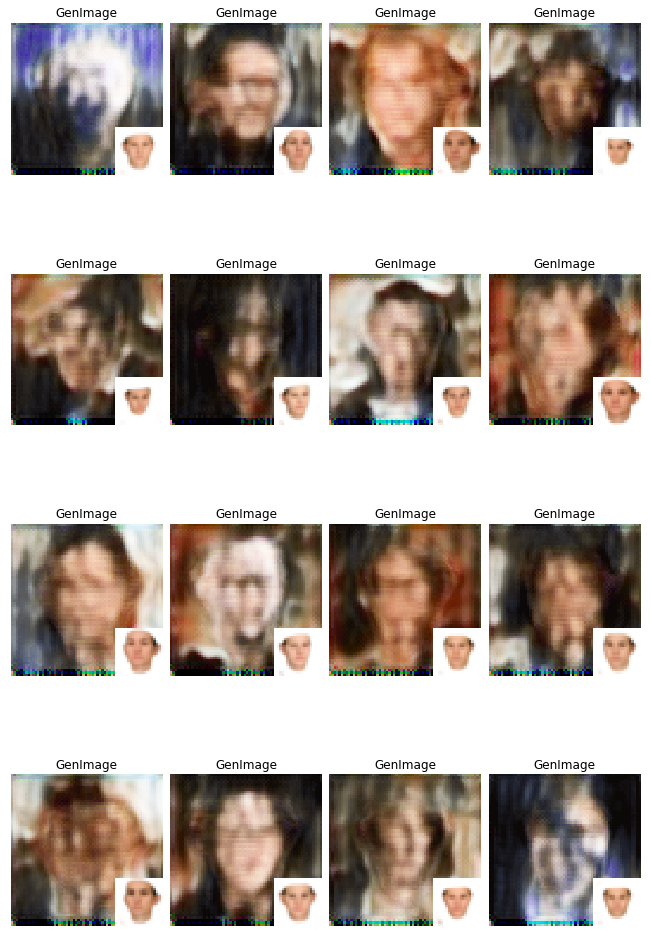

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 14100; D loss: -5.231; G_loss: 1.258e+03; P_loss: 943.7


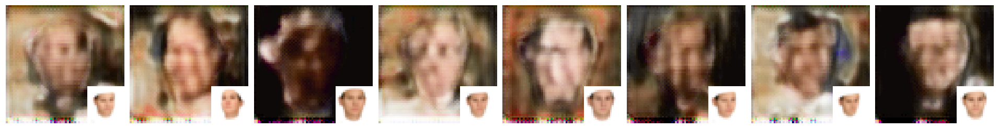

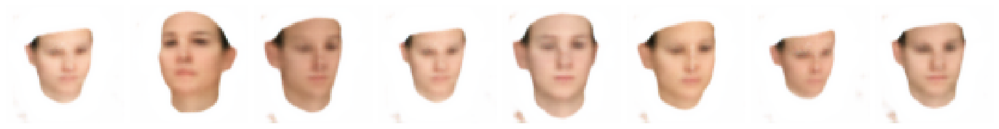

Iter: 14200; D loss: -96.38; G_loss: 1.721e+03; P_loss: 1.034e+03


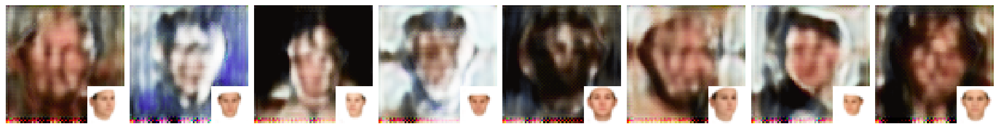

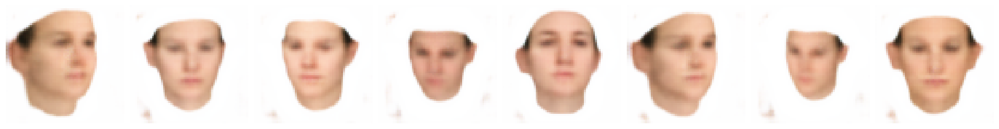

Iter: 14300; D loss: -79.3; G_loss: 1.521e+03; P_loss: 916.4


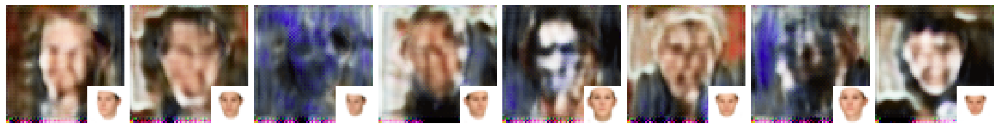

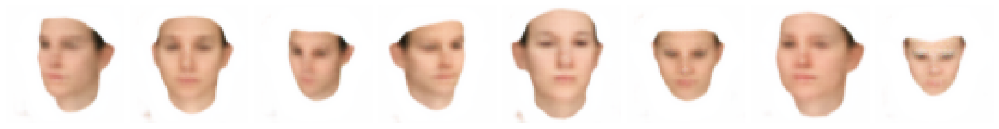

Iter: 14400; D loss: -74.21; G_loss: 1.116e+03; P_loss: 801.5


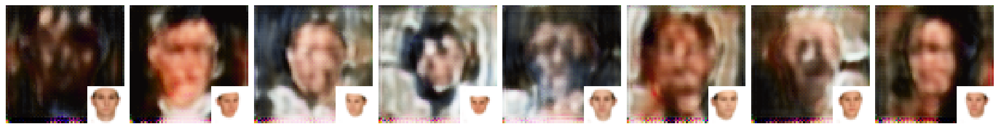

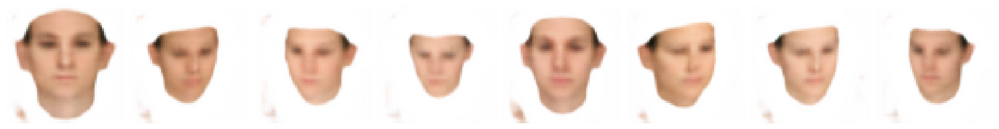

Iter: 14500; D loss: -83.34; G_loss: 846.1; P_loss: 820.8


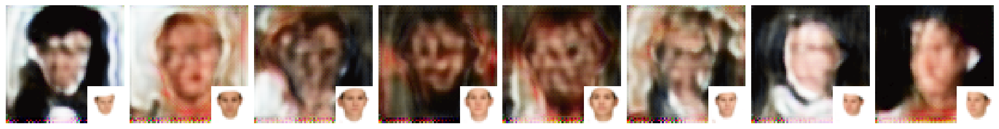

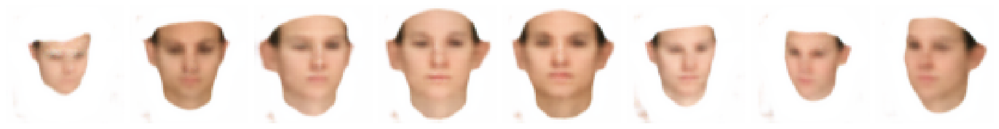

Iter: 14600; D loss: -61.61; G_loss: 986.2; P_loss: 771.2


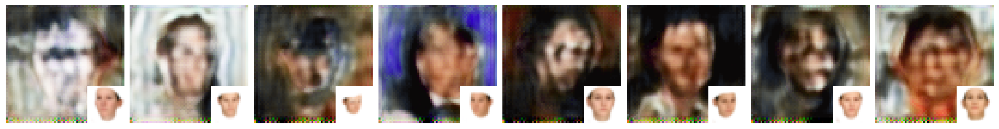

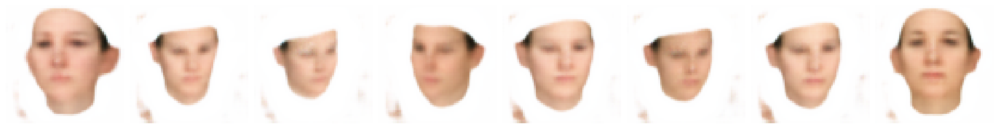

Iter: 14700; D loss: -89.39; G_loss: 1.053e+03; P_loss: 855.1


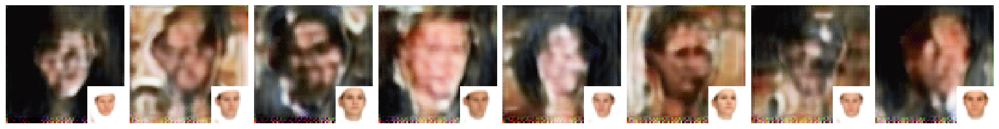

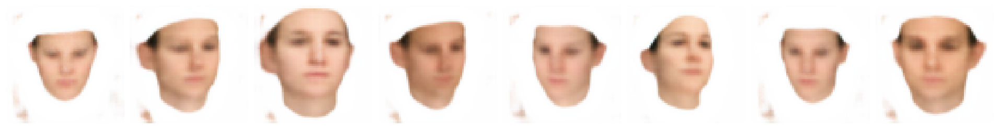

Iter: 14800; D loss: -67.26; G_loss: 1.336e+03; P_loss: 802.6


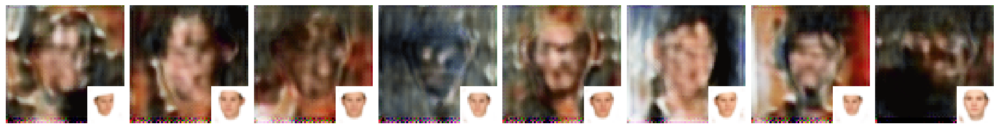

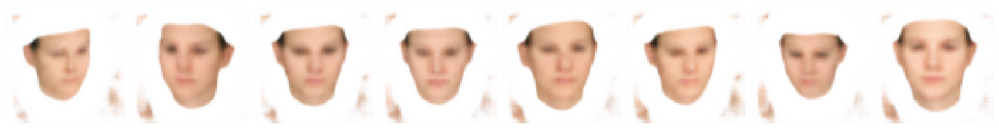

Iter: 14900; D loss: -27.63; G_loss: 968.7; P_loss: 732.1


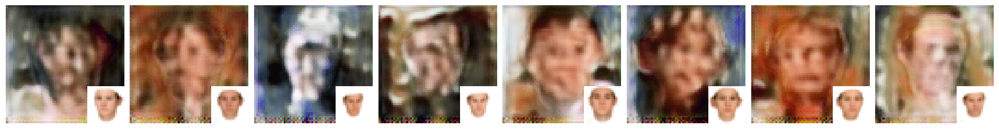

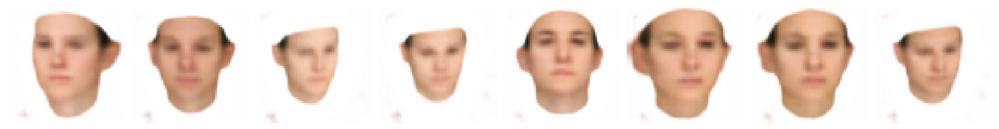

Iter: 15000; D loss: -57.39; G_loss: 985.1; P_loss: 749.9


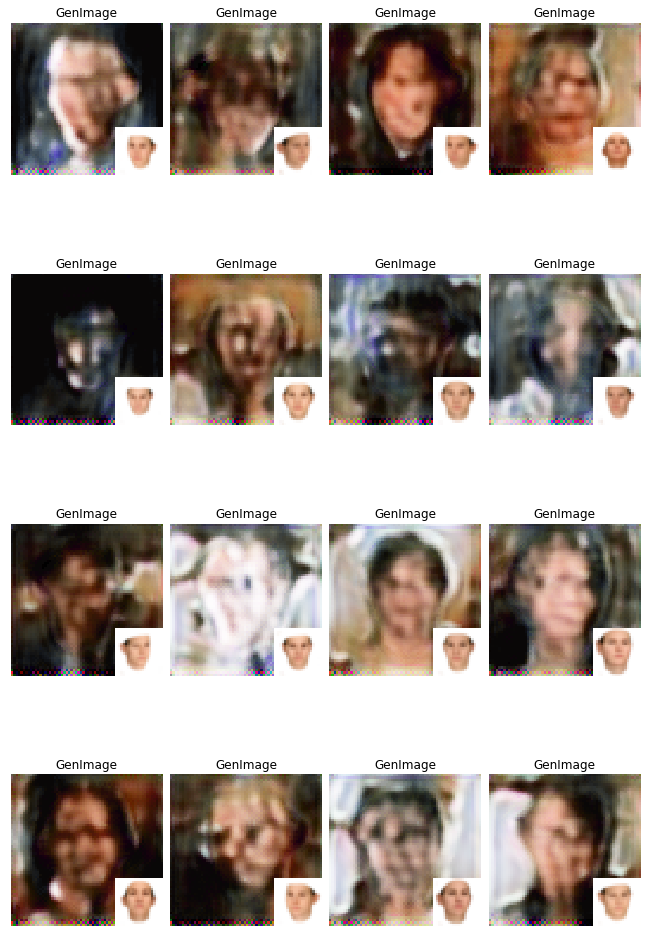

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 15100; D loss: -69.52; G_loss: 952.0; P_loss: 740.0


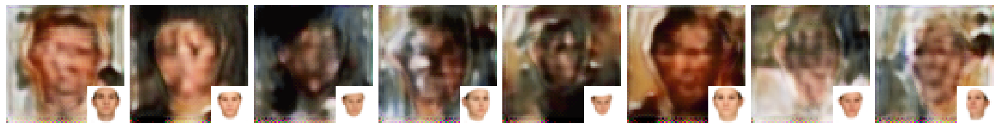

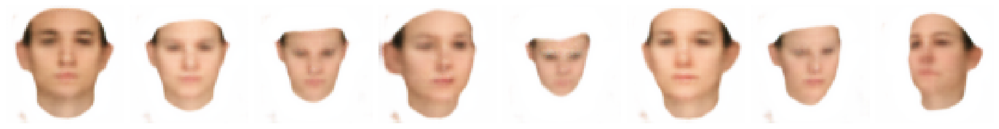

Iter: 15200; D loss: -36.23; G_loss: 902.3; P_loss: 750.3


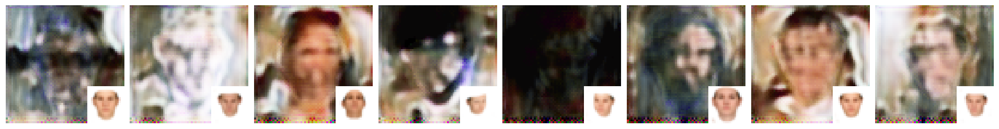

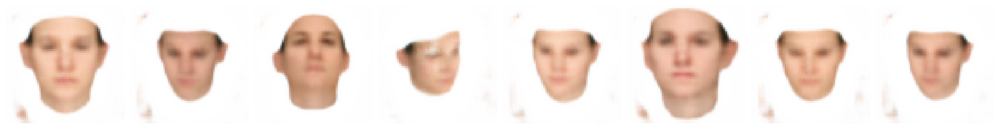

Iter: 15300; D loss: -59.3; G_loss: 895.9; P_loss: 802.7


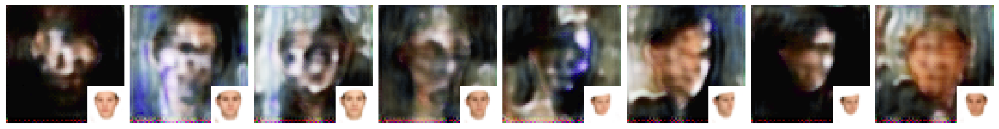

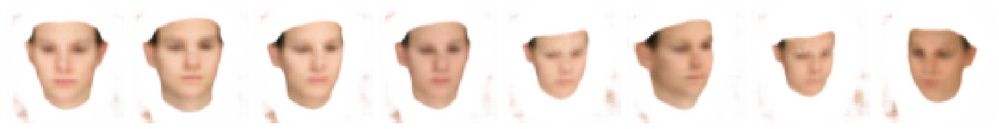

Iter: 15400; D loss: -65.05; G_loss: 864.7; P_loss: 721.2


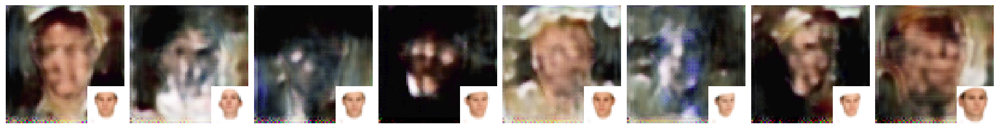

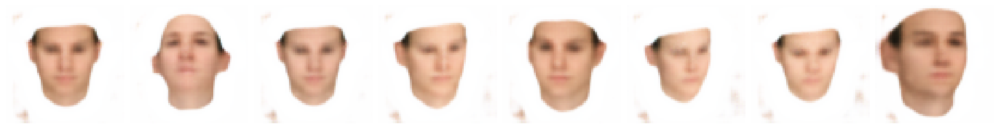

Iter: 15500; D loss: 26.33; G_loss: 645.2; P_loss: 691.4


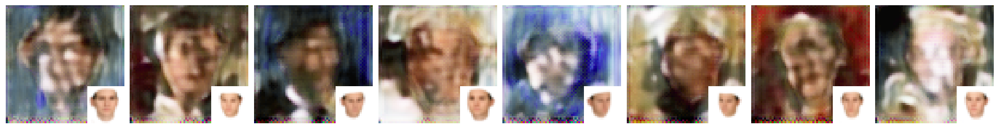

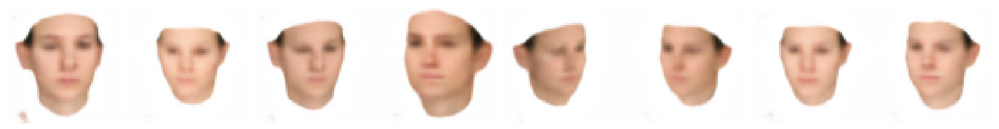

Iter: 15600; D loss: -81.97; G_loss: 713.1; P_loss: 771.5


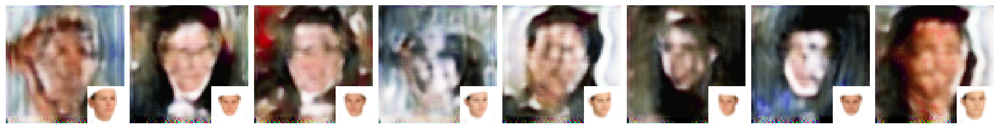

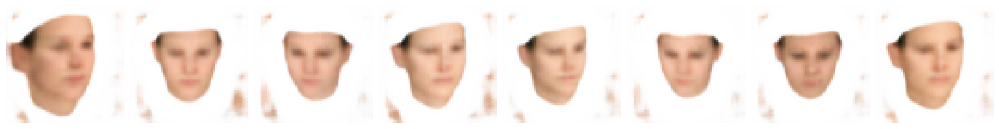

Iter: 15700; D loss: -126.9; G_loss: 880.5; P_loss: 730.6


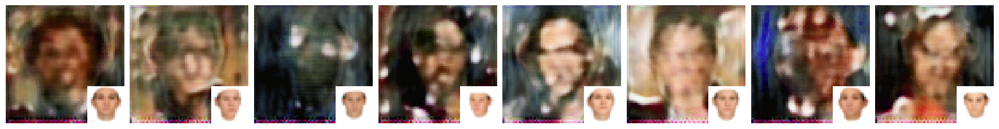

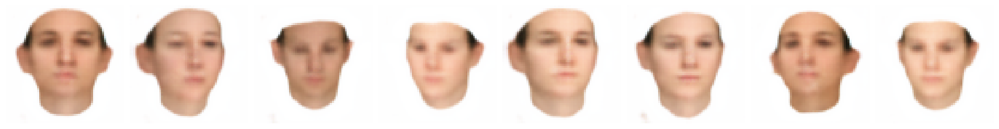

Iter: 15800; D loss: -75.59; G_loss: 805.2; P_loss: 700.2


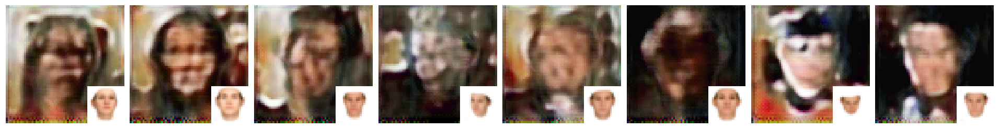

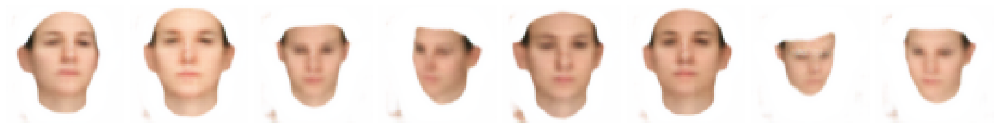

Iter: 15900; D loss: -156.5; G_loss: 1.264e+03; P_loss: 733.8


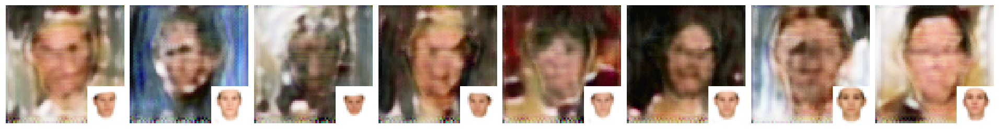

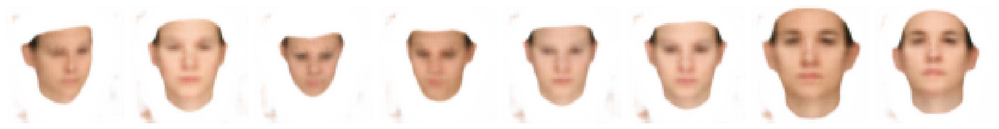

Iter: 16000; D loss: -96.42; G_loss: 935.6; P_loss: 638.1


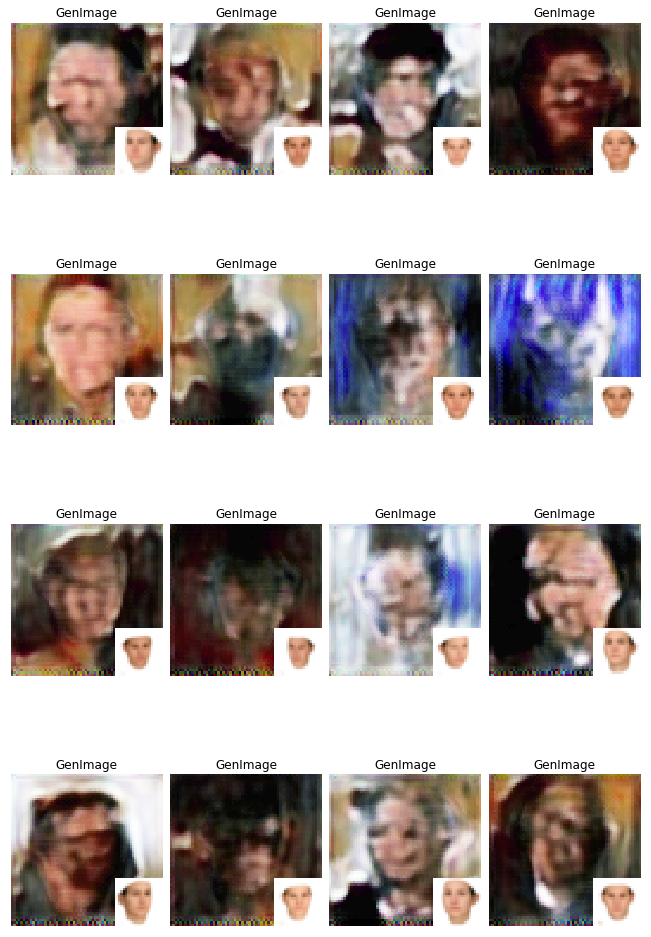

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 16100; D loss: -88.28; G_loss: 1.043e+03; P_loss: 711.1


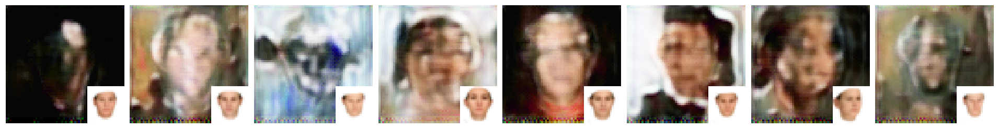

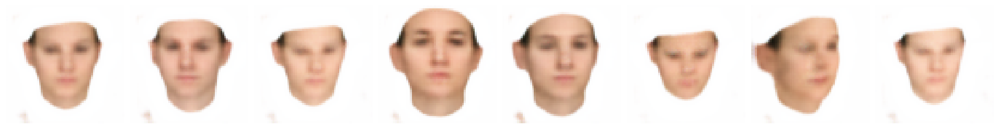

Iter: 16200; D loss: -52.69; G_loss: 945.5; P_loss: 706.2


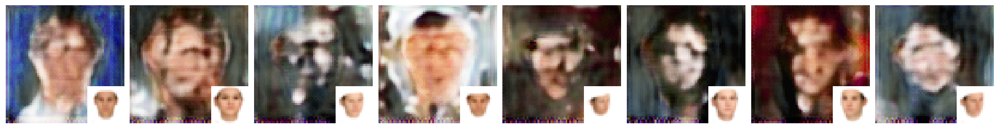

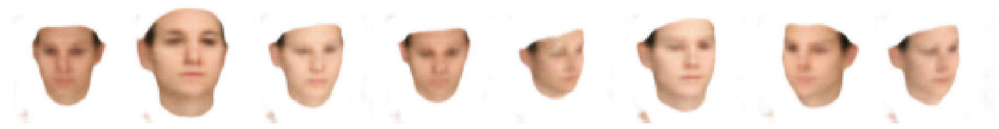

Iter: 16300; D loss: -1.126; G_loss: 857.3; P_loss: 727.4


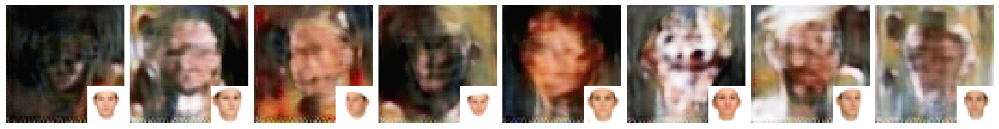

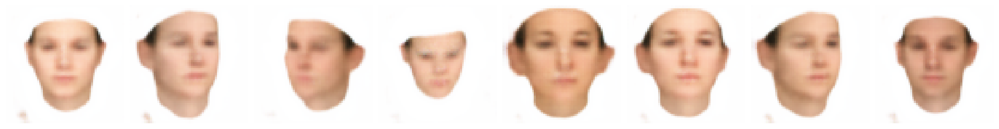

Iter: 16400; D loss: -86.99; G_loss: 593.1; P_loss: 705.0


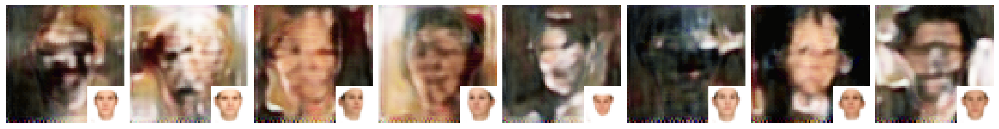

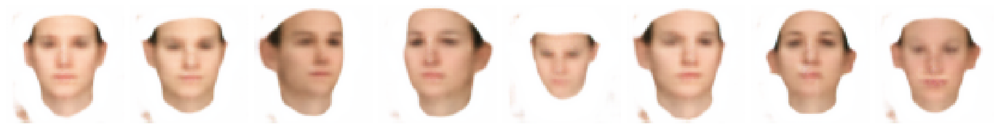

Iter: 16500; D loss: -83.18; G_loss: 814.4; P_loss: 709.3


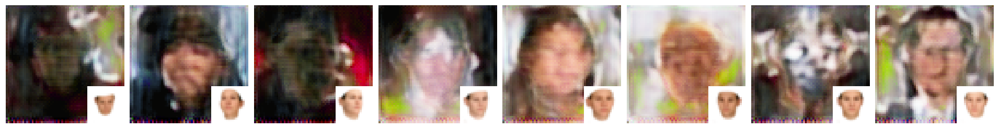

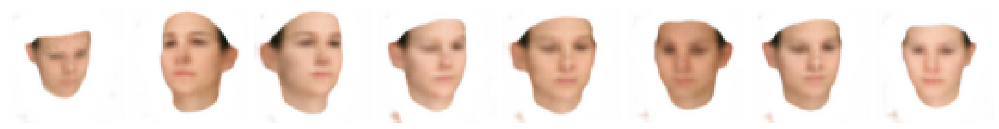

Iter: 16600; D loss: -69.06; G_loss: 1.026e+03; P_loss: 709.2


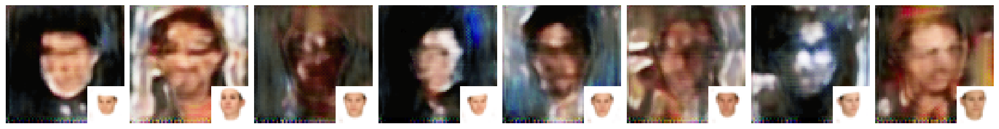

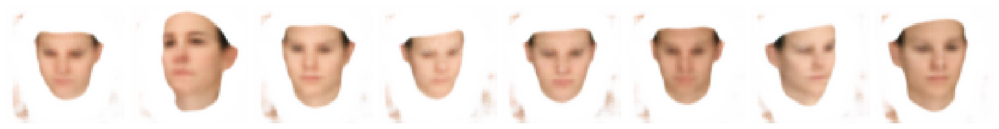

Iter: 16700; D loss: -113.9; G_loss: 655.8; P_loss: 750.3


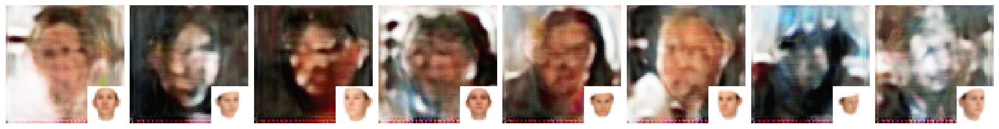

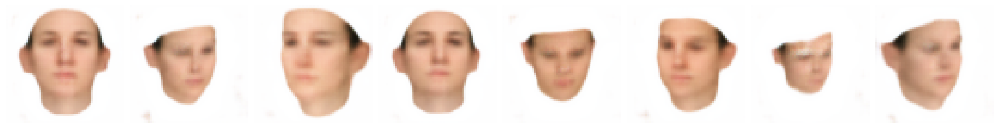

Iter: 16800; D loss: -51.09; G_loss: 776.0; P_loss: 719.6


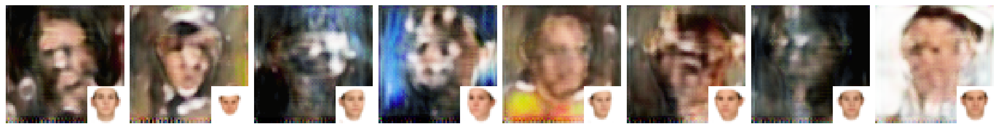

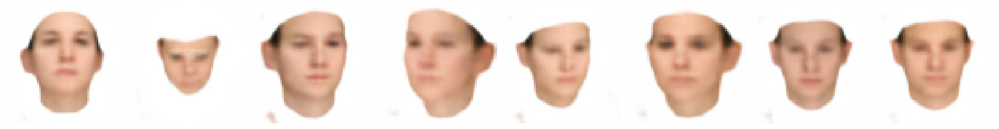

Iter: 16900; D loss: -88.41; G_loss: 543.4; P_loss: 676.6


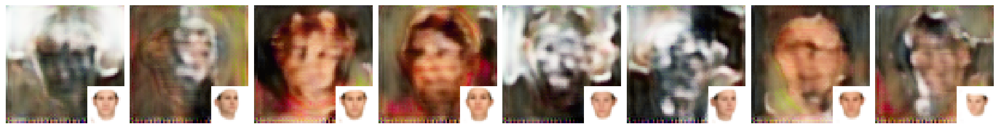

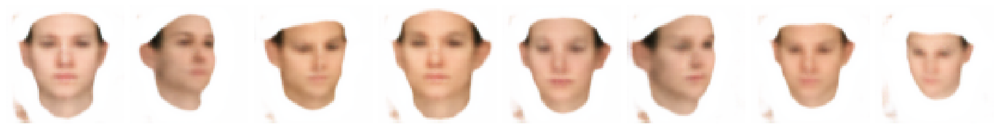

Iter: 17000; D loss: -90.44; G_loss: 686.4; P_loss: 677.7


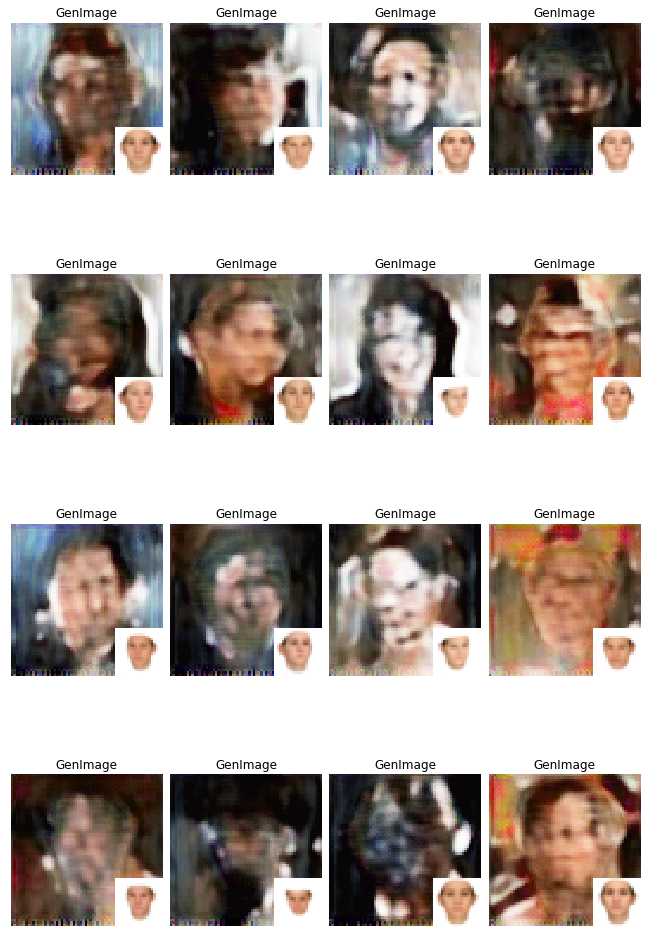

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 17100; D loss: -55.63; G_loss: 986.6; P_loss: 714.3


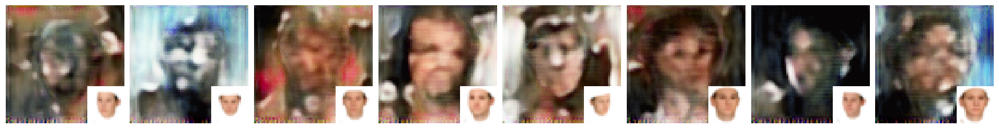

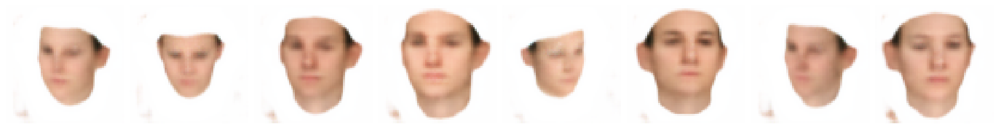

Iter: 17200; D loss: -72.5; G_loss: 706.3; P_loss: 701.1


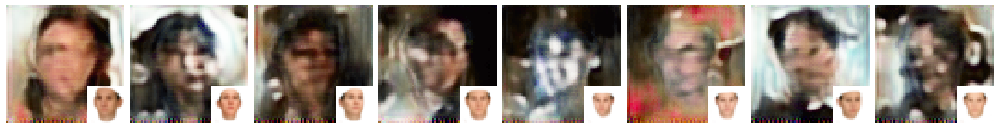

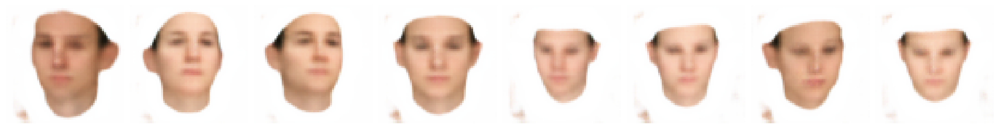

Iter: 17300; D loss: -115.1; G_loss: 642.3; P_loss: 710.8


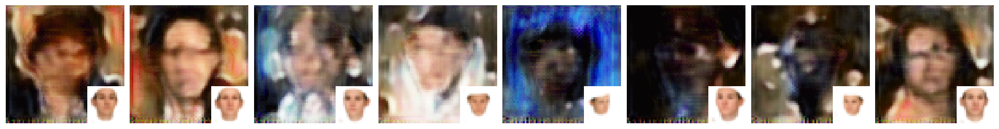

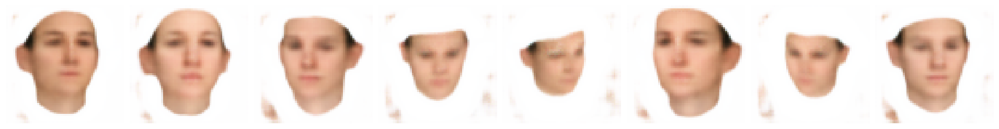

Iter: 17400; D loss: -78.89; G_loss: 619.0; P_loss: 699.1


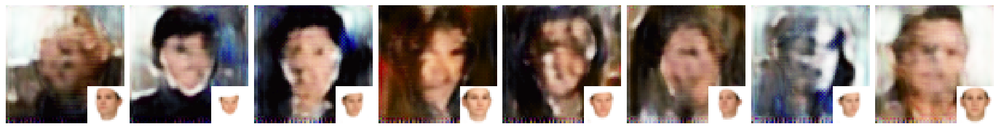

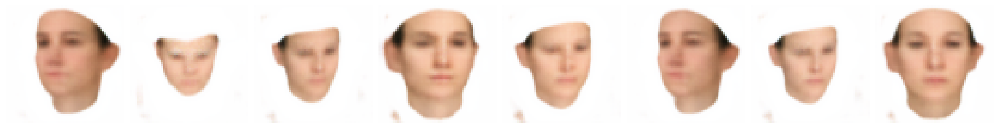

Iter: 17500; D loss: -68.67; G_loss: 725.5; P_loss: 733.4


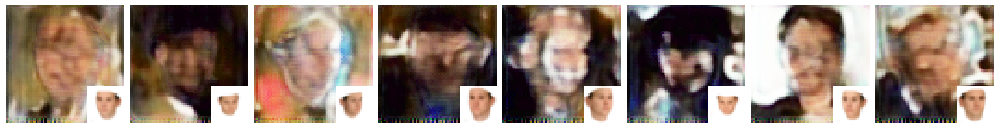

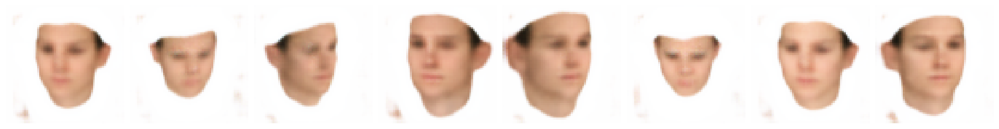

Iter: 17600; D loss: -64.98; G_loss: 798.8; P_loss: 702.6


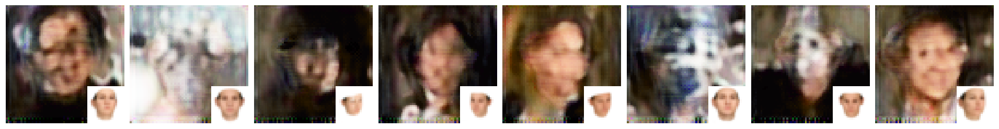

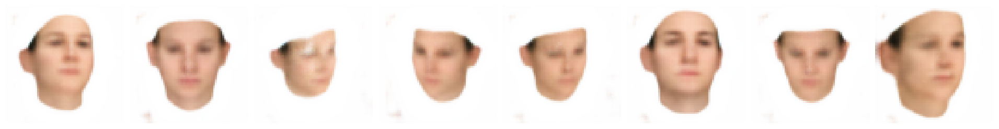

Iter: 17700; D loss: -81.03; G_loss: 648.3; P_loss: 635.0


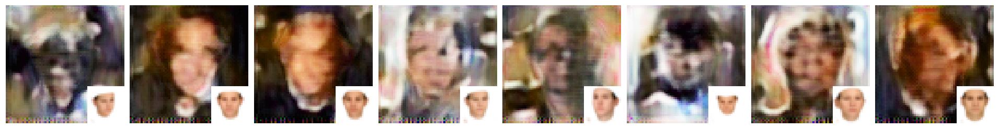

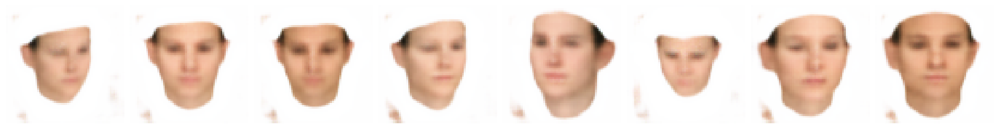

Iter: 17800; D loss: -16.09; G_loss: 844.8; P_loss: 726.3


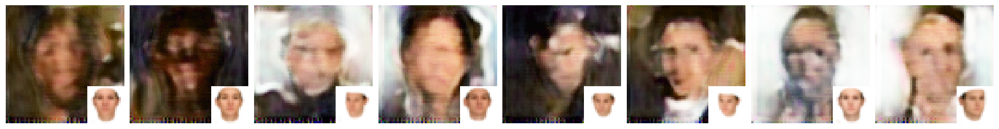

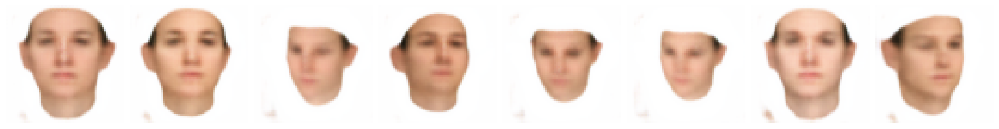

Iter: 17900; D loss: -54.46; G_loss: 795.4; P_loss: 658.3


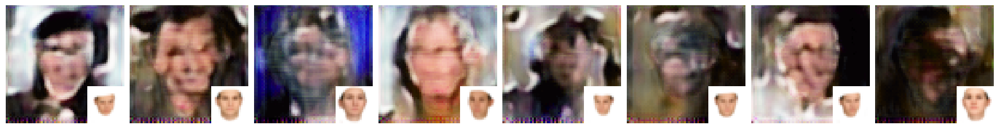

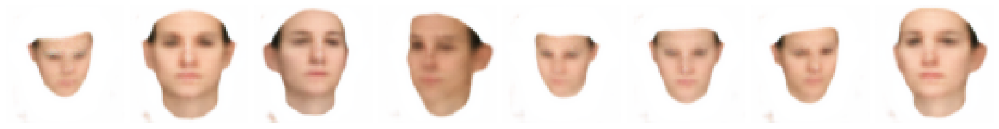

Iter: 18000; D loss: -22.38; G_loss: 741.8; P_loss: 702.8


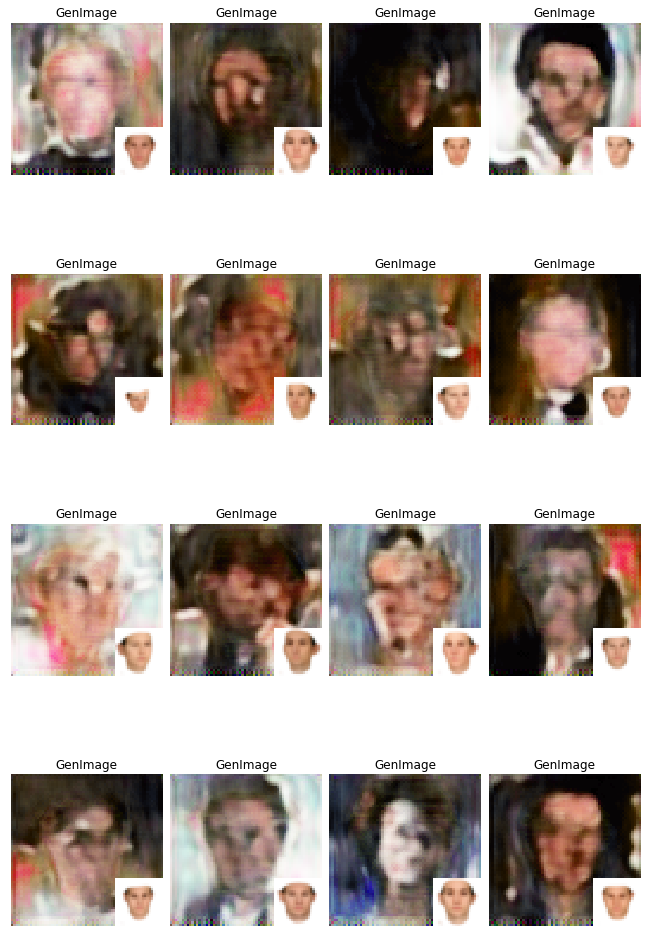

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 18100; D loss: -95.44; G_loss: 619.1; P_loss: 695.2


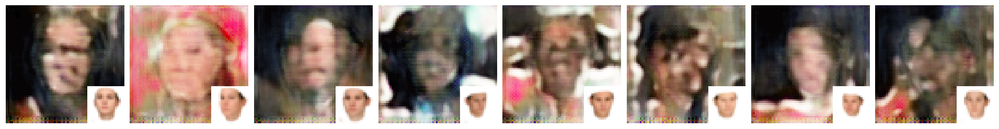

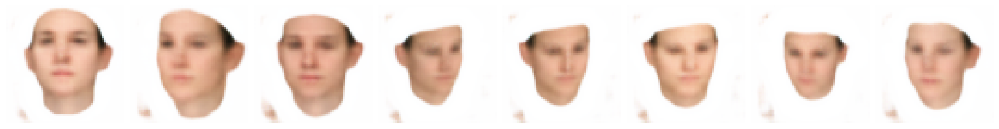

Iter: 18200; D loss: -51.96; G_loss: 641.7; P_loss: 670.4


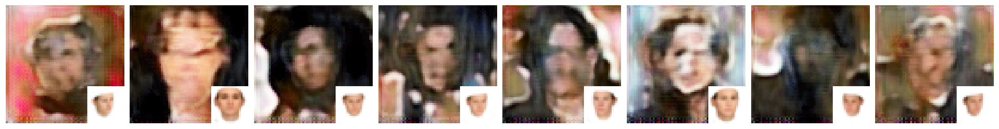

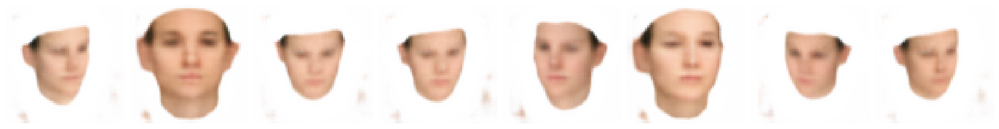

Iter: 18300; D loss: -96.13; G_loss: 693.4; P_loss: 732.2


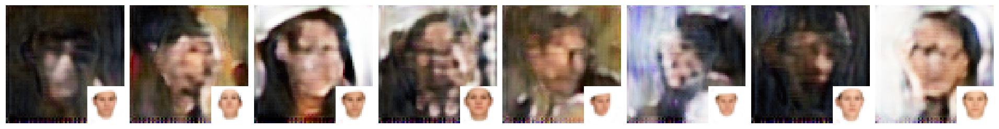

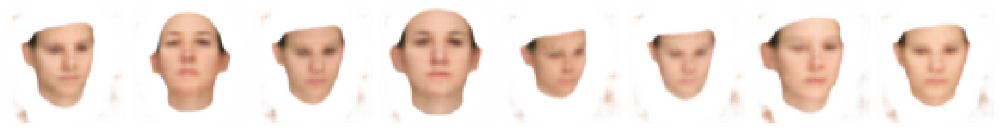

Iter: 18400; D loss: -54.49; G_loss: 531.7; P_loss: 684.6


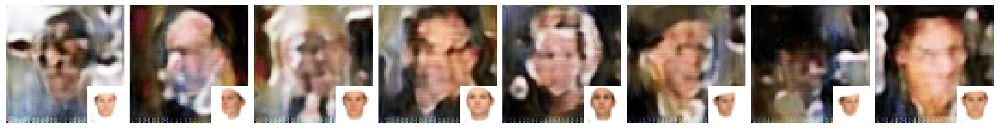

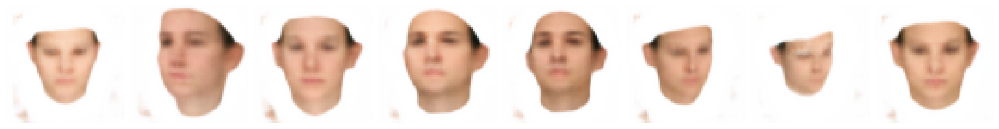

Iter: 18500; D loss: -92.56; G_loss: 491.2; P_loss: 671.5


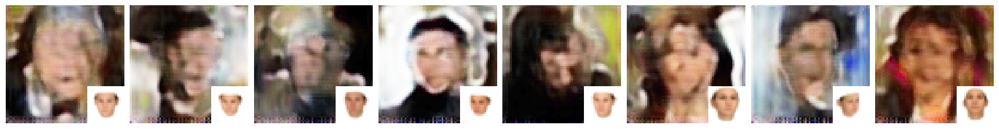

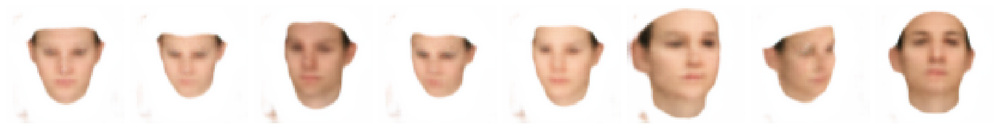

Iter: 18600; D loss: -50.78; G_loss: 549.7; P_loss: 645.3


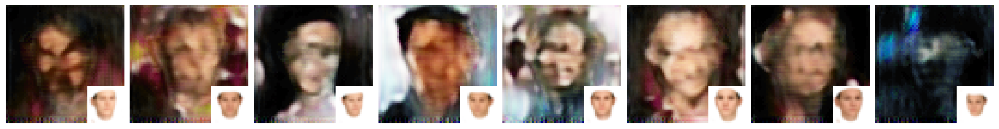

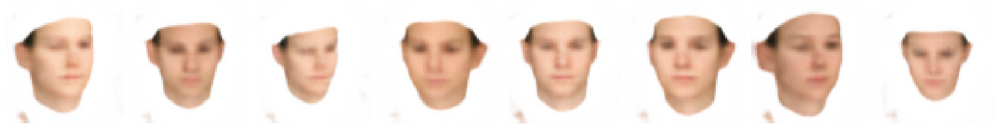

Iter: 18700; D loss: -77.43; G_loss: 529.9; P_loss: 669.6


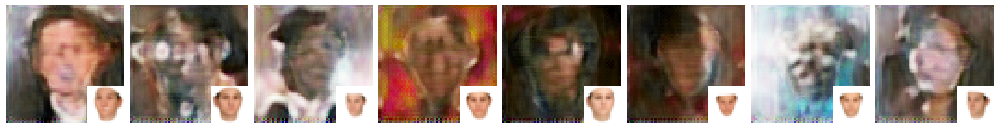

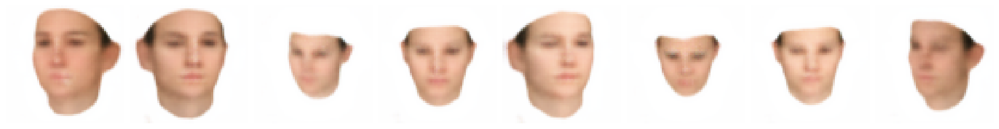

Iter: 18800; D loss: -55.47; G_loss: 780.9; P_loss: 693.3


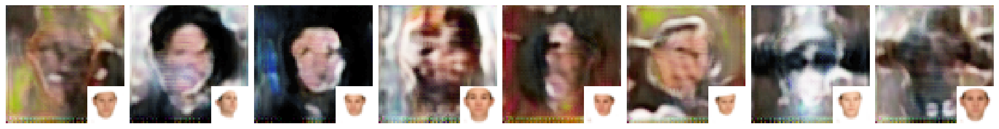

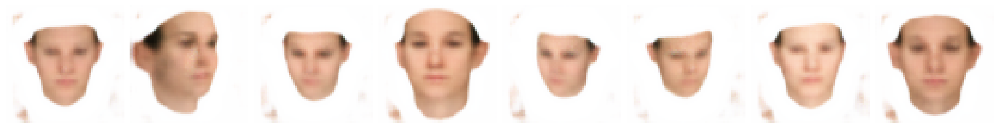

Iter: 18900; D loss: -69.41; G_loss: 621.5; P_loss: 656.8


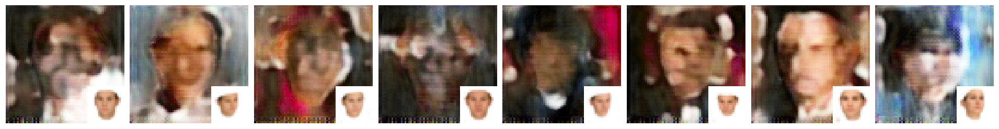

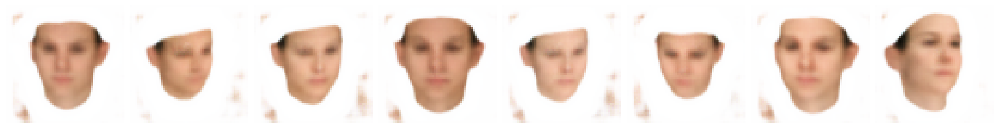

Iter: 19000; D loss: -75.72; G_loss: 571.4; P_loss: 691.7


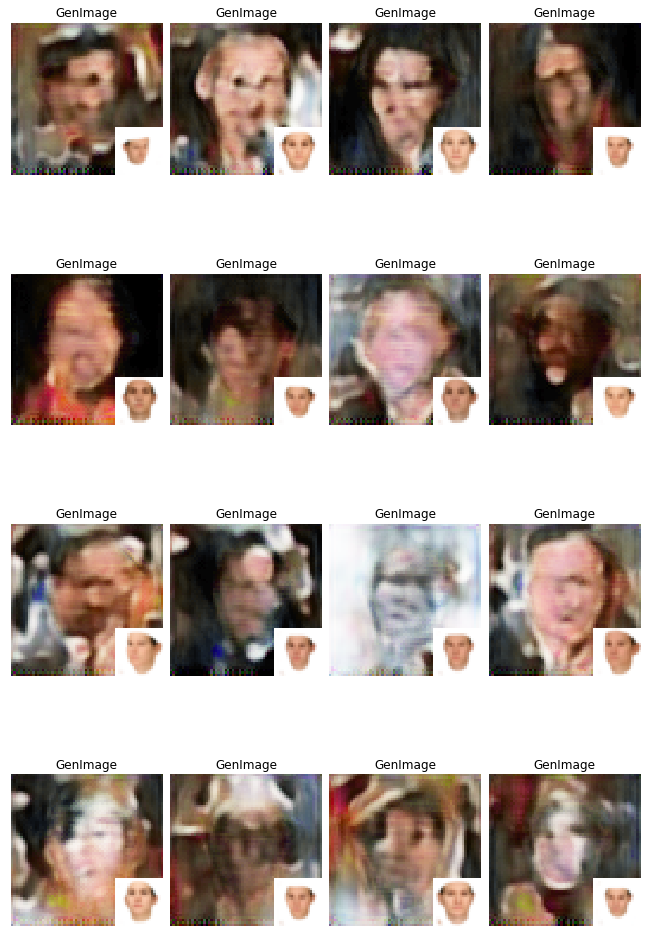

Model saved in file: checkpoints-celeba/all/model-celeba
Iter: 19100; D loss: -54.57; G_loss: 522.2; P_loss: 603.8


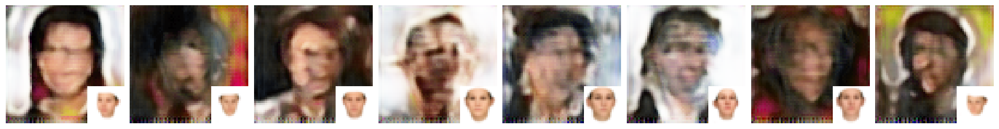

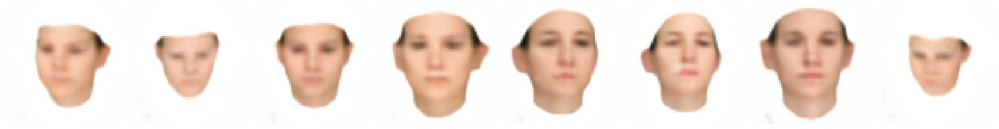

Iter: 19200; D loss: -71.44; G_loss: 436.5; P_loss: 661.0


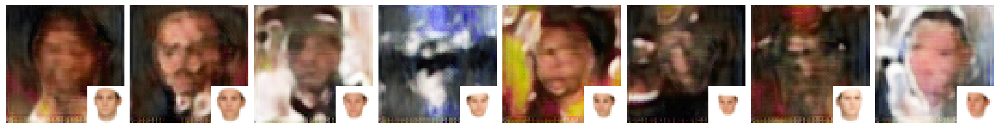

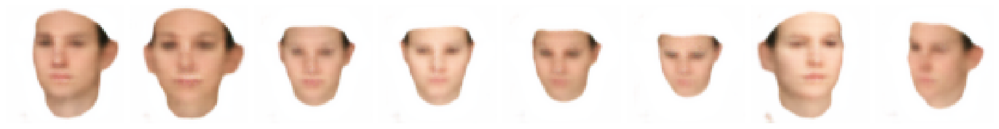

Iter: 19300; D loss: -55.37; G_loss: 563.7; P_loss: 618.8


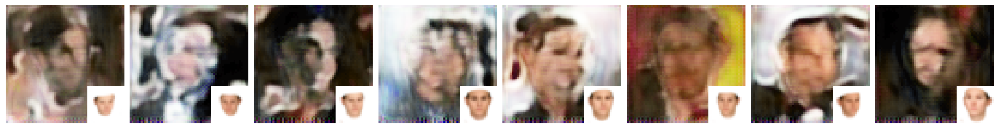

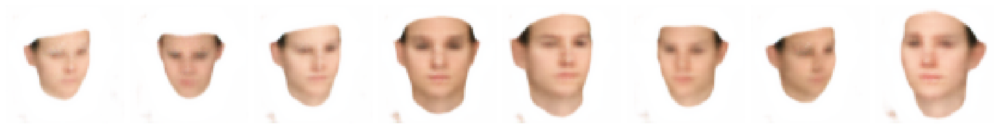

Iter: 19400; D loss: 14.48; G_loss: 478.0; P_loss: 620.8


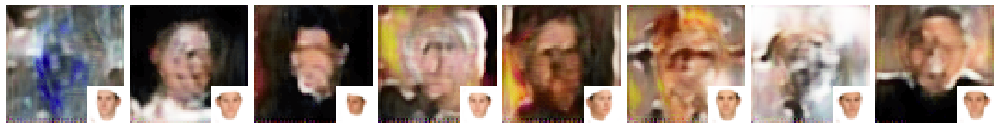

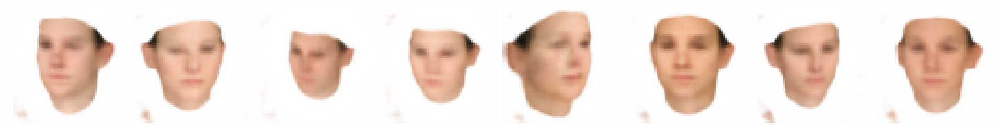

In [ ]:
i = 0
d_costs = []
g_costs = []
for it in range(100000):
    for q in range(3): #train discriminator
        Xdata = getImageBatch()
        z = sample_z(batch_size)
        z_im = sample_z(batch_size)
        _, D_loss_curr = sess.run(
            [D_solver, D_loss],
            feed_dict={X: Xdata,Z_params:z,Z_image:z_im}
        )
        d_costs.append(D_loss_curr)
    #trainGenerator 
    z = sample_z(batch_size) 
    z_im = sample_z(batch_size)
    _, G_loss_curr = sess.run(
        [G_solver, G_loss],
        feed_dict={Z_params:z,Z_image:z_im}
    )
    g_costs.append(G_loss_curr)
    #trainPredictor
    _, P_loss_curr = sess.run(
        [P_solver, P_loss],
        feed_dict={Z_params:z,Z_image:z_im}
    ) 
    #train_params
    #_, Gen_loss_curr = sess.run(
    #[Gen_Params_solver, Gen_loss],
    #feed_dict={Z_params:z,Z_image:z_im})
    if it % 100 == 0:
        print('Iter: {}; D loss: {:.4}; G_loss: {:.4}; P_loss: {:.4}'
              .format(it, D_loss_curr, G_loss_curr,P_loss_curr))

        faces = sess.run(gen_faces, feed_dict={Z_params:z})
        samples = sess.run(face_images, feed_dict={Z_image:z_im,Z_params:z})  
        imagesToPlot = preprocessPlotImages(faces,samples)
        if it % 1000 == 0:
            fig = plot(imagesToPlot[:16],"GenImage",4,4)
            plt.savefig(im_path+'{}.png'
                        .format(str(i).zfill(3)), bbox_inches='tight')
            plt.show()
            #save variables
            save_path = saver.save(sess, "checkpoints-celeba/all/model-celeba")
            save_path2 = gen_saver.save(sess, "checkpoints-celeba/gen/model-celeba")
            save_path3 = disc_saver.save(sess, "checkpoints-celeba/disc/model-celeba")
            print("Model saved in file: %s" % save_path)
            i += 1
        else:
            predicted_params = sess.run(predictParams, feed_dict={Z_params:z,Z_image:z_im})
            faces_predict = sess.run(gen_faces_with_params, feed_dict={Params:predicted_params})
            fig = plot(imagesToPlot[:8],"",1,8,fig=30)
            plt.show()  
            fig2 = plot(faces_predict[:8],"",1,8,fig=30)
            plt.show() 
            
plt.close(fig)

In [ ]:
#test some output
z = sample_z(8)
p = sess.run(params, feed_dict={Z_params:z})
p[:,398]=0.1
for i in range(8):
    p[i,399]=(i/2.5)-1.5
f = sess.run(gen_faces_with_params, feed_dict={Params:p})
z_im = sample_z(8)
g = sess.run(generate_faces_generator, feed_dict={Gen_Faces:f,Z_image:z_im})
plot(g[0:15],"",1,16,fig=30)
plt.show()
plot(f[0:15],"",1,16,fig=30)
plt.show()

In [ ]:
plt.plot(d_costs[500:_])
plt.ylabel('D_Loss')
plt.show()
plt.savefig('out-celebA/DLoss.png'
                        .format(str(i).zfill(3)), bbox_inches='tight')

plt.plot(g_costs[500:_])
plt.ylabel('G_Loss')
plt.show()
plt.savefig('out-celebA/GLoss.png'
                        .format(str(i).zfill(3)), bbox_inches='tight')